In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

import yfinance
import yfinance as yf

import pandas_datareader as pdr
import pandas_datareader.data as web
import datetime

from sklearn.metrics import mean_absolute_error, mean_squared_error

import os
import warnings

warnings.filterwarnings("ignore")
# stock indices
# ^GSPC: S&P 500

# industrial materials
#  BZ=F: crude oil
#  NG=F: natural gas

# economic indices
#  GC=F: Gold price
#  EURUSD=X:  Euro/USD exchange rate

# other
#  ^VIX: CBOE Volatility Index
#  ^IXIC: NASDAQ Composite


# tickers = ["^GSPC", 'AAPL', 'MSFT','GOOG','GOOGL','TSLA','AMZN','BRK-A','BRK-B','NVDA','META','UNH','BZ=F','NG=F', 'GC=F', 'EURUSD=X','^VIX','^IXIC']

# stock_data = yfinance.download(tickers, start='2012-01-01', end="2023-04-23")
# stock_data = stock_data['Close']


# for i in stock_data.columns:
#     stock_data[i].fillna(method='ffill', inplace=True)
    
# stock_data = stock_data.dropna()



# # ther alternative financial data such as the Federal Reserve Economic Data, Fama/French Data, World Bank Development Indicators, etc.

# # Effective Federal Funds Rate (EFFR), Daily
# # Gross Domestic Product (GDP), Quarterly
# # S&P/Case-Shiller U.S. National Home Price Index (CSUSHPISA): housing price, Monthly
# # CPIAUCSL, CPILFESL (Monthly)


# fred_labels = ['EFFR', 'CSUSHPISA', 'GDP', 'CPIAUCSL', 'CPILFESL']

# fred_data = web.DataReader(fred_labels, 'fred', datetime.datetime(2012, 1, 1),datetime.datetime(2023, 4, 30))

# for i in fred_data.columns:
#     fred_data[i].fillna(method='ffill', inplace=True)

# fred_data = fred_data.dropna()

# fred_data.index.names = ['Date']


# # Join
# data_df = stock_data.join(fred_data)

# for i in data_df.columns:
#     data_df[i].fillna(method='ffill', inplace=True)
    

# print(data_df.isnull().sum())

# data_df.head()

In [2]:
tickers = ["^GSPC", 'AAPL', 'MSFT','GOOG','GOOGL','TSLA','AMZN','BRK-A','BRK-B','NVDA','META','UNH','BZ=F','NG=F', 'GC=F', 'EURUSD=X','^VIX','^IXIC']

stock_data = yfinance.download(tickers, start='2012-01-01', end="2023-05-25")
stock_data = stock_data['Close']

for i in stock_data.columns:
     stock_data[i].fillna(method='ffill', inplace=True)
    
stock_data = stock_data.dropna()



# ther alternative financial data such as the Federal Reserve Economic Data, Fama/French Data, World Bank Development Indicators, etc.

# Effective Federal Funds Rate (EFFR), Daily
# Gross Domestic Product (GDP), Quarterly
# S&P/Case-Shiller U.S. National Home Price Index (CSUSHPISA): housing price, Monthly
# CPIAUCSL, CPILFESL (Monthly)


fred_labels = ['EFFR', 'CSUSHPISA', 'GDP', 'CPIAUCSL', 'CPILFESL']

fred_data = web.DataReader(fred_labels, 'fred', datetime.datetime(2012, 1, 1),datetime.datetime(2023, 4, 30))

for i in fred_data.columns:
    fred_data[i].fillna(method='ffill', inplace=True)

fred_data = fred_data.dropna()

fred_data.index.names = ['Date']


# Join
data_df = stock_data.join(fred_data)

for i in data_df.columns:
    data_df[i].fillna(method='ffill', inplace=True)
    

    
print(data_df.shape)
data_df = data_df.resample('D').ffill()
print(data_df.shape)
print(data_df.isnull().sum())

data_df.head()


[*********************100%***********************]  18 of 18 completed
(2874, 23)
(4024, 23)
AAPL         0
AMZN         0
BRK-A        0
BRK-B        0
BZ=F         0
EURUSD=X     0
GC=F         0
GOOG         0
GOOGL        0
META         0
MSFT         0
NG=F         0
NVDA         0
TSLA         0
UNH          0
^GSPC        0
^IXIC        0
^VIX         0
EFFR         0
CSUSHPISA    0
GDP          0
CPIAUCSL     0
CPILFESL     0
dtype: int64


,AAPL,AMZN,BRK-A,BRK-B,BZ=F,EURUSD=X,GC=F,GOOG,GOOGL,META,...,TSLA,UNH,^GSPC,^IXIC,^VIX,EFFR,CSUSHPISA,GDP,CPIAUCSL,CPILFESL
Date,,,,,,,,,,,,,,,,,,,,,
2012-05-18,18.942142,10.6925,119850.0,78.910004,107.139999,1.269841,1591.599976,14.953949,15.025025,38.230000,...,1.837333,53.990002,1295.219971,2778.790039,25.10,0.16,140.155,16207.13,228.713,229.224
2012-05-19,18.942142,10.6925,119850.0,78.910004,107.139999,1.269841,1591.599976,14.953949,15.025025,38.230000,...,1.837333,53.990002,1295.219971,2778.790039,25.10,0.16,140.155,16207.13,228.713,229.224
2012-05-20,18.942142,10.6925,119850.0,78.910004,107.139999,1.269841,1591.599976,14.953949,15.025025,38.230000,...,1.837333,53.990002,1295.219971,2778.790039,25.10,0.16,140.155,16207.13,228.713,229.224
2012-05-21,20.045713,10.9055,120220.0,79.800003,108.809998,1.277302,1588.400024,15.295419,15.368118,34.029999,...,1.918000,55.549999,1315.989990,2847.209961,22.01,0.16,140.155,16207.13,228.713,229.224
2012-05-22,19.891787,10.7665,120550.0,79.650002,108.410004,1.281066,1576.300049,14.963912,15.035035,31.000000,...,2.053333,55.720001,1316.630005,2839.080078,22.48,0.16,140.155,16207.13,228.713,229.224


In [3]:
print(data_df.index.max() - data_df.index.min())
print(data_df.shape)

4023 days 00:00:00
(4024, 23)


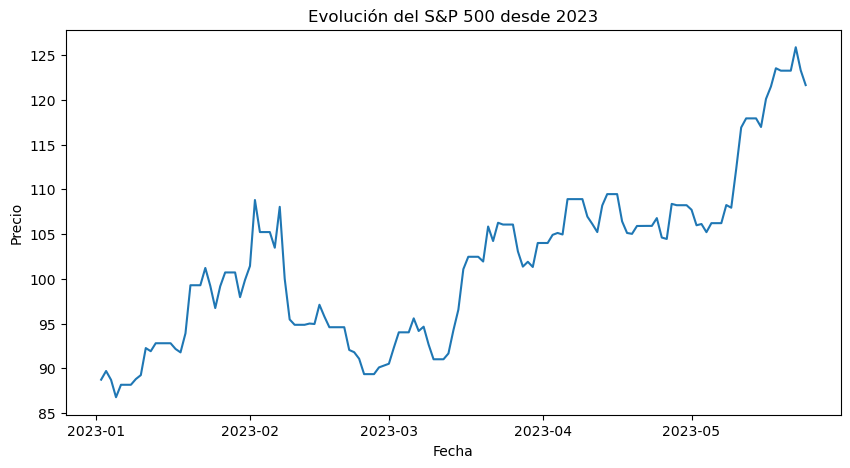

In [4]:

fig, ax = plt.subplots(1, 1, figsize=(10, 5))
_ = sns.lineplot(data=data_df[data_df.index > np.datetime64("2023-01-01")], x='Date', y='GOOG', ax=ax)
ax.set_ylabel("Precio")
ax.set_xlabel("Fecha")
_ = ax.set_title("Evolución del S&P 500 desde 2023")

### Exploratory data analysis

In [5]:
data_df.describe()

,AAPL,AMZN,BRK-A,BRK-B,BZ=F,EURUSD=X,GC=F,GOOG,GOOGL,META,...,TSLA,UNH,^GSPC,^IXIC,^VIX,EFFR,CSUSHPISA,GDP,CPIAUCSL,CPILFESL
count,4024.000000,4024.000000,4024.000000,4024.000000,4024.000000,4024.000000,4024.000000,4024.000000,4024.000000,4024.000000,...,4024.000000,4024.000000,4024.000000,4024.000000,4024.000000,4024.000000,4024.000000,4024.000000,4024.000000,4024.000000
mean,63.347521,71.125440,282487.840706,187.890174,73.510954,1.171132,1467.825124,58.365490,58.530197,149.317910,...,72.554799,229.191799,2712.527573,7506.849391,17.818807,0.887751,205.346441,20254.188944,252.643991,257.562581
std,50.566428,52.974178,101868.254410,67.380615,24.605393,0.095734,266.086532,35.927847,35.425970,86.041397,...,100.417383,146.527981,924.606729,3594.232164,6.980280,1.151665,46.816634,2879.545536,20.066051,20.407438
min,13.947500,10.411000,118850.000000,78.830002,19.330000,0.959619,1050.800049,13.924059,13.990240,17.730000,...,1.740000,51.000000,1278.040039,2747.479980,9.140000,0.040000,140.155000,16207.130000,228.524000,229.224000
25%,25.240000,19.252750,204599.000000,136.330002,53.437499,1.103631,1251.099976,28.501747,28.980501,78.907499,...,13.914167,109.847498,2002.250031,4685.444946,13.150000,0.090000,169.132000,17991.348000,237.336000,240.172000
50%,39.967501,56.769749,271620.000000,181.059998,68.274998,1.140394,1333.649963,50.861000,51.263500,146.389999,...,18.510000,212.454994,2550.784912,6732.770020,15.960000,0.170000,195.955000,19636.731000,247.284000,253.816000
75%,111.134377,102.195000,333461.250000,222.014999,97.919998,1.227687,1734.049988,75.795748,75.788002,193.539993,...,112.797499,308.019989,3349.689941,10553.997559,20.809999,1.550000,222.547000,21704.706000,259.411000,268.469000
max,182.009995,186.570496,539180.000000,359.570007,127.980003,1.393088,2051.500000,150.709000,149.838501,382.179993,...,409.970001,555.150024,4796.560059,16057.440430,82.690002,4.830000,305.152000,26465.865000,302.918000,306.489000


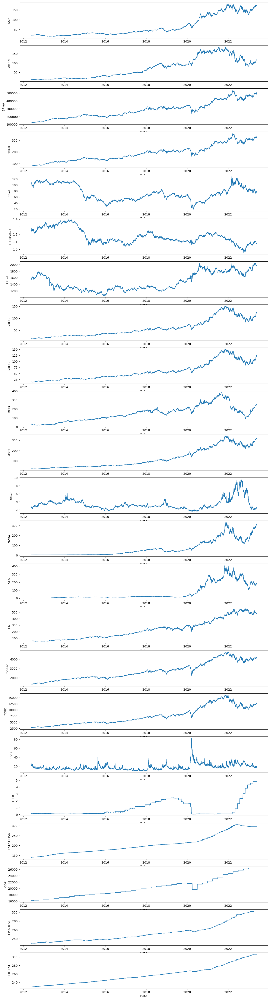

In [6]:
fig, ax = plt.subplots(data_df.columns.shape[0], 1, figsize=(15, 60))
for i,c in enumerate(data_df.columns):
    sns.lineplot(data=data_df, x='Date', y=c, ax=ax[i])

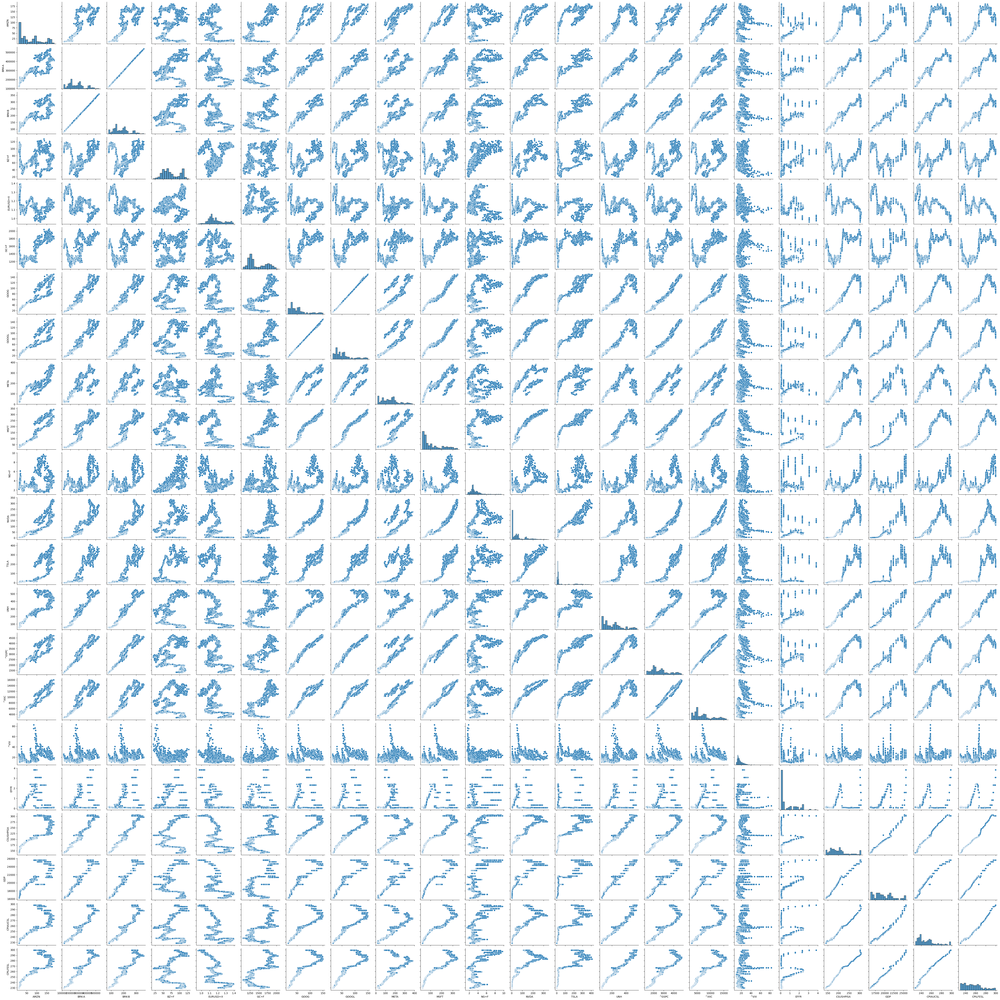

In [288]:
sns.pairplot(data_df)

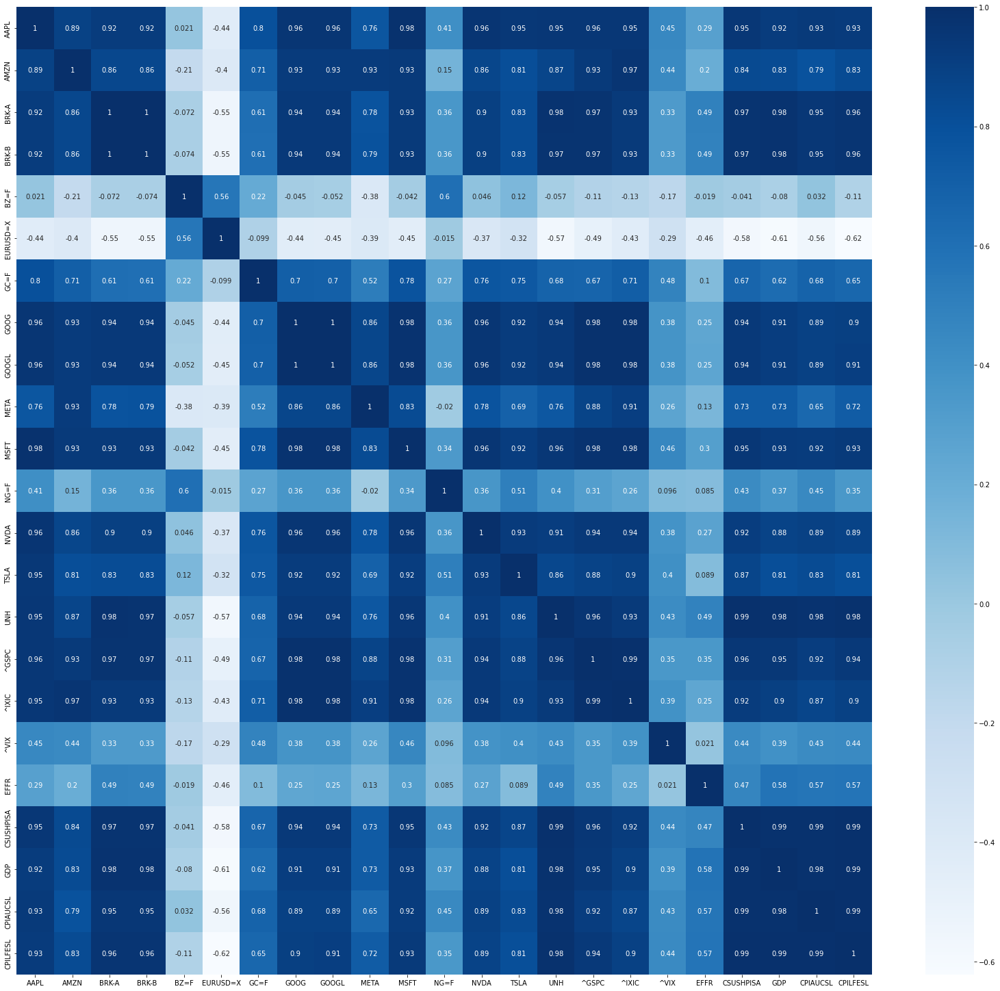

In [13]:
corr_df = data_df.corr(method='pearson')
plt.figure(figsize=(28, 26))
sns.heatmap(corr_df, annot=True, cmap="Blues")
plt.show()

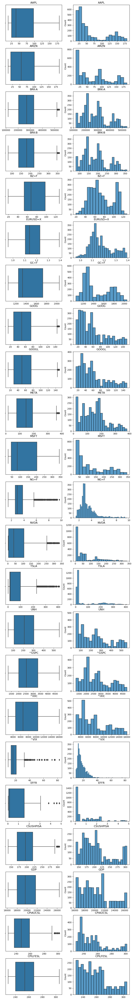

In [39]:
fig, ax = plt.subplots(data_df.columns.shape[0], 2, figsize=(10, 80))
for i,column in enumerate(data_df.columns):
    _ = sns.boxplot(x=data_df[column], ax=ax[i][0])
    _ = sns.histplot(data=data_df, x=column, ax=ax[i][1])
    _ = ax[i][0].set_title(f"{column}")
    _ = ax[i][1].set_title(f"{column}")
    _ = ax[i][0].set_xlabel("")
    _ = ax[i][1].set_xlabel("")

## Feature selection

In [7]:
label = "^GSPC"
predictors = ['AAPL', 'AMZN',  'GOOG',
       'GOOGL', 'META', 'MSFT', 'NVDA', 'TSLA', 'UNH','GC=F', 'EURUSD=X','^IXIC', 'CSUSHPISA', 'GDP', 'CPIAUCSL', 'CPILFESL']

In [8]:
## metrics

def mape_metric(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

def smape_metric(y_true, y_pred):
    return np.mean(np.abs(y_pred - y_true) / ((np.abs(y_true) + np.abs(y_pred)) / 2)) * 100




# Models

* VAR
* prophet
* Vanilla LSTM
* Vanilla Transformer
* Custom LSTM models (state of the art?)
* Custom Transformer models (state of the art?)

### VAR

In [ ]:
# https://towardsdatascience.com/future-price-prediction-beyond-test-data-using-vector-auto-regression-eedb7e0c04e


In [75]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
input_scaler = StandardScaler()
label_scaler = StandardScaler()

# test - train split
df_train = data_df[data_df.index <= (data_df.index[-1] - datetime.timedelta(days=7))]
df_train['y'] = df_train[label]

df_test = data_df[data_df.index > (data_df.index[-1] - datetime.timedelta(days=7))]
df_test['y'] = df_test[label]

df_train_t = df_train[['y'] + predictors].copy()
df_test_t = df_test[['y'] + predictors].copy()

input_scaler.fit(df_train[predictors])
label_scaler.fit(df_train['y'].values.reshape(-1, 1))

df_train[predictors] = input_scaler.transform(df_train[predictors])
df_train['y'] = label_scaler.transform(df_train['y'].values.reshape(-1, 1))
df_train = df_train[['y'] + predictors]

df_test[predictors] = input_scaler.transform(df_test[predictors])
df_test['y'] = label_scaler.transform(df_test['y'].values.reshape(-1, 1))
df_test = df_test[['y'] + predictors]


In [9]:

from statsmodels.tsa.stattools import adfuller

def adfuller_test(series, signif=0.05, name='', verbose=False):
    r = adfuller(series, autolag='AIC')
    output = {'test_statistic':round(r[0], 4), 'pvalue':round(r[1], 4), 'n_lags':round(r[2], 4), 'n_obs':r[3]}
    p_value = output['pvalue']

    def adjust(val, length= 6): 
        return str(val).ljust(length)

    print(f'Augmented Dickey-Fuller Test on "{name}"', "\n   ", '-'*47)
    print(f'Null Hypothesis: Data has unit root. Non-Stationary.')
    print(f'Significance Level = {signif}')
    print(f'Test Statistic = {output["test_statistic"]}')
    print(f'No. Lags Chosen = {output["n_lags"]}')
    for key,val in r[4].items():
        print(f' Critical value {adjust(key)} = {round(val, 3)}')
        if p_value <= signif:
            print(f" => P-Value = {p_value}. Rejecting Null Hypothesis.")
            print(f" => Series is Stationary.")
        else:
            print(f" => P-Value = {p_value}. Weak evidence to reject the   Null Hypothesis.")
            print(f" => Series is Non-Stationary.")

# ADF test on each column
for name, column in df_train.iteritems():
    adfuller_test(column, name = column.name)

Augmented Dickey-Fuller Test on "y" 
    -----------------------------------------------
Null Hypothesis: Data has unit root. Non-Stationary.
Significance Level = 0.05
Test Statistic = -0.8152
No. Lags Chosen = 20
 Critical value 1%     = -3.432
 => P-Value = 0.8146. Weak evidence to reject the   Null Hypothesis.
 => Series is Non-Stationary.
 Critical value 5%     = -2.862
 => P-Value = 0.8146. Weak evidence to reject the   Null Hypothesis.
 => Series is Non-Stationary.
 Critical value 10%    = -2.567
 => P-Value = 0.8146. Weak evidence to reject the   Null Hypothesis.
 => Series is Non-Stationary.
Augmented Dickey-Fuller Test on "AAPL" 
    -----------------------------------------------
Null Hypothesis: Data has unit root. Non-Stationary.
Significance Level = 0.05
Test Statistic = 0.2012
No. Lags Chosen = 25
 Critical value 1%     = -3.432
 => P-Value = 0.9723. Weak evidence to reject the   Null Hypothesis.
 => Series is Non-Stationary.
 Critical value 5%     = -2.862
 => P-Value = 

Glimpse of differenced data:
                   y      AAPL      AMZN      GOOG     GOOGL      META  \
Date                                                                     
2012-05-19  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
2012-05-20  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
2012-05-21  0.022597  0.022156  0.004014  0.009560  0.009741 -0.048823   
2012-05-22  0.000696 -0.003090 -0.002619 -0.009281 -0.009457 -0.035222   
2012-05-23  0.002426  0.009744  0.001837  0.006038  0.006153  0.011624   

                MSFT      NVDA      TSLA       UNH      GC=F  EURUSD=X  \
Date                                                                     
2012-05-19  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
2012-05-20  0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
2012-05-21  0.005233  0.000682  0.000803  0.010743 -0.012181  0.077837   
2012-05-22  0.000109 -0.000487  0.001348  0.001171 -0.046058  0.039261   
2012-05-

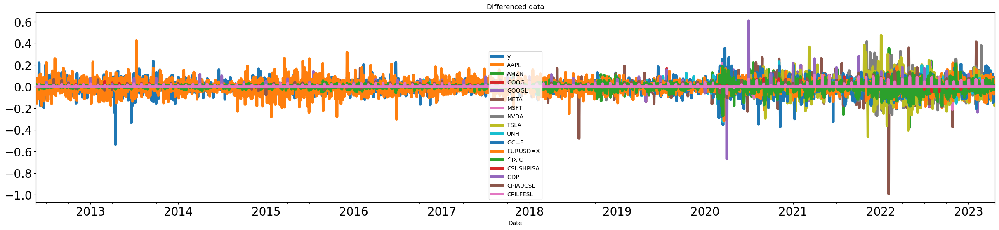

In [52]:
# 1st order difference 
# differenced train data
data_diff = df_train.diff()
data_diff.dropna(inplace=True)
print('Glimpse of differenced data:')
print(data_diff.head())
# plotting differenced data
data_diff.plot(figsize=(30,6), linewidth=5, fontsize=20)
plt.title('Differenced data')
plt.show()


In [53]:
for name, column in data_diff.iteritems():
    adfuller_test(column, name=column.name)

Augmented Dickey-Fuller Test on "y" 
    -----------------------------------------------
Null Hypothesis: Data has unit root. Non-Stationary.
Significance Level = 0.05
Test Statistic = -14.0661
No. Lags Chosen = 19
 Critical value 1%     = -3.432
 => P-Value = 0.0. Rejecting Null Hypothesis.
 => Series is Stationary.
 Critical value 5%     = -2.862
 => P-Value = 0.0. Rejecting Null Hypothesis.
 => Series is Stationary.
 Critical value 10%    = -2.567
 => P-Value = 0.0. Rejecting Null Hypothesis.
 => Series is Stationary.
Augmented Dickey-Fuller Test on "AAPL" 
    -----------------------------------------------
Null Hypothesis: Data has unit root. Non-Stationary.
Significance Level = 0.05
Test Statistic = -11.3668
No. Lags Chosen = 24
 Critical value 1%     = -3.432
 => P-Value = 0.0. Rejecting Null Hypothesis.
 => Series is Stationary.
 Critical value 5%     = -2.862
 => P-Value = 0.0. Rejecting Null Hypothesis.
 => Series is Stationary.
 Critical value 10%    = -2.567
 => P-Value = 0

In [54]:
from statsmodels.tsa.vector_ar.var_model import VAR

order=30

var_model = VAR(data_diff)
res = var_model.select_order(maxlags=order)
print(res.summary())
results = var_model.fit(maxlags=order, ic='aic')
print(results.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -142.0     -141.9*   2.212e-62     -142.0*
1       -142.1      -141.6   1.905e-62      -141.9
2       -142.2      -141.2   1.830e-62      -141.8
3       -142.2      -140.8   1.831e-62      -141.7
4       -142.1      -140.3   1.898e-62      -141.5
5       -142.2      -139.8   1.810e-62      -141.3
6       -142.2      -139.4   1.763e-62      -141.2
7       -142.3      -139.0   1.661e-62      -141.1
8       -142.3      -138.6   1.616e-62      -141.0
9       -142.3      -138.1   1.649e-62      -140.8
10      -142.2      -137.6   1.702e-62      -140.6
11      -142.2      -137.1   1.749e-62      -140.4
12      -142.2      -136.7   1.785e-62      -140.2
13      -142.2      -136.2   1.787e-62      -140.1
14      -142.3      -135.8   1.653e-62      -140.0
15      -142.3      -135.4   1.629e-62      -139.8
16      -142.3      -134.9   1.

In [55]:
# make predictions
pred, lower, upper= results.forecast_interval(data_diff.values[-order:], steps=7, alpha=0.05)
pred = pd.DataFrame(pred, columns = df_train.columns+ '_pred')
lower = pd.DataFrame(lower, columns = df_train.columns+ '_pred')
upper = pd.DataFrame(upper, columns = df_train.columns+ '_pred')
pred

,y_pred,AAPL_pred,AMZN_pred,GOOG_pred,GOOGL_pred,META_pred,MSFT_pred,NVDA_pred,TSLA_pred,UNH_pred,GC=F_pred,EURUSD=X_pred,^IXIC_pred,CSUSHPISA_pred,GDP_pred,CPIAUCSL_pred,CPILFESL_pred
0,0.010435,0.005558,0.010240,0.015686,0.010448,0.009333,0.000503,0.023782,0.027552,0.018155,-0.009019,-0.026544,0.011146,0.009245,0.020451,0.011295,0.006803
1,-0.005592,-0.030384,-0.009777,0.015982,0.019558,0.014673,-0.003202,0.017275,-0.015885,0.000438,-0.022100,0.046134,-0.003521,-0.000221,0.010480,-0.000671,-0.002230
2,0.055861,0.052977,0.028707,0.069550,0.071106,0.055808,0.056954,0.070402,0.003503,0.037609,0.074499,-0.022480,0.054224,-0.003282,0.001076,-0.004102,-0.003525
3,-0.005471,0.005988,-0.006768,0.007967,0.011191,-0.016276,-0.001895,-0.013974,-0.030481,0.013159,-0.000801,0.042206,-0.003307,0.006618,0.009823,0.004094,0.005063
4,0.030791,0.023924,0.019318,0.004398,0.004174,-0.005712,-0.000691,0.013810,0.027923,0.021905,0.029709,-0.005102,0.020961,0.005500,0.003411,0.001693,0.001738
5,0.007665,-0.000751,-0.016770,-0.009691,-0.009213,-0.016259,-0.002097,-0.012545,0.003660,0.004060,0.012725,-0.008184,-0.001223,-0.009191,-0.007664,-0.010160,-0.003979
6,0.014266,0.011161,0.002858,-0.009576,-0.005518,0.001920,0.014870,0.003540,0.007706,0.017250,0.003900,0.017327,0.007748,0.001512,-0.009102,0.008682,0.010796


In [56]:
lower

,y_pred,AAPL_pred,AMZN_pred,GOOG_pred,GOOGL_pred,META_pred,MSFT_pred,NVDA_pred,TSLA_pred,UNH_pred,GC=F_pred,EURUSD=X_pred,^IXIC_pred,CSUSHPISA_pred,GDP_pred,CPIAUCSL_pred,CPILFESL_pred
0,-0.042451,-0.040466,-0.042262,-0.037521,-0.043553,-0.063718,-0.043710,-0.039520,-0.042094,-0.025862,-0.098397,-0.124018,-0.037623,-0.002844,-0.012377,-0.004082,-0.005276
1,-0.058990,-0.076694,-0.062872,-0.037672,-0.034913,-0.058943,-0.047845,-0.046677,-0.085825,-0.043930,-0.111936,-0.054534,-0.052746,-0.012436,-0.022533,-0.016153,-0.014387
2,0.002260,0.006385,-0.024876,0.015617,0.016318,-0.018442,0.012044,0.006030,-0.066938,-0.007118,-0.015513,-0.123493,0.004740,-0.015522,-0.032021,-0.019616,-0.015723
3,-0.059291,-0.040841,-0.060629,-0.046278,-0.043873,-0.091143,-0.047030,-0.078727,-0.101429,-0.031774,-0.091089,-0.059575,-0.053025,-0.005715,-0.023417,-0.011516,-0.007195
4,-0.023243,-0.023154,-0.034919,-0.049990,-0.051041,-0.080861,-0.046086,-0.051176,-0.043440,-0.023126,-0.060879,-0.107097,-0.028977,-0.006940,-0.029881,-0.014030,-0.010599
5,-0.046642,-0.048021,-0.071183,-0.064361,-0.064711,-0.091811,-0.047811,-0.077745,-0.068080,-0.041261,-0.078200,-0.110385,-0.051420,-0.021870,-0.041081,-0.026074,-0.016439
6,-0.040262,-0.036475,-0.051920,-0.064613,-0.061393,-0.073880,-0.031144,-0.062171,-0.065032,-0.028224,-0.087241,-0.085105,-0.042759,-0.011209,-0.042570,-0.007290,-0.001716


In [57]:
upper

,y_pred,AAPL_pred,AMZN_pred,GOOG_pred,GOOGL_pred,META_pred,MSFT_pred,NVDA_pred,TSLA_pred,UNH_pred,GC=F_pred,EURUSD=X_pred,^IXIC_pred,CSUSHPISA_pred,GDP_pred,CPIAUCSL_pred,CPILFESL_pred
0,0.063320,0.051583,0.062743,0.068893,0.064448,0.082384,0.044716,0.087084,0.097199,0.062173,0.080359,0.070930,0.059916,0.021335,0.053279,0.026671,0.018882
1,0.047806,0.015927,0.043318,0.069636,0.074029,0.088290,0.041442,0.081226,0.054055,0.044806,0.067735,0.146801,0.045703,0.011995,0.043492,0.014811,0.009928
2,0.109461,0.099570,0.082291,0.123484,0.125894,0.130059,0.101864,0.134775,0.073945,0.082336,0.164512,0.078533,0.103708,0.008958,0.034173,0.011411,0.008673
3,0.048350,0.052817,0.047094,0.062211,0.066255,0.058592,0.043240,0.050779,0.040468,0.058091,0.089487,0.143987,0.046410,0.018951,0.043063,0.019704,0.017321
4,0.084825,0.071002,0.073555,0.058786,0.059389,0.069437,0.044703,0.078797,0.099285,0.066936,0.120298,0.096893,0.070899,0.017940,0.036702,0.017416,0.014074
5,0.061971,0.046518,0.037644,0.044979,0.046286,0.059294,0.043617,0.052654,0.075401,0.049380,0.103649,0.094017,0.048973,0.003488,0.025754,0.005755,0.008480
6,0.068794,0.058796,0.057635,0.045461,0.050356,0.077720,0.060885,0.069250,0.080443,0.062724,0.095041,0.119759,0.058255,0.014233,0.024365,0.024654,0.023308


In [59]:
def invert_transformation(data_diff, pred):
    forecast = pred.copy()
    columns = df_train.columns
    for col in columns:
        forecast[str(col)+'_pred'] = df_train[col].iloc[-1] +   forecast[str(col) +'_pred'].cumsum()
    return forecast

output = invert_transformation(data_diff, pred)
output['y_pred'] = label_scaler.inverse_transform(output['y_pred'].values.reshape(-1, 1))
output[output.drop(columns = ['y_pred']).columns] = input_scaler.inverse_transform(output.drop(columns = ['y_pred']))
output.index = df_test.index

output_lower = invert_transformation(data_diff, lower)
output_lower['y_pred'] = label_scaler.inverse_transform(output_lower['y_pred'].values.reshape(-1, 1))
output_lower[output_lower.drop(columns = ['y_pred']).columns] = input_scaler.inverse_transform(output_lower.drop(columns = ['y_pred']))
output_lower.index = df_test.index

output_upper = invert_transformation(data_diff, upper)
output_upper['y_pred'] = label_scaler.inverse_transform(output_upper['y_pred'].values.reshape(-1, 1))
output_upper[output_upper.drop(columns = ['y_pred']).columns] = input_scaler.inverse_transform(output_upper.drop(columns = ['y_pred']))
output_upper.index = df_test.index

In [79]:
## metrics

for col in df_test.columns:
    print(col, ":")
    
    mae = mean_absolute_error(df_test_t[col], output[col + '_pred'])
    mse = mean_squared_error(df_test_t[col], output[col + '_pred'])
    rmse = mean_squared_error(df_test_t[col], output[col + '_pred'], squared=False)

    mape = mape_metric(df_test_t[col], output[col + '_pred'])
    smape = smape_metric(df_test_t[col], output[col + '_pred'])

    print("MAPE:", mape)
    print("SMAPE:", smape)
    print(f"MAE: {mae}")
    print(f"MSE: {mse}")
    print(f"RMSE: {rmse}")
    print("\n")


# Total
print('Total')
mae = mean_absolute_error(df_test_t.values, output.values)
mse = mean_squared_error(df_test_t.values, output.values)
rmse = mean_squared_error(df_test_t.values, output.values, squared=False)

mape = mape_metric(df_test_t.values, output.values)
smape = smape_metric(df_test_t.values, output.values)

print("MAPE:", mape)
print("SMAPE:", smape)
print(f"MAE: {mae}")
print(f"MSE: {mse}")
print(f"RMSE: {rmse}")
print("\n")

y :
MAPE: 1.6837669001183493
SMAPE: 1.6621785487958733
MAE: 69.01622080784416
MSE: 7309.13027547093
RMSE: 85.49345165257354


AAPL :
MAPE: 0.9955728101339265
SMAPE: 0.9892730815811964
MAE: 1.641846252117111
MSE: 4.370335082389717
RMSE: 2.0905346403228333


AMZN :
MAPE: 2.3370270494066125
SMAPE: 2.2975443359291376
MAE: 2.4515597322451788
MSE: 9.36667495891619
RMSE: 3.0605024030240835


GOOG :
MAPE: 2.3648985086698984
SMAPE: 2.320960815873574
MAE: 2.494896847731025
MSE: 9.899749024687996
RMSE: 3.1463866616625484


GOOGL :
MAPE: 2.5879256453521844
SMAPE: 2.5368518181458946
MAE: 2.71364764106359
MSE: 11.376603588836128
RMSE: 3.372922114255846


META :
MAPE: 4.712610119805975
SMAPE: 4.8112407871604335
MAE: 10.698229847599022
MSE: 184.45242328789433
RMSE: 13.581326271314387


MSFT :
MAPE: 2.8957205332380216
SMAPE: 2.9050280877125556
MAE: 8.483733927839069
MSE: 112.49085315035185
RMSE: 10.6061705224059


NVDA :
MAPE: 2.606821872839519
SMAPE: 2.556157799485348
MAE: 6.987769302248799
MSE: 73.54

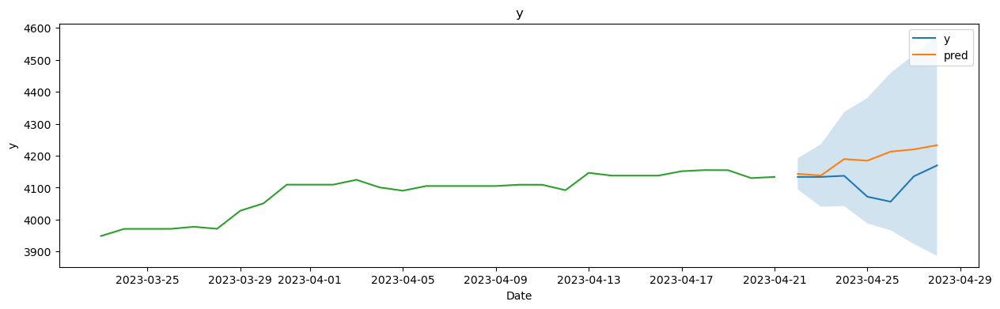

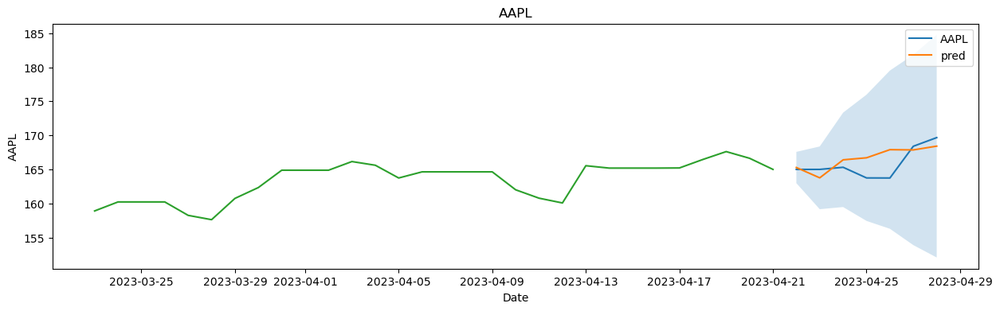

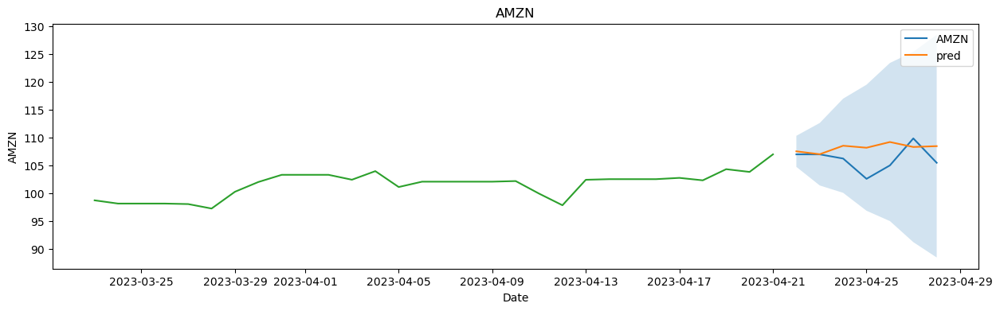

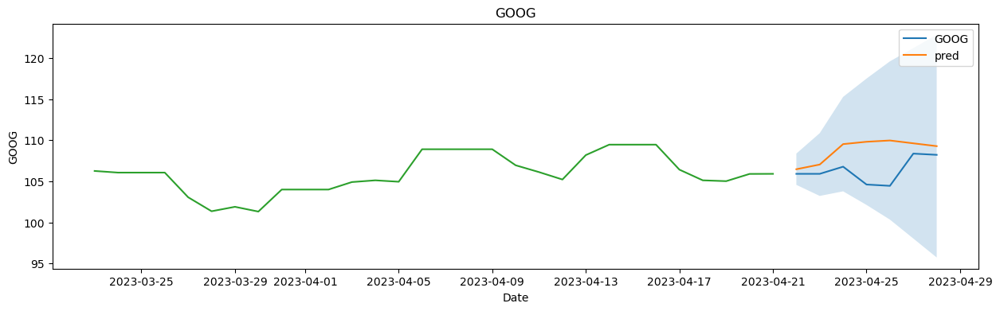

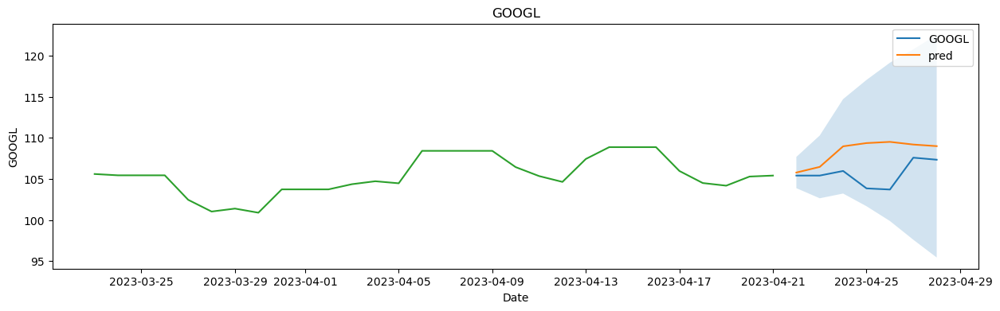

...

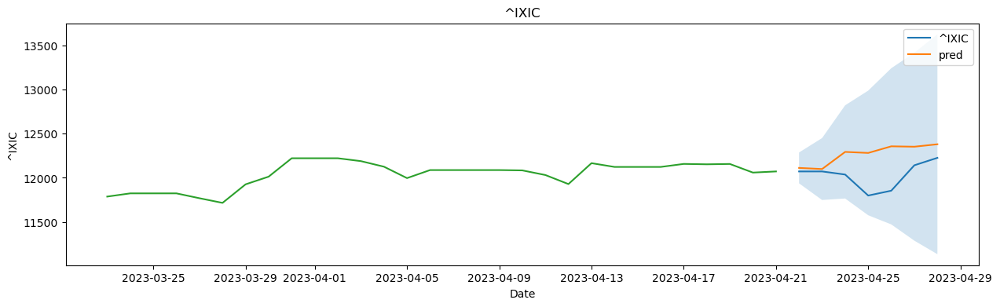

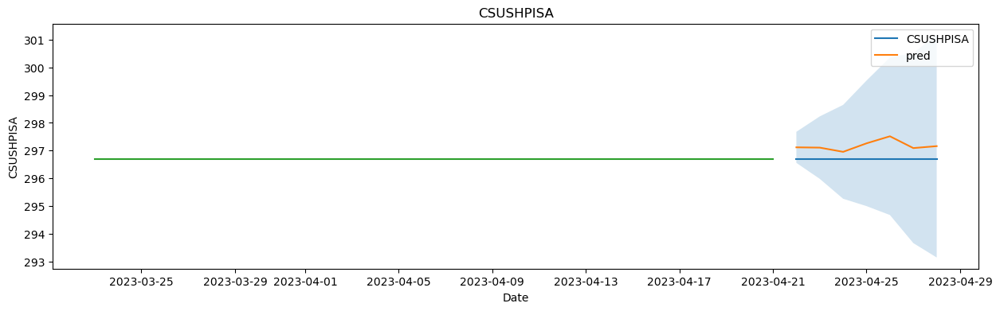

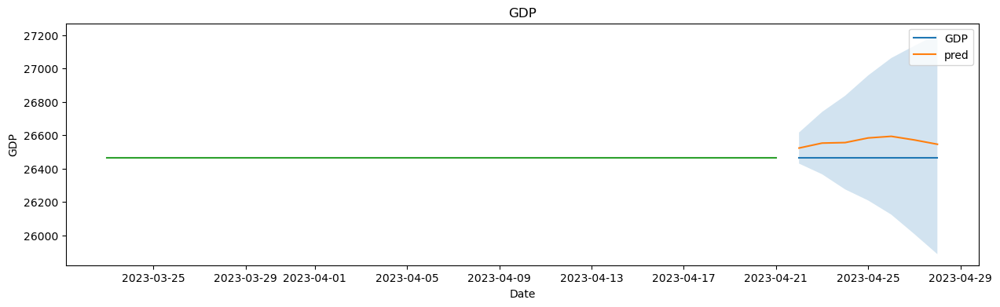

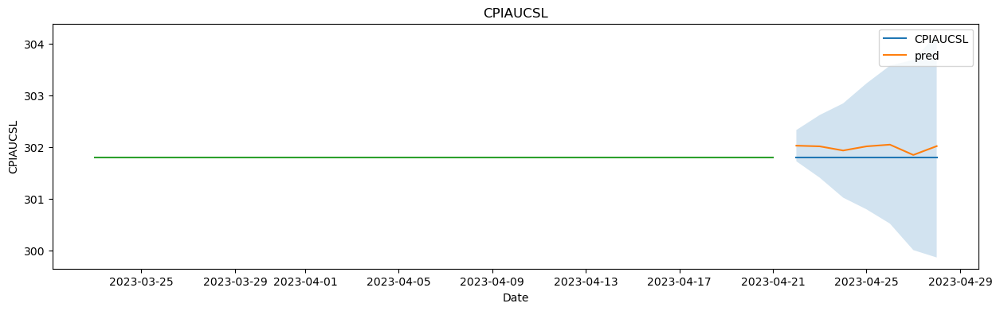

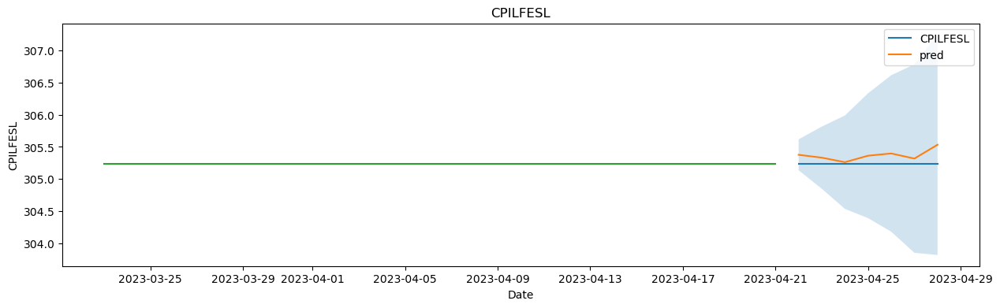

In [82]:
for col in df_test.columns:
    fig, ax = plt.subplots(1, 1, figsize=(15, 4))
    sns.lineplot(data=df_test_t,x=df_test_t.index, y=col, ax=ax, label=col)
    sns.lineplot(data=output, x=df_test_t.index, y=col+'_pred', ax=ax, label='pred')
    sns.lineplot(data=df_train_t.iloc[-order:], x=df_train_t.iloc[-order:].index, y=col, ax=ax)
    ax.fill_between(df_test_t.index, output_lower[col + "_pred"], output_upper[col + "_pred"], alpha=0.2)
    _ = ax.set_title(col)

### prophet facebook 

In [84]:
## Univariate

from prophet import Prophet
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
label_scaler = StandardScaler()

# test - train split

df_train = data_df[data_df.index <= (data_df.index[-1] - datetime.timedelta(days=7))]

df_train = df_train.reset_index().rename(columns={'Date': 'ds'})
df_train['y'] = df_train[label]

df_test = data_df[data_df.index > (data_df.index[-1] - datetime.timedelta(days=7))]
df_test = df_test.reset_index().rename(columns={'Date': 'ds'})
df_test['y'] = df_test[label]

df_train_t = df_train[["ds", 'y']].copy()
df_test_t = df_test[["ds", 'y']].copy()


label_scaler.fit(df_train['y'].values.reshape(-1, 1))

df_train['y'] = label_scaler.transform(df_train['y'].values.reshape(-1, 1))
df_train = df_train[["ds", 'y']]

df_test['y'] = label_scaler.transform(df_test['y'].values.reshape(-1, 1))
df_test = df_test[["ds", 'y']]

In [87]:
from prophet import Prophet

m = Prophet()

m.fit(df_train)

04:37:54 - cmdstanpy - INFO - Chain [1] start processing
04:37:54 - cmdstanpy - INFO - Chain [1] done processing


In [92]:
forecast = m.predict(df_test.drop(columns=['y']))
forecast['yhat'] = label_scaler.inverse_transform(forecast['yhat'].values.reshape(-1,1))
forecast['yhat_lower'] = label_scaler.inverse_transform(forecast['yhat_lower'].values.reshape(-1,1))
forecast['yhat_upper'] = label_scaler.inverse_transform(forecast['yhat_upper'].values.reshape(-1,1))

forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]


,ds,yhat,yhat_lower,yhat_upper
0,2023-04-22,4080.170416,3883.454064,4263.331507
1,2023-04-23,4078.329898,3870.054767,4265.278855
2,2023-04-24,4076.169351,3883.909113,4263.505020
3,2023-04-25,4075.436572,3856.996154,4266.618662
4,2023-04-26,4074.434839,3867.680727,4272.355755
5,2023-04-27,4071.771249,3873.109767,4273.874909
6,2023-04-28,4069.844927,3878.057474,4271.616941


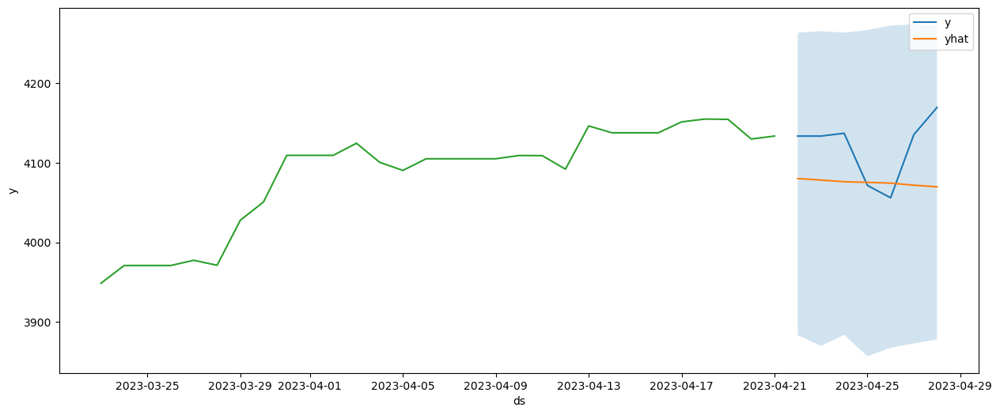

In [93]:
fig, ax = plt.subplots(1, 1, figsize=(15, 6))
sns.lineplot(data=df_test_t, x='ds', y='y', ax=ax, label='y')
sns.lineplot(data=forecast, x='ds', y='yhat', ax=ax, label='yhat')
sns.lineplot(data=df_train_t.iloc[-30:], x='ds', y='y', ax=ax)
ax.fill_between(forecast['ds'], forecast['yhat_lower'], forecast['yhat_upper'], alpha=0.2)

In [94]:

mae = mean_absolute_error(df_test_t['y'], forecast['yhat'])
mse = mean_squared_error(df_test_t['y'], forecast['yhat'])
rmse = mean_squared_error(df_test_t['y'], forecast['yhat'], squared=False)

mape = mape_metric(df_test_t['y'], forecast['yhat'])
smape = smape_metric(df_test_t['y'], forecast['yhat'])

print("MAPE:", mape)
print("SMAPE:", smape)
print(f"MAE: {mae}")
print(f"MSE: {mse}")
print(f"RMSE: {rmse}")

MAPE: 1.2246464737261533
SMAPE: 1.2343597719369774
MAE: 50.69655038617923
MSE: 3417.3553497864314
RMSE: 58.458150413662864


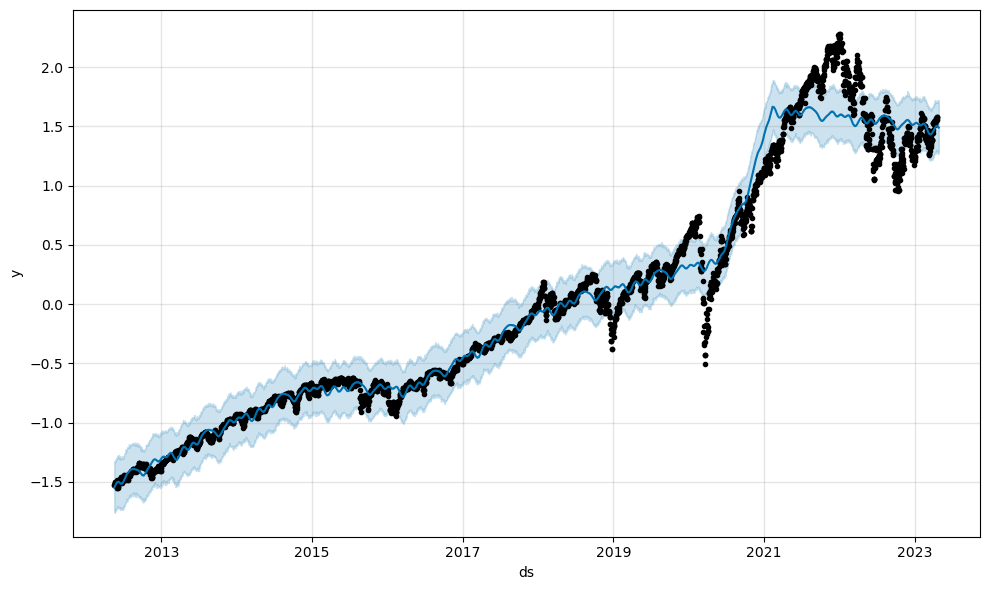

In [95]:
forecast = m.predict(data_df.reset_index().rename(columns={'Date': 'ds'})[['ds']])
fig1 = m.plot(forecast)

In [96]:
### Multivariate

from prophet import Prophet
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
input_scaler = StandardScaler()
label_scaler = StandardScaler()

# test - train split
df_train = data_df[data_df.index <= (data_df.index[-1] - datetime.timedelta(days=7))]

df_train = df_train.reset_index().rename(columns={'Date': 'ds'})
df_train['y'] = df_train[label]

df_test = data_df[data_df.index > (data_df.index[-1] - datetime.timedelta(days=7))]
df_test = df_test.reset_index().rename(columns={'Date': 'ds'})
df_test['y'] = df_test[label]

df_train_t = df_train[["ds", 'y'] + predictors].copy()
df_test_t = df_test[["ds", 'y'] + predictors].copy()


input_scaler.fit(df_train[predictors])
label_scaler.fit(df_train['y'].values.reshape(-1, 1))

df_train[predictors] = input_scaler.transform(df_train[predictors])
df_train['y'] = label_scaler.transform(df_train['y'].values.reshape(-1, 1))
df_train = df_train[["ds", 'y'] + predictors]


df_test[predictors] = input_scaler.transform(df_test[predictors])
df_test['y'] = label_scaler.transform(df_test['y'].values.reshape(-1, 1))
df_test = df_test[["ds", 'y'] + predictors]


<Axes: xlabel='ds', ylabel='y'>

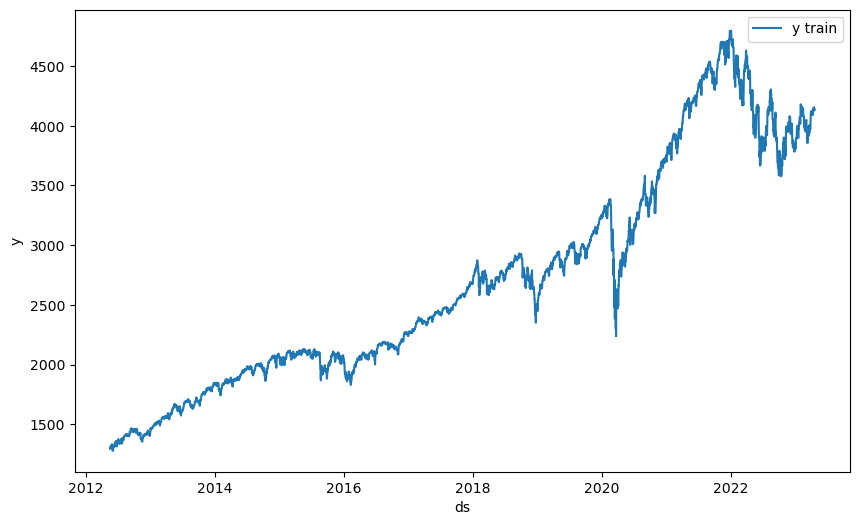

In [98]:
fig, ax = plt.subplots(1, 1, figsize=(10, 6))
sns.lineplot(data=df_train_t, x='ds', y='y', ax=ax, label='y train')

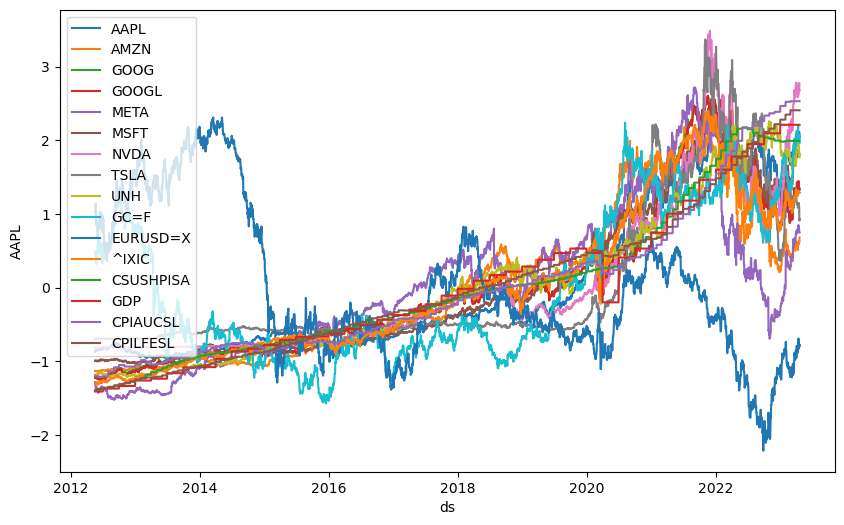

In [99]:
fig, ax = plt.subplots(1, 1, figsize=(10, 6))
for i,c in enumerate(df_train.loc[:, (df_train.columns != 'ds') & (df_train.columns != 'y')].columns):
    sns.lineplot(data=df_train, x='ds', y=c, ax=ax, label=c)

In [100]:

# Initialize Prophet
model = Prophet()

# Add variables
for predictor in predictors:
    print("Add regressor: " + predictor)
    model.add_regressor(predictor, standardize=False)

# Fit the model
model.fit(df_train)


04:43:31 - cmdstanpy - INFO - Chain [1] start processing


Add regressor: AAPL
Add regressor: AMZN
Add regressor: GOOG
Add regressor: GOOGL
Add regressor: META
Add regressor: MSFT
Add regressor: NVDA
Add regressor: TSLA
Add regressor: UNH
Add regressor: GC=F
Add regressor: EURUSD=X
Add regressor: ^IXIC
Add regressor: CSUSHPISA
Add regressor: GDP
Add regressor: CPIAUCSL
Add regressor: CPILFESL


04:43:35 - cmdstanpy - INFO - Chain [1] done processing


In [105]:
# Make predictions
future = df_test.drop(columns=['y'])
for i in future.columns:
    if i != 'ds':
        future[i] = df_train.iloc[-1, :][i] # last know value in train

# print(future)
forecast = model.predict(future)

# Visualize the results
#model.plot(forecast)
forecast['yhat'] = label_scaler.inverse_transform(forecast['yhat'].values.reshape(-1,1))
forecast['yhat_lower'] = label_scaler.inverse_transform(forecast['yhat_lower'].values.reshape(-1,1))
forecast['yhat_upper'] = label_scaler.inverse_transform(forecast['yhat_upper'].values.reshape(-1,1))
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]


,ds,yhat,yhat_lower,yhat_upper
0,2023-04-22,4123.416406,4093.846336,4155.758309
1,2023-04-23,4123.696077,4091.579700,4153.946933
2,2023-04-24,4122.724840,4091.249975,4152.864318
3,2023-04-25,4121.877797,4089.552700,4154.480224
4,2023-04-26,4121.284463,4090.969963,4154.381224
5,2023-04-27,4120.852648,4088.403239,4153.094956
6,2023-04-28,4120.848685,4089.476506,4153.837214


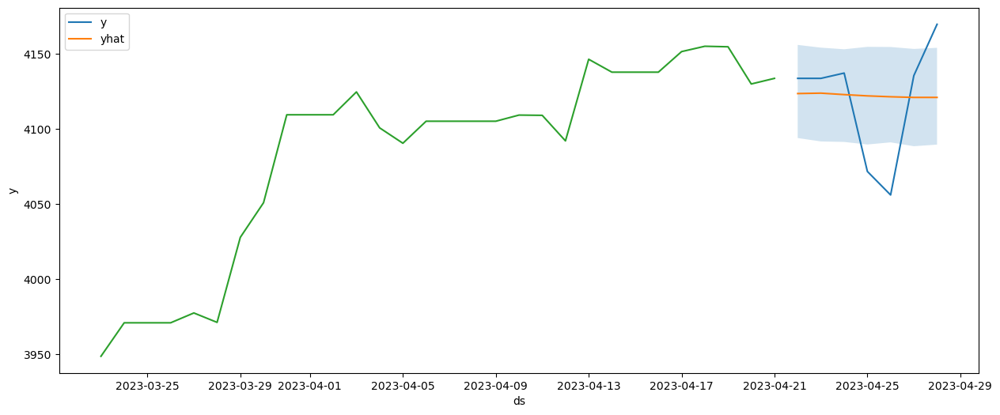

In [106]:
fig, ax = plt.subplots(1, 1, figsize=(15, 6))
sns.lineplot(data=df_test_t, x='ds', y='y', ax=ax, label='y')
sns.lineplot(data=forecast, x='ds', y='yhat', ax=ax, label='yhat')
sns.lineplot(data=df_train_t.iloc[-30:], x='ds', y='y', ax=ax)
ax.fill_between(forecast['ds'], forecast['yhat_lower'], forecast['yhat_upper'], alpha=0.2)


In [107]:
from sklearn.metrics import mean_absolute_error, mean_squared_error

mae = mean_absolute_error(df_test_t['y'], forecast['yhat'])
mse = mean_squared_error(df_test_t['y'], forecast['yhat'])
rmse = mean_squared_error(df_test_t['y'], forecast['yhat'], squared=False)

mape = mape_metric(df_test_t['y'], forecast['yhat'])
smape = smape_metric(df_test_t['y'], forecast['yhat'])

print("MAPE:", mape)
print("SMAPE:", smape)
print(f"MAE: {mae}")
print(f"MSE: {mse}")
print(f"RMSE: {rmse}")

MAPE: 0.7412836388618192
SMAPE: 0.7396002832082668
MAE: 30.416269666909233
MSE: 1395.2739810137105
RMSE: 37.353366394659936


### Vanilla LSTM

In [110]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
input_scaler = StandardScaler()
label_scaler = StandardScaler()

# test - train split
df_train = data_df[data_df.index <= (data_df.index[-1] - datetime.timedelta(days=7))]
df_train['y'] = df_train[label]

df_test = data_df[data_df.index > (data_df.index[-1] - datetime.timedelta(days=7))]
df_test['y'] = df_test[label]

df_train_t = df_train[['y'] + predictors].copy()
df_test_t = df_test[['y'] + predictors].copy()

input_scaler.fit(df_train[predictors])
label_scaler.fit(df_train['y'].values.reshape(-1, 1))

df_train[predictors] = input_scaler.transform(df_train[predictors])
df_train['y'] = label_scaler.transform(df_train['y'].values.reshape(-1, 1))
df_train = df_train[['y'] + predictors]

df_test[predictors] = input_scaler.transform(df_test[predictors])
df_test['y'] = label_scaler.transform(df_test['y'].values.reshape(-1, 1))
df_test = df_test[['y'] + predictors]


# validation
df_val = df_train.iloc[-60:,:]
df_train = df_train.iloc[ :-60,:]

In [111]:
import yaml
import argparse
import numpy as np
import pandas as pd
from pathlib import Path
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader


# with open("model/params.yaml", "r") as params_file:
#     params = yaml.safe_load(params_file)

# model_dir = params['model_dir']


class TimeSeriesDataset(Dataset):   
    def __init__(self, X, y, seq_len=1):
        self.X = X
        self.y = y
        self.seq_len = seq_len

    def __len__(self):
        return self.X.__len__() - self.seq_len

    def __getitem__(self, index):
        return self.X[index:index+self.seq_len], self.y[index+self.seq_len]


class TSModel(nn.Module):
    def __init__(self, n_features, n_hidden=64, n_layers=1):
        super(TSModel, self).__init__()

        self.n_hidden = n_hidden
        self.lstm = nn.LSTM(
            input_size=n_features,
            hidden_size=n_hidden,
            batch_first=True,
            num_layers=n_layers,
            dropout=0.5
        )
        self.linear = nn.Linear(n_hidden, 1)
        
    def forward(self, x):
        _, (hidden, _) = self.lstm(x)
        lstm_out = hidden[-1]  # output last hidden state output
        y_pred = self.linear(lstm_out)
        
        return y_pred
    

def train_model(
        train_df,
        test_df,
        label_name,
        sequence_length,
        batch_size,
        n_epochs,
        n_epochs_stop
):
    """Train LSTM model."""
    print("Starting with model training...")

    # create dataloaders
    train_dataset = TimeSeriesDataset(np.array(train_df), np.array(train_df[label_name]), seq_len=sequence_length)
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=False)

    test_dataset = TimeSeriesDataset(np.array(test_df), np.array(test_df[label_name]), seq_len=sequence_length)
    test_loader = DataLoader(test_dataset, batch_size=60, shuffle=False)

    # set up training
    n_features = train_df.shape[1]
    model = TSModel(n_features)
    criterion = torch.nn.MSELoss()  # L1Loss()
    optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

    train_hist = []
    test_hist = []

    # start training
    best_loss = np.inf
    epochs_no_improve = 0
    for epoch in range(1, n_epochs+1):
        running_loss = 0
        model.train()

        for batch_idx, (data, target) in enumerate(train_loader, 1):
            # zero the parameter gradients
            optimizer.zero_grad()

            # forward + backward + optimize
            data = torch.Tensor(np.array(data))
            output = model(data)
            loss = criterion(output.flatten(), target.type_as(output))
            # if type(criterion) == torch.nn.modules.loss.MSELoss:
            #     loss = torch.sqrt(loss)  # RMSE
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
        running_loss /= len(train_loader)
        train_hist.append(running_loss)

        # test loss
        model.eval()
        test_loss = 0
        with torch.no_grad():
            for data, target in test_loader:
                data = torch.Tensor(np.array(data))
                output = model(data)
                loss = criterion(output.flatten(), target.type_as(output))
                test_loss += loss.item()
            test_loss /= len(test_loader)
            test_hist.append(test_loss)

            # early stopping
            if test_loss < best_loss:
                best_loss = test_loss
#                 torch.save(model.state_dict(), Path(model_dir, 'model.pt'))
                epochs_no_improve = 0
            else:
                epochs_no_improve += 1
            if epochs_no_improve == n_epochs_stop:
                print("Early stopping.")
                break

        print(f'Epoch {epoch} train loss: {round(running_loss,4)} test loss: {round(test_loss,4)}')

        hist = pd.DataFrame()
        hist['training_loss'] = train_hist
        hist['test_loss'] = test_hist

    print("Completed.")

    return hist, model





In [121]:
sequence_length = 30
batch_size = 32
n_epochs = 20
n_epochs_stop = 5
label_name = 'y'

hist, model = train_model(df_train, df_val, label_name, sequence_length, batch_size, n_epochs, n_epochs_stop)


Starting with model training...
Epoch 1 train loss: 0.2177 test loss: 0.1388
Epoch 2 train loss: 0.0893 test loss: 0.0067
Epoch 3 train loss: 0.0415 test loss: 0.0032
Epoch 4 train loss: 0.0339 test loss: 0.0096
Epoch 5 train loss: 0.0315 test loss: 0.0059
Epoch 6 train loss: 0.0293 test loss: 0.0442
Epoch 7 train loss: 0.0225 test loss: 0.0077
Early stopping.
Completed.


In [123]:
model

TSModel(
  (lstm): LSTM(17, 64, batch_first=True, dropout=0.5)
  (linear): Linear(in_features=64, out_features=1, bias=True)
)

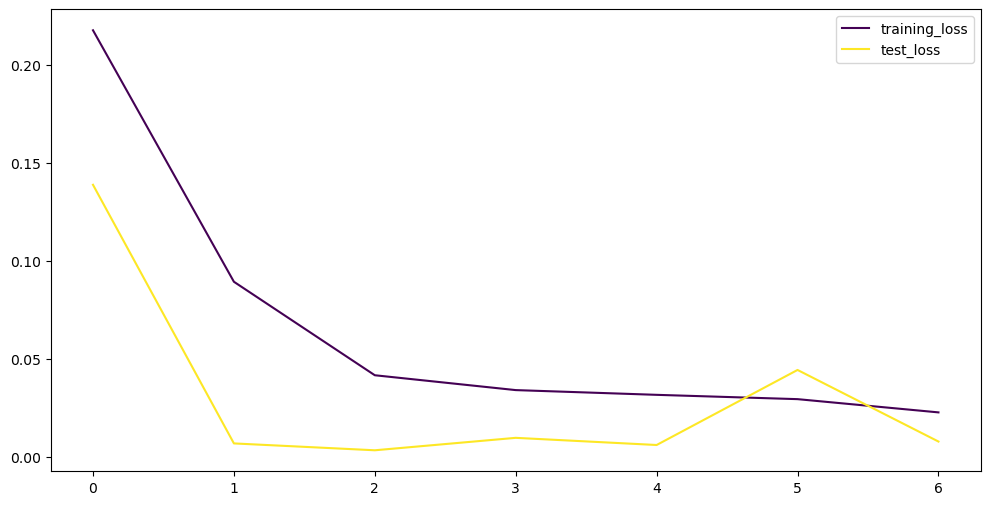

In [122]:
hist.plot(figsize=(12,6), cmap='viridis')
plt.show()

In [126]:
model.eval()

test_dataset = TimeSeriesDataset(np.array(df_val), np.array(df_val[label_name]), seq_len=sequence_length)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

predictions = []
labels = []
with torch.no_grad():
    for features, target in test_loader:
        features = torch.Tensor(np.array(features))
        output = model(features)
        predictions.append(output.item())
        labels.append(target.item())

labels = np.array(labels)
predictions = np.array(predictions)

(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)
(1, 30, 17)


In [125]:
mae = mean_absolute_error(labels, predictions)
mse = mean_squared_error(labels, predictions)
rmse = mean_squared_error(labels, predictions, squared=False)

mape = mape_metric(labels, predictions)
smape = smape_metric(labels, predictions)

print("MAPE:", mape)
print("SMAPE:", smape)
print(f"MAE: {mae}")
print(f"MSE: {mse}")
print(f"RMSE: {rmse}")


MAPE: 3.817904460559714
SMAPE: 3.861821289670565
MAE: 0.05759737009756875
MSE: 0.003711716524088677
RMSE: 0.060923858414324655


## Deep learning models

models:
Multivariate Time Series Forecasting 


In [9]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
ts_scaler = StandardScaler()

# test - train split
# df_train = data_df[data_df.index <= (data_df.index[-1] - datetime.timedelta(days=10))]
df_train = data_df.copy()
df_train = df_train.reset_index().rename(columns={'Date': 'date'})
df_train['y'] = df_train[label]

df_train_t = df_train[['date', 'y'] + predictors].copy()

ts_scaler.fit(df_train[['y'] + predictors])

df_train[['y'] + predictors] = ts_scaler.transform(df_train[['y'] + predictors])
df_train = df_train[["date", 'y'] + predictors]


train_series = df_train.melt(id_vars=['date'], var_name='series', value_name='value')

train_series[['series']] = train_series[['series']].astype(str)
train_series['value'] = pd.to_numeric(train_series['value'], downcast='float')

print(train_series.dtypes)

min_date = train_series['date'].min()
train_series["time_idx"] = train_series["date"].map(lambda current_date: (current_date - min_date).days)

print(train_series["time_idx"].min())
print(train_series["time_idx"].max())

print(train_series.shape)
# print(len(train_series['series'].unique()))
train_series.head()


date      datetime64[ns]
series            object
value            float32
dtype: object
0
4023
(68408, 4)


,date,series,value,time_idx
0,2012-05-18,y,-1.533067,0
1,2012-05-19,y,-1.533067,1
2,2012-05-20,y,-1.533067,2
3,2012-05-21,y,-1.510600,3
4,2012-05-22,y,-1.509908,4


###  DeepVAR 

In [10]:
import lightning.pytorch as pl
from lightning.pytorch.callbacks import EarlyStopping
import matplotlib.pyplot as plt
import pandas as pd
import torch

from pytorch_forecasting import Baseline, DeepAR, TimeSeriesDataSet
from pytorch_forecasting.data import NaNLabelEncoder
from pytorch_forecasting.data.examples import generate_ar_data
from pytorch_forecasting.metrics import MAE, SMAPE, MultivariateNormalDistributionLoss

In [11]:
# create dataset and dataloaders


max_prediction_length = 10
max_encoder_length = 30


training_cutoff = train_series["time_idx"].max() - max_prediction_length

context_length = max_encoder_length
prediction_length = max_prediction_length

training = TimeSeriesDataSet(
    train_series[lambda x: x.time_idx <= training_cutoff],
    time_idx="time_idx",
    target="value",
    categorical_encoders={"series": NaNLabelEncoder().fit(train_series.series)},
    group_ids=["series"],
    static_categoricals=[
        "series"
    ],  # as we plan to forecast correlations, it is important to use series characteristics (e.g. a series identifier)
    time_varying_unknown_reals=["value"],
    max_encoder_length=context_length,
    max_prediction_length=prediction_length,
)



# for validation
validation = TimeSeriesDataSet.from_dataset(training, train_series, min_prediction_idx=training_cutoff + 1)

batch_size = 128
# synchronize samples in each batch over time - only necessary for DeepVAR, not for DeepAR
train_dataloader = training.to_dataloader(
    train=True, batch_size=batch_size, num_workers=0, batch_sampler="synchronized"
)
val_dataloader = validation.to_dataloader(
    train=False, batch_size=batch_size, num_workers=0, batch_sampler="synchronized"
)


In [13]:
# calculate baseline absolute error
baseline_predictions = Baseline().predict(val_dataloader, trainer_kwargs=dict(accelerator="cpu"), return_y=True)
SMAPE()(baseline_predictions.output, baseline_predictions.y)

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


tensor(0.0559)

In [14]:

early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1e-4, patience=10, verbose=False, mode="min")
trainer = pl.Trainer(
    max_epochs=100,
    accelerator="gpu",
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[early_stop_callback],
    limit_train_batches=50,
    enable_checkpointing=True,
)


net = DeepAR.from_dataset(
    training,
    learning_rate=0.006431956578942552,
    log_interval=10,
    log_val_interval=1,
    hidden_size=38,
    rnn_layers=1,
    optimizer="Adam",
    loss=MultivariateNormalDistributionLoss(rank=14),
)

trainer.fit(
    net,
    train_dataloaders=train_dataloader,
    val_dataloaders=val_dataloader,
)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 3060') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name                   | Type                               | Params
------------------------------------------------------------------------------
0 | loss                   | MultivariateNormalDistributionLoss | 0     
1 | logging_metrics        | ModuleList                         | 0     
2 | embeddings             | MultiEmbedding                     | 136   
3 | rnn                    | LSTM                               | 7.4 

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [15]:
trainer.checkpoint_callback.best_model_path

'/home/freddy/MIAD_project/MIAD_P/MIAD_proyecto_grado/lightning_logs/version_354/checkpoints/epoch=50-step=2550.ckpt'

In [16]:
best_model_path = trainer.checkpoint_callback.best_model_path
best_model = DeepAR.load_from_checkpoint(best_model_path)

predictions = best_model.predict(val_dataloader, trainer_kwargs=dict(accelerator="cpu"), return_y=True)
MAE()(predictions.output, predictions.y)

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


tensor(0.0684)

In [35]:
 
loaded_model_in_cpu = DeepAR.load_from_checkpoint(checkpoint_path=best_model_path, map_location=torch.device('cpu'))
torch.save(loaded_model_in_cpu, 'model_v2')

In [38]:

predictions = torch.load('model_v2').predict(val_dataloader, trainer_kwargs=dict(accelerator="cpu"), return_y=True)
MAE()(predictions.output, predictions.y)

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


tensor(0.0484)

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


y :
MAPE: 1.4233704610773545
SMAPE: 1.4369160630856188
MAE: 59.520584247435636
MSE: 4702.863997386552
RMSE: 68.57743067064085


AAPL :
MAPE: 1.0616758907877821
SMAPE: 1.065301039369762
MAE: 1.8468181444039344
MSE: 4.68947067723997
RMSE: 2.1655185700519795


AMZN :
MAPE: 1.3342752224634566
SMAPE: 1.318076488803005
MAE: 1.5178824833905793
MSE: 4.850644663701796
RMSE: 2.2024179130450685


GOOG :
MAPE: 6.537686746799086
SMAPE: 6.806354195938481
MAE: 8.046847585308196
MSE: 80.73883186831428
RMSE: 8.98547894484842


GOOGL :
MAPE: 6.7100229756198475
SMAPE: 6.997848336586474
MAE: 8.217977686823636
MSE: 84.94303811452984
RMSE: 9.21645474759844


META :
MAPE: 3.6031808173321975
SMAPE: 3.535660150497715
MAE: 8.80021825678549
MSE: 81.80720036815354
RMSE: 9.044733294473284


MSFT :
MAPE: 1.2520329636496241
SMAPE: 1.2380443956678995
MAE: 3.9332560127709884
MSE: 28.091054326440183
RMSE: 5.300099463825201


NVDA :
MAPE: 2.4124327077024854
SMAPE: 2.363276537427923
MAE: 7.210745293427976
MSE: 92.2345412

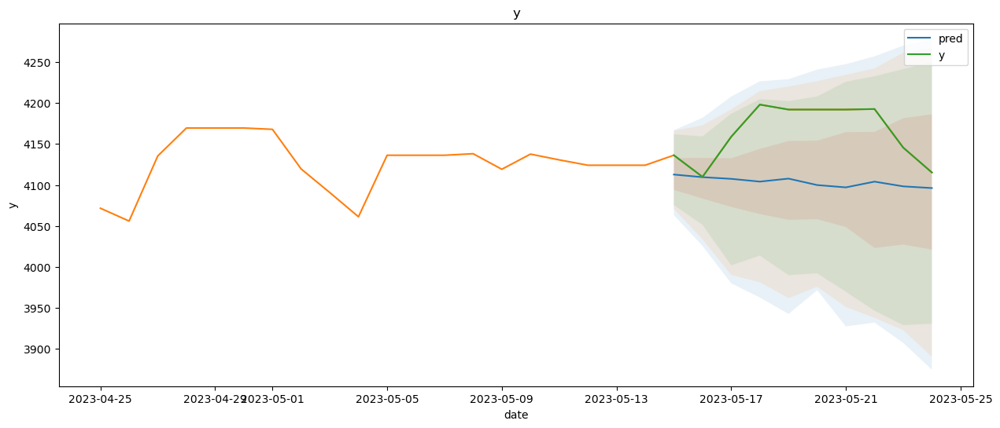

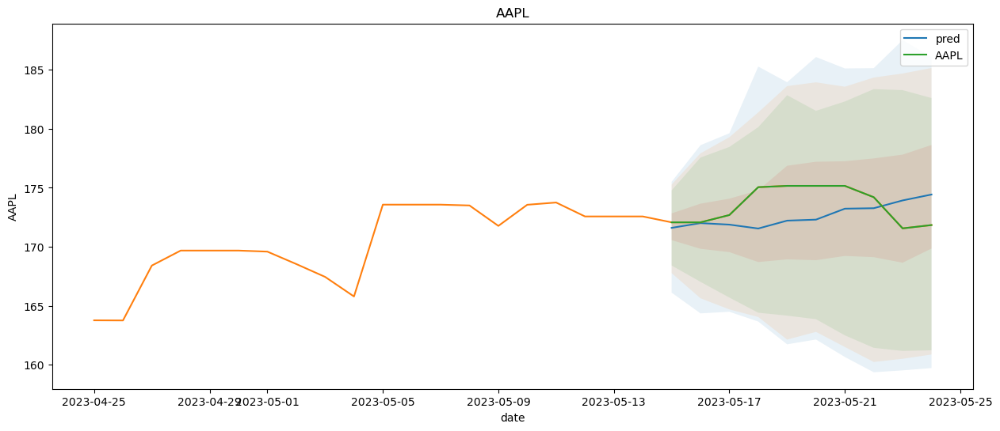

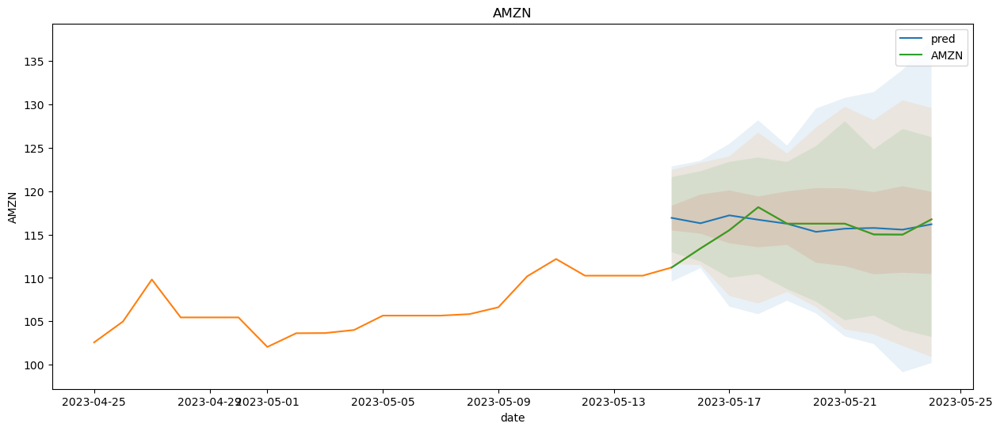

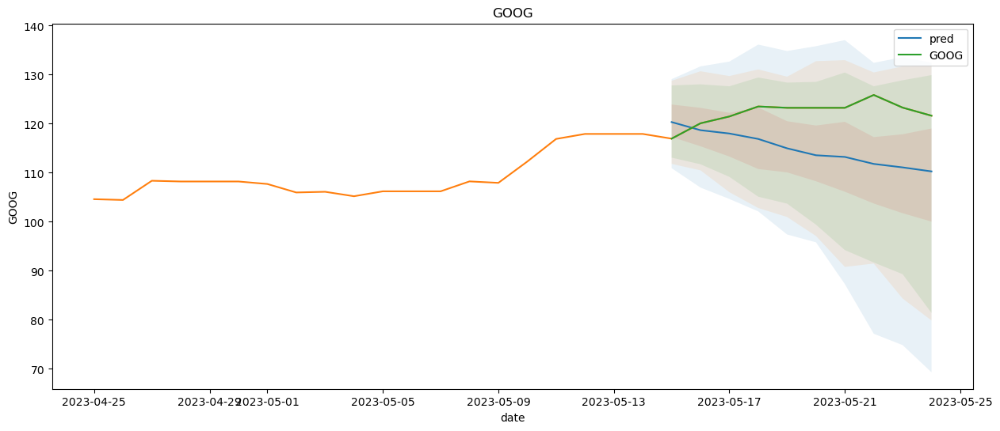

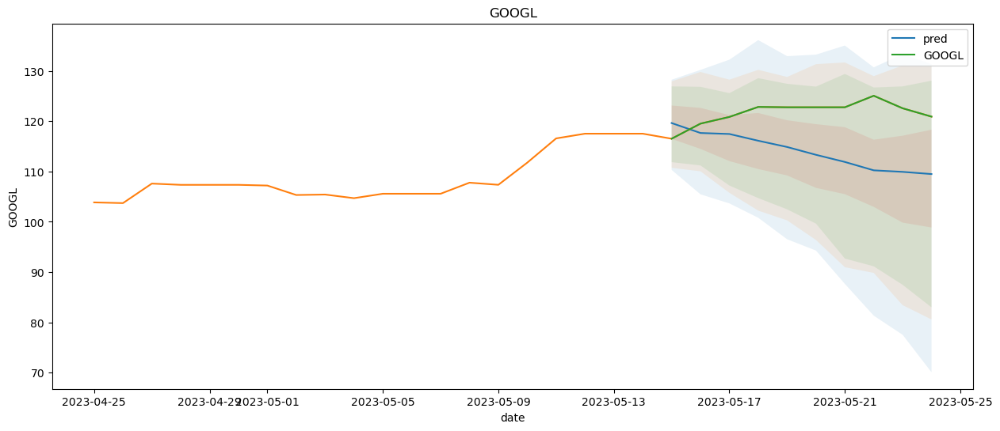

...

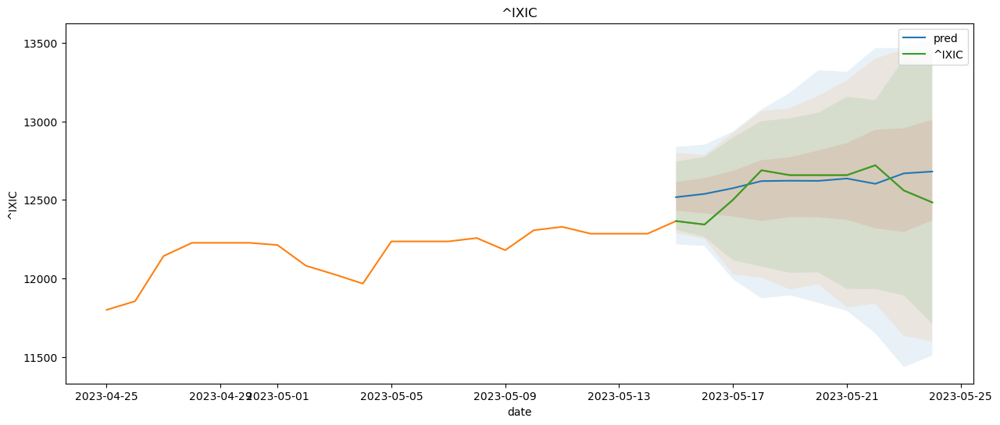

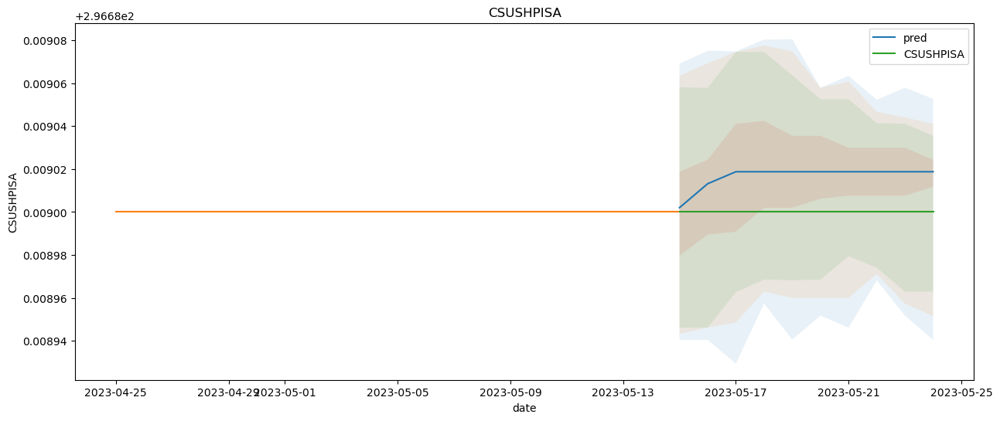

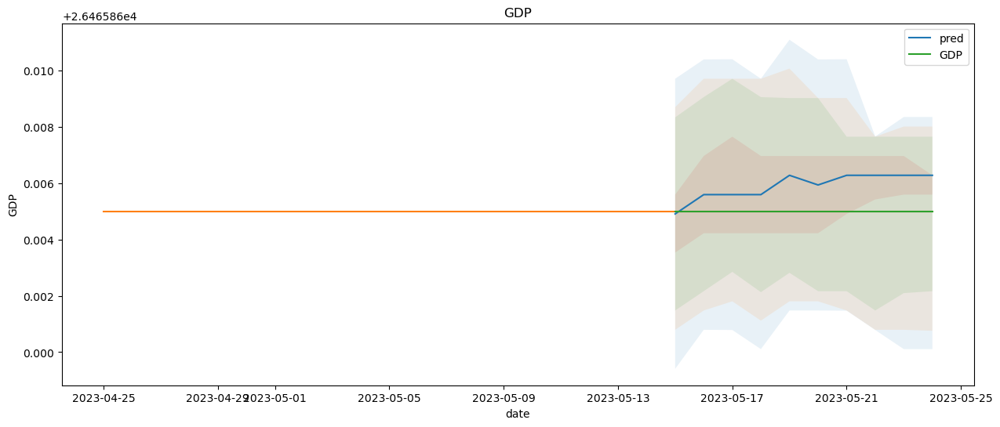

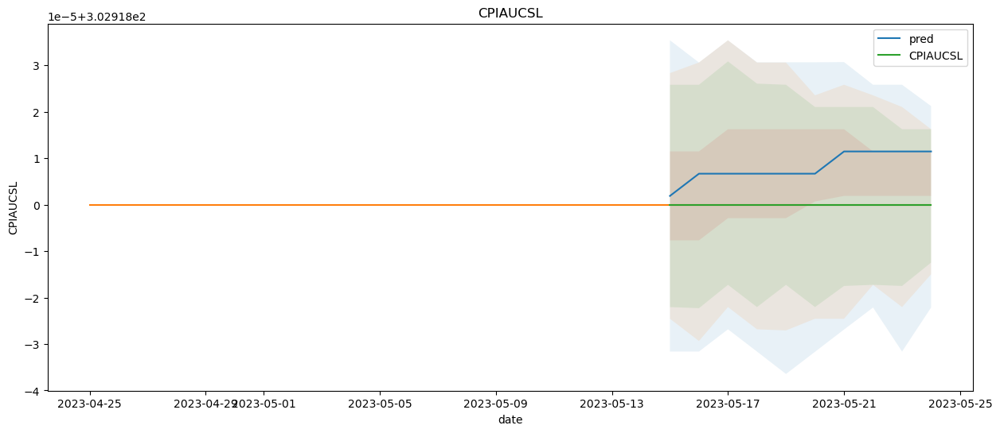

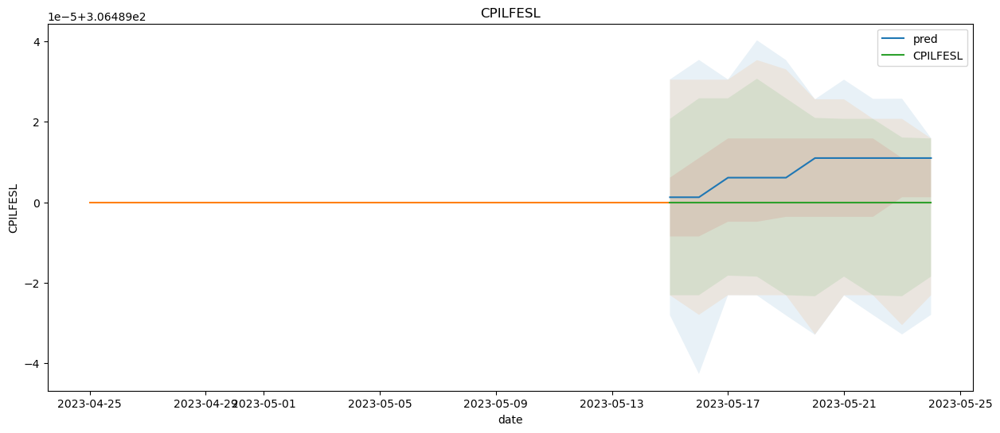

In [25]:
df_test = df_train_t[df_train_t['date'] > (df_train_t['date'].iloc[-1] - datetime.timedelta(days=10))]

prediction = best_model.predict(
    val_dataloader, mode="raw", return_index=True, trainer_kwargs=dict(accelerator="cpu")
)

df_test_pred = pd.DataFrame()
df_test_lower = pd.DataFrame()
df_test_upper = pd.DataFrame()

df_test_q1 = pd.DataFrame()
df_test_q99 = pd.DataFrame()

df_test_q2_5 = pd.DataFrame()
df_test_q97_5 = pd.DataFrame()

df_test_q5 = pd.DataFrame()
df_test_q95 = pd.DataFrame()

df_test_q25 = pd.DataFrame()
df_test_q75 = pd.DataFrame()
df_test_q50 = pd.DataFrame()


for index, row in prediction.index.iterrows():
    ts_predict = np.array(prediction.output.prediction[index, :])
    df_test_pred[str(row['series'])] = np.quantile(ts_predict, q=0.5, axis = 1) # ts_predict.mean(axis=1)
    df_test_lower[str(row['series'])] = np.quantile(ts_predict, q=0.01, axis = 1)
    df_test_upper[str(row['series'])] = np.quantile(ts_predict, q=0.99, axis = 1)
    
    
    #98% prediction interval
    df_test_q1[str(row['series'])] = np.quantile(ts_predict, q=0.01, axis = 1)
    df_test_q99[str(row['series'])] = np.quantile(ts_predict, q=0.99, axis = 1)
    
    #95% prediction interval
    df_test_q2_5[str(row['series'])] = np.quantile(ts_predict, q=0.025, axis = 1)
    df_test_q97_5[str(row['series'])] = np.quantile(ts_predict, q=0.975, axis = 1)
    
    #90% prediction interval
    df_test_q5[str(row['series'])] = np.quantile(ts_predict, q=0.05, axis = 1)
    df_test_q95[str(row['series'])] = np.quantile(ts_predict, q=0.95, axis = 1)

    #50% prediction interval
    df_test_q25[str(row['series'])] = np.quantile(ts_predict, q=0.25, axis = 1)
    df_test_q75[str(row['series'])] = np.quantile(ts_predict, q=0.75, axis = 1)
    
    # median
    df_test_q50[str(row['series'])] = np.quantile(ts_predict, q=0.5, axis = 1)
    
df_test_pred[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_pred[df_test.drop(columns=['date']).columns].values)
df_test_lower[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_lower[df_test.drop(columns=['date']).columns].values)
df_test_upper[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_upper[df_test.drop(columns=['date']).columns].values)
df_test_pred['date'] = df_test['date'].values
df_test_lower['date'] = df_test['date'].values
df_test_upper['date'] = df_test['date'].values


df_test_q1[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_q1[df_test.drop(columns=['date']).columns].values)
df_test_q2_5[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_q2_5[df_test.drop(columns=['date']).columns].values)
df_test_q5[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_q5[df_test.drop(columns=['date']).columns].values)
df_test_q97_5[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_q97_5[df_test.drop(columns=['date']).columns].values)
df_test_q99[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_q99[df_test.drop(columns=['date']).columns].values)
df_test_q95[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_q95[df_test.drop(columns=['date']).columns].values)
df_test_q25[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_q25[df_test.drop(columns=['date']).columns].values)
df_test_q75[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_q75[df_test.drop(columns=['date']).columns].values)
df_test_q50[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_q50[df_test.drop(columns=['date']).columns].values)

df_test_q1['date'] = df_test['date'].values
df_test_q2_5['date'] = df_test['date'].values
df_test_q5['date'] = df_test['date'].values
df_test_q97_5['date'] = df_test['date'].values
df_test_q99['date'] = df_test['date'].values
df_test_q95['date'] = df_test['date'].values
df_test_q25['date'] = df_test['date'].values
df_test_q75['date'] = df_test['date'].values
df_test_q50['date'] = df_test['date'].values

## metrics

for col in df_test.drop(columns=['date']).columns:
    print(col, ":")
    
    mae = mean_absolute_error(df_test[col], df_test_pred[col])
    mse = mean_squared_error(df_test[col], df_test_pred[col])
    rmse = mean_squared_error(df_test[col], df_test_pred[col], squared=False)

    mape = mape_metric(df_test[col].values, df_test_pred[col].values)
    smape = smape_metric(df_test[col].values, df_test_pred[col].values)

    print("MAPE:", mape)
    print("SMAPE:", smape)
    print(f"MAE: {mae}")
    print(f"MSE: {mse}")
    print(f"RMSE: {rmse}")
    print("\n")


# Total
print('Total')

y_true = df_test.drop(columns=['date']).values
y_pred = df_test_pred.drop(columns=['date']).values

mae = mean_absolute_error(y_true, y_pred)
mse = mean_squared_error(y_true, y_pred)
rmse = mean_squared_error(y_true, y_pred, squared=False)

mape = mape_metric(y_true, y_pred)
smape = smape_metric(y_true, y_pred)

print("MAPE:", mape)
print("SMAPE:", smape)
print(f"MAE: {mae}")
print(f"MSE: {mse}")
print(f"RMSE: {rmse}")
print("\n")



# plot
for col in df_test.drop(columns=['date']).columns:
    fig, ax = plt.subplots(1, 1, figsize=(15, 6))
    sns.lineplot(data=df_test_pred, x='date', y=col, ax=ax, label='pred')
    sns.lineplot(data=df_train_t.iloc[-30:], x='date', y=col, ax=ax)
    sns.lineplot(data=df_test,x='date', y=col, ax=ax, label=col)

    ax.fill_between(df_test['date'], df_test_q1[col], df_test_q99[col], alpha=0.1)
    ax.fill_between(df_test['date'], df_test_q2_5[col], df_test_q97_5[col], alpha=0.1)
    ax.fill_between(df_test['date'], df_test_q5[col], df_test_q95[col], alpha=0.1)
    ax.fill_between(df_test['date'], df_test_q25[col], df_test_q75[col], alpha=0.1)

    _ = ax.set_title(col)


GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


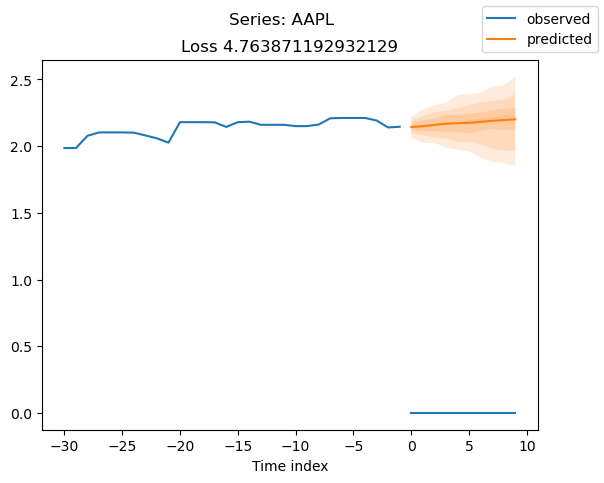

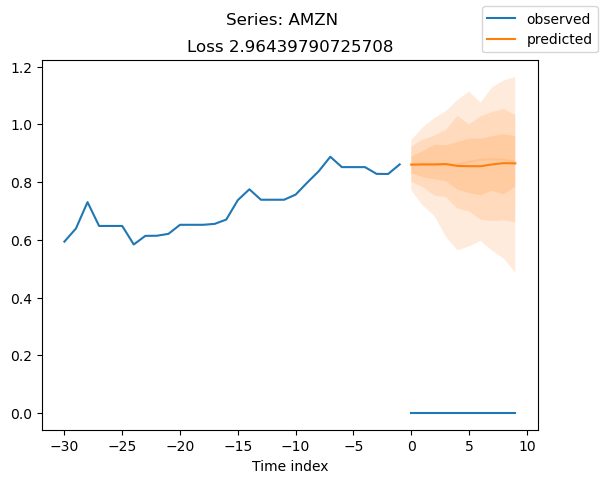

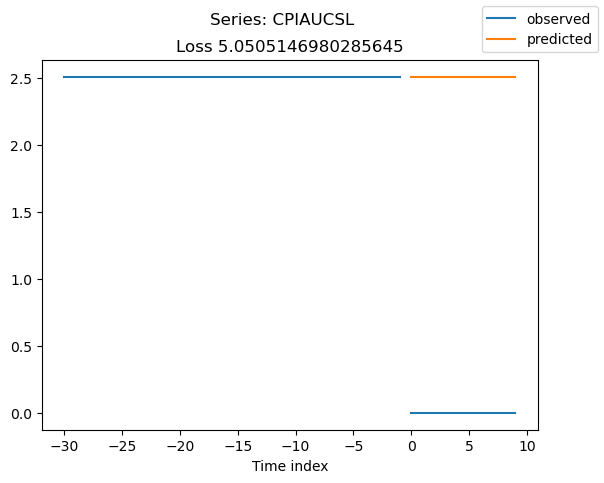

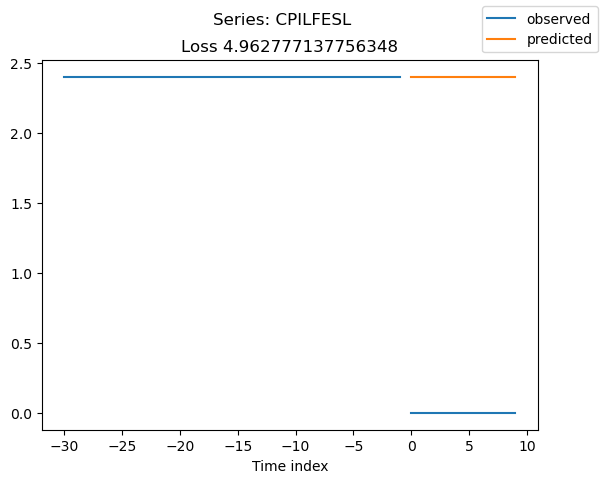

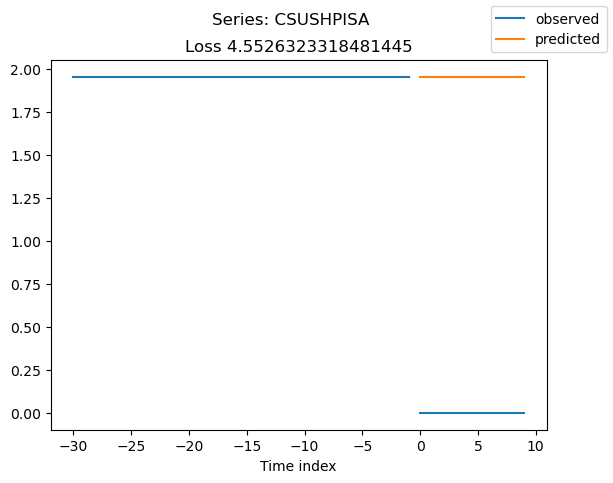

...

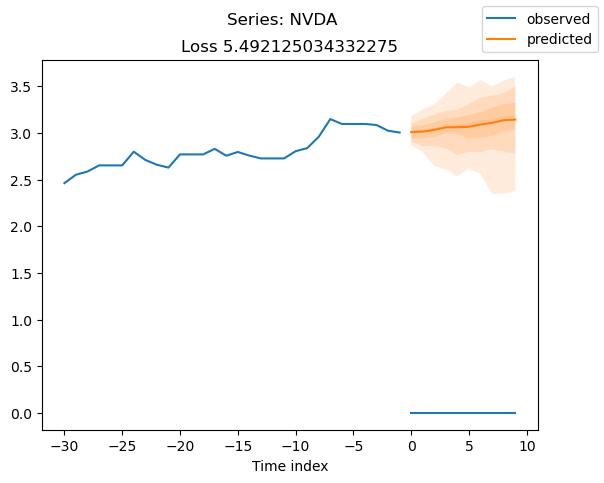

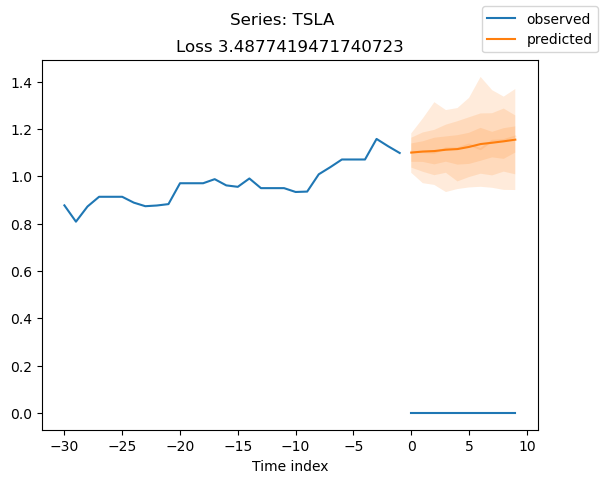

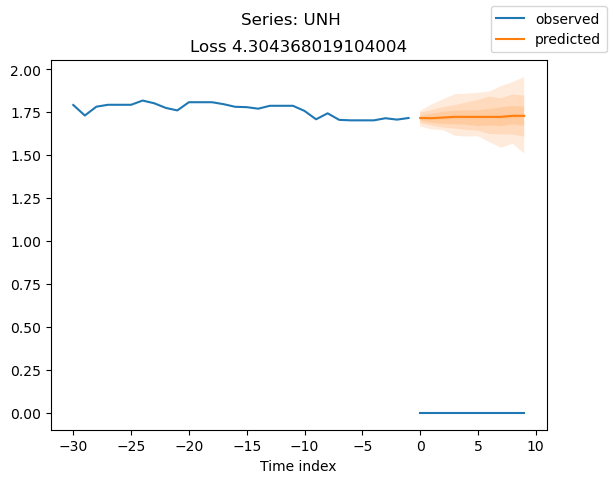

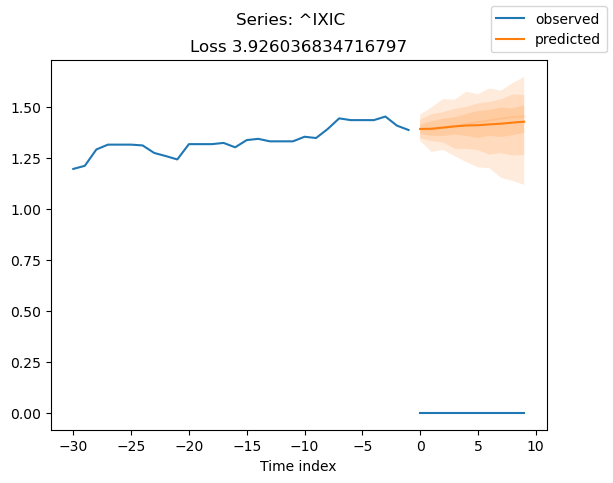

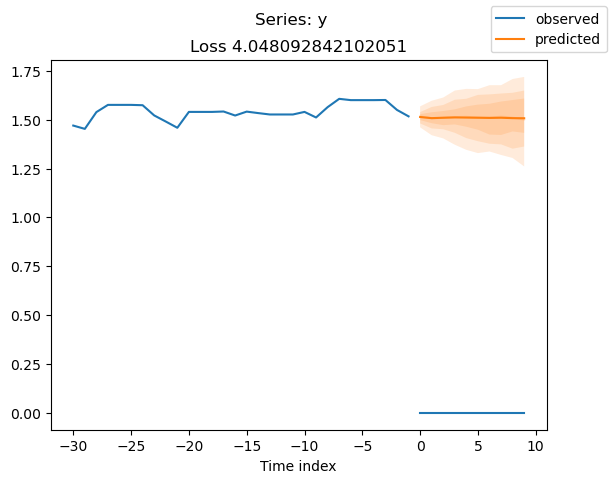

In [26]:

raw_predictions = best_model.predict(
    val_dataloader, mode="raw", return_x=True, return_y=True, n_samples=100, return_index=True, trainer_kwargs=dict(accelerator="cpu")
)

series = validation.x_to_index(raw_predictions.x)["series"]
for idx in range(17):  
    best_model.plot_prediction(raw_predictions.x, raw_predictions.output, idx=idx, add_loss_to_title=True)
    plt.suptitle(f"Series: {series.iloc[idx]}")

## DeepVAR Train with all Training set 

In [19]:

max_prediction_length = 10
max_encoder_length = 30


context_length = max_encoder_length
prediction_length = max_prediction_length

training = TimeSeriesDataSet(
    train_series,
    time_idx="time_idx",
    target="value",
    categorical_encoders={"series": NaNLabelEncoder().fit(train_series.series)},
    group_ids=["series"],
    static_categoricals=[
        "series"
    ],  # as we plan to forecast correlations, it is important to use series characteristics (e.g. a series identifier)
    time_varying_unknown_reals=["value"],
    max_encoder_length=context_length,
    max_prediction_length=prediction_length,
)



batch_size = 128
# synchronize samples in each batch over time - only necessary for DeepVAR, not for DeepAR
train_dataloader = training.to_dataloader(
    train=True, batch_size=batch_size, num_workers=0, batch_sampler="synchronized"
)


# early_stop_callback = EarlyStopping(monitor="train_loss", min_delta=1e-4, patience=10, verbose=False, mode="min")
trainer = pl.Trainer(
    max_epochs=30,
    accelerator="gpu",
    enable_model_summary=True,
    gradient_clip_val=0.1,
#     callbacks=[early_stop_callback],
    limit_train_batches=50,
    enable_checkpointing=True,
)


net = DeepAR.from_dataset(
    training,
    learning_rate=0.006431956578942552,
    log_interval=10,
    log_val_interval=1,
    hidden_size=38,
    rnn_layers=1,
    optimizer="Adam",
    loss=MultivariateNormalDistributionLoss(rank=14),
)

trainer.fit(
    net,
    train_dataloaders=train_dataloader
)



GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 3060') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name                   | Type                               | Params
------------------------------------------------------------------------------
0 | loss                   | MultivariateNormalDistributionLoss | 0     
1 | logging_metrics        | ModuleList                         | 0     
2 | embeddings             | MultiEmbedding                     | 136   
3 | rnn                    | LSTM                               | 7.4 

Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [14]:
import joblib
# save standard scaler
joblib.dump(ts_scaler, 'ts_scaler_v3') 

# save train_series
train_series.to_pickle("train_series_v3")

# save tsdataset
training.save("TimeSeriesDataSet_training_v3")

# save model in cpu
loaded_model_in_cpu = DeepAR.load_from_checkpoint(checkpoint_path=trainer.checkpoint_callback.best_model_path, map_location=torch.device('cpu'))
torch.save(loaded_model_in_cpu, 'model_v3')


In [20]:
date_range = pd.date_range(start=train_series['date'].max()+pd.Timedelta(days=1), end=train_series['date'].max()+pd.Timedelta(days=10), freq='D')
idx_range = np.arange(train_series['time_idx'].max()+1, train_series['time_idx'].max()+1 + 10)

train_series_new = train_series.copy()

for i in train_series['series'].unique():

    new_data = {
        'date': date_range,
        'series': [i]*max_prediction_length,
        'value': [0.0]*max_prediction_length,
        'time_idx': idx_range
    }
    
    new_df = pd.DataFrame(new_data)

    train_series_new = pd.concat([train_series_new, new_df], ignore_index=True)

train_series_new

,date,series,value,time_idx
0,2012-05-18,y,-1.533067,0
1,2012-05-19,y,-1.533067,1
2,2012-05-20,y,-1.533067,2
3,2012-05-21,y,-1.510600,3
4,2012-05-22,y,-1.509908,4
...,...,...,...,...
68573,2023-05-30,CPILFESL,0.000000,4029
68574,2023-05-31,CPILFESL,0.000000,4030
68575,2023-06-01,CPILFESL,0.000000,4031
68576,2023-06-02,CPILFESL,0.000000,4032


In [21]:
best_model_path = trainer.checkpoint_callback.best_model_path
best_model = DeepAR.load_from_checkpoint(best_model_path)


training_cutoff = train_series_new["time_idx"].max() - max_prediction_length

batch_size = 128
validation = TimeSeriesDataSet.from_dataset(training, train_series_new, min_prediction_idx=training_cutoff + 1)

val_dataloader = validation.to_dataloader(
    train=False, batch_size=batch_size, num_workers=0, batch_sampler="synchronized"
)


# predictions = best_model.predict(val_dataloader, trainer_kwargs=dict(accelerator="cpu"), return_y=True)
# MAE()(predictions.output, predictions.y)

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


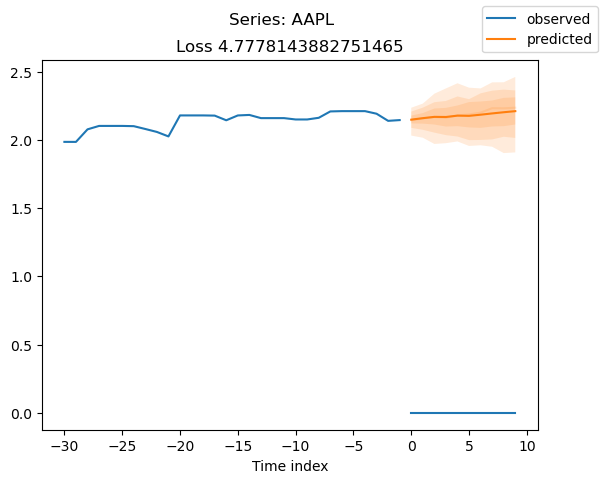

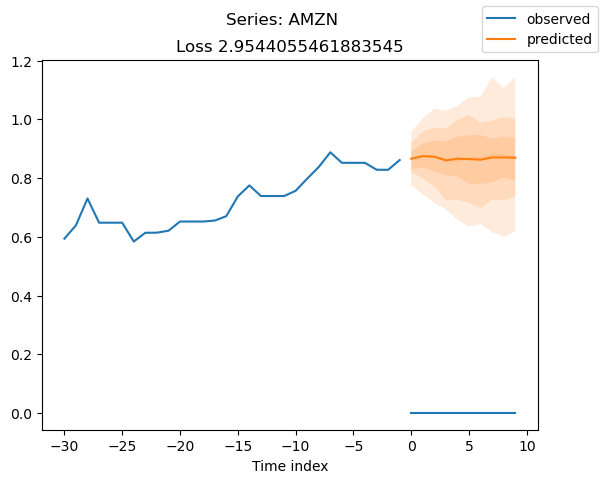

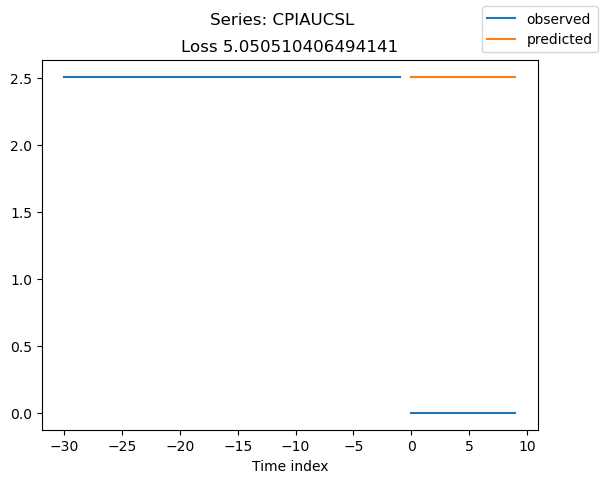

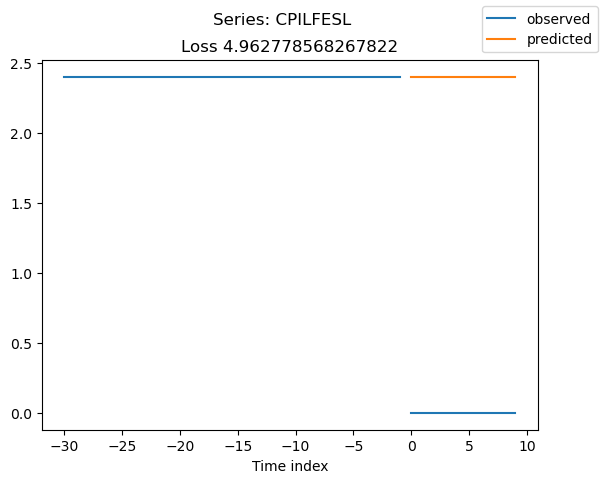

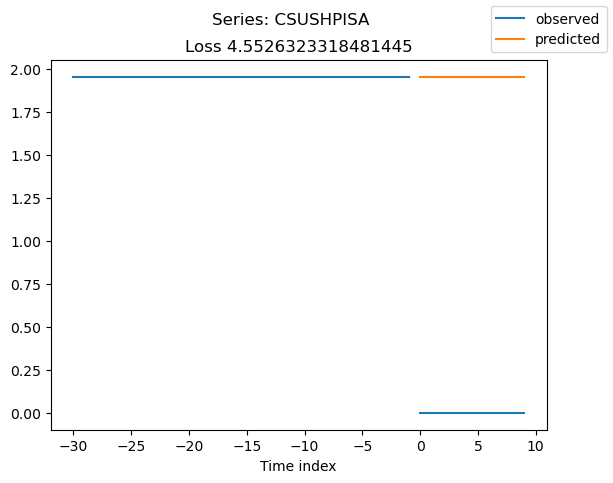

...

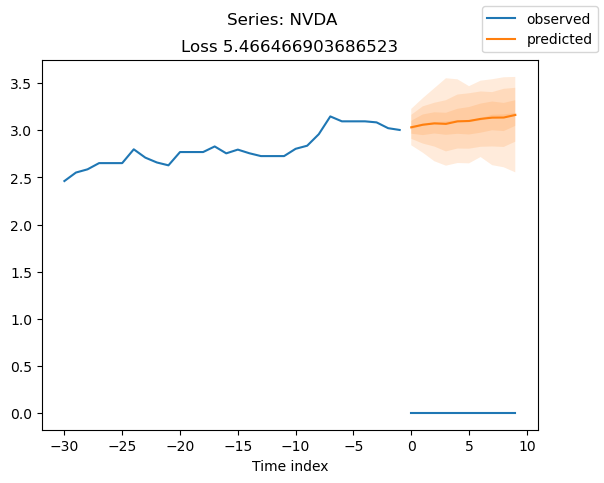

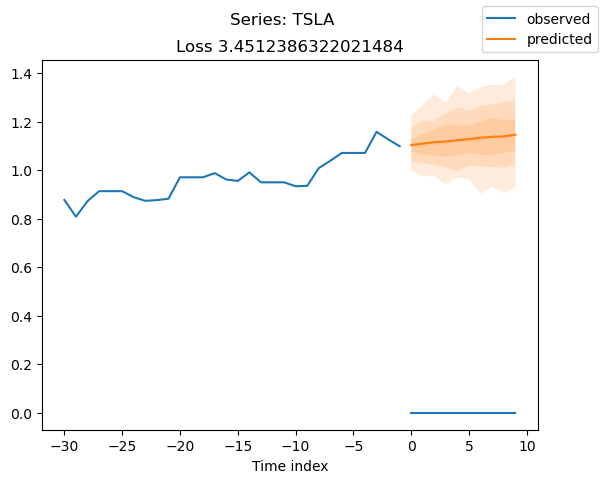

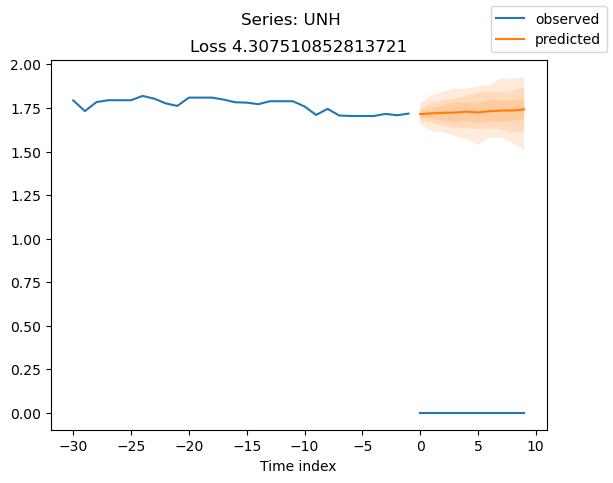

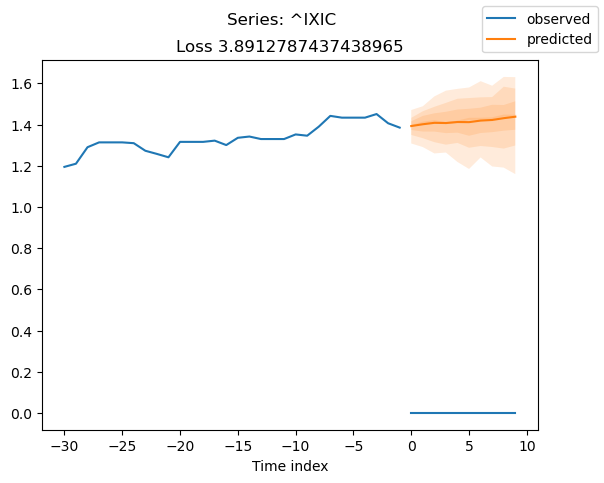

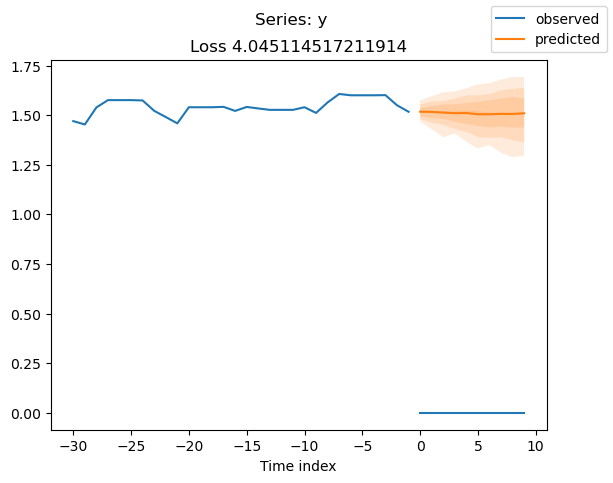

In [22]:
raw_predictions = best_model.predict(
    val_dataloader, mode="raw", return_x=True, return_y=True, n_samples=100, return_index=True, trainer_kwargs=dict(accelerator="cpu")
)

series = validation.x_to_index(raw_predictions.x)["series"]
for idx in range(17):  
    best_model.plot_prediction(raw_predictions.x, raw_predictions.output, idx=idx, add_loss_to_title=True)
    plt.suptitle(f"Series: {series.iloc[idx]}")

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


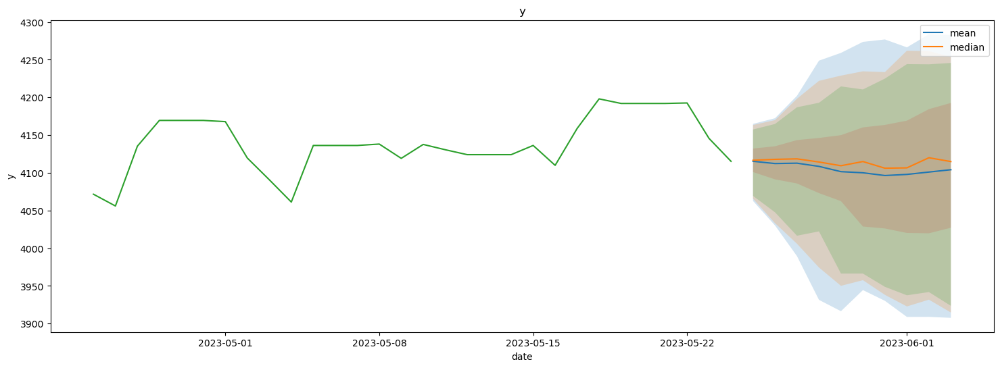

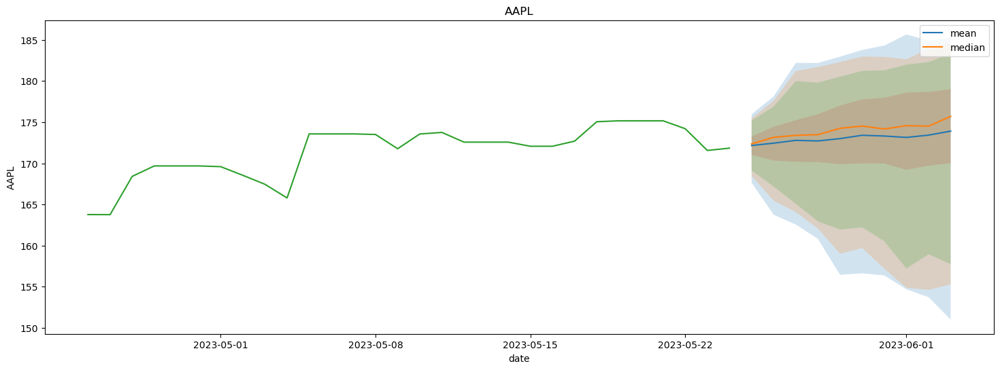

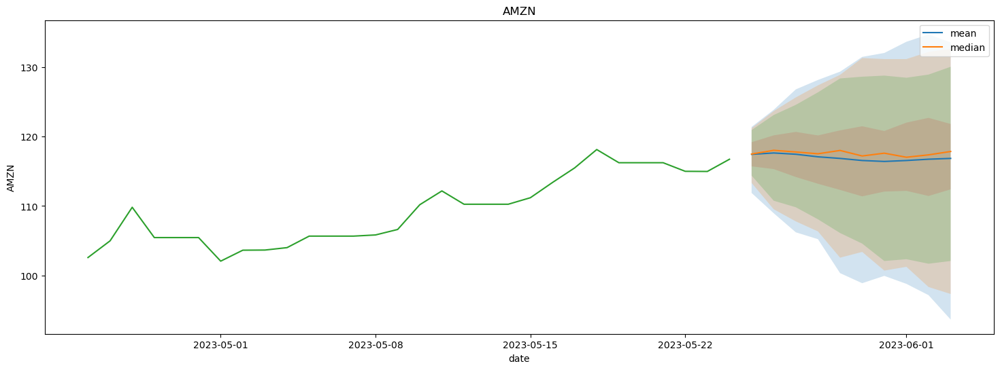

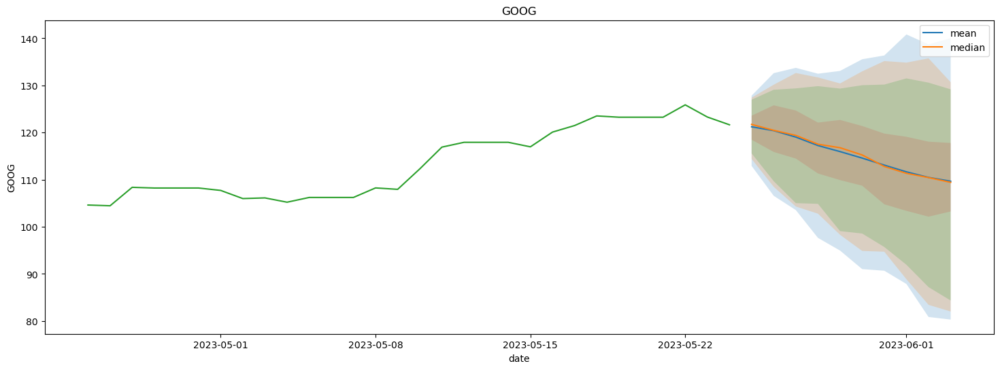

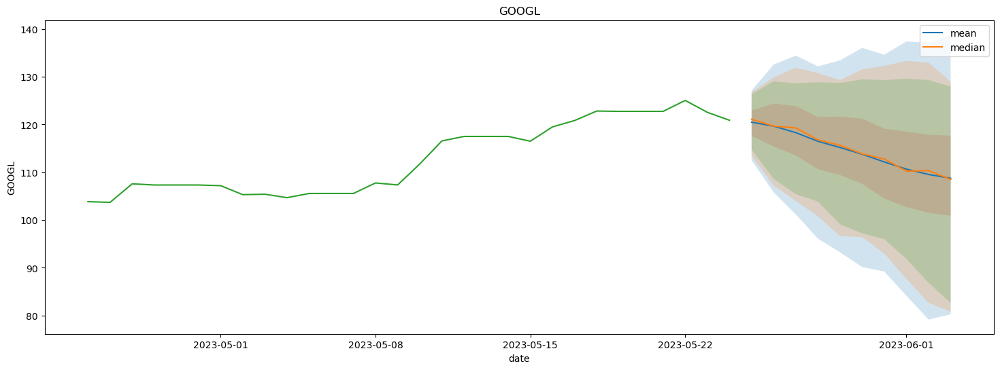

...

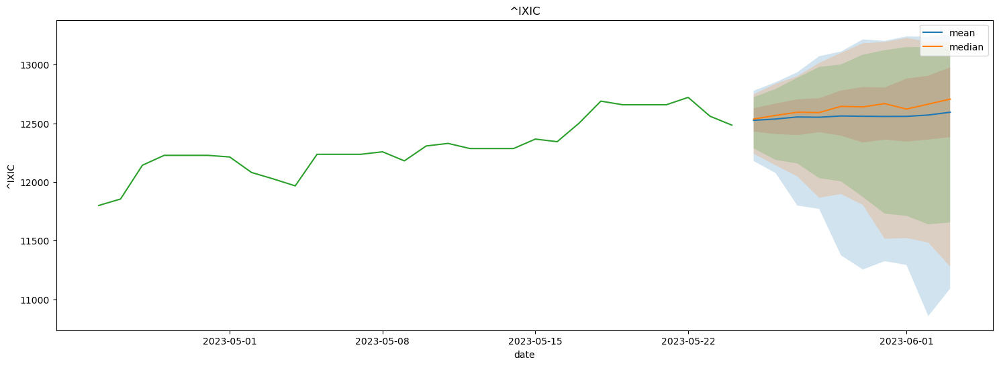

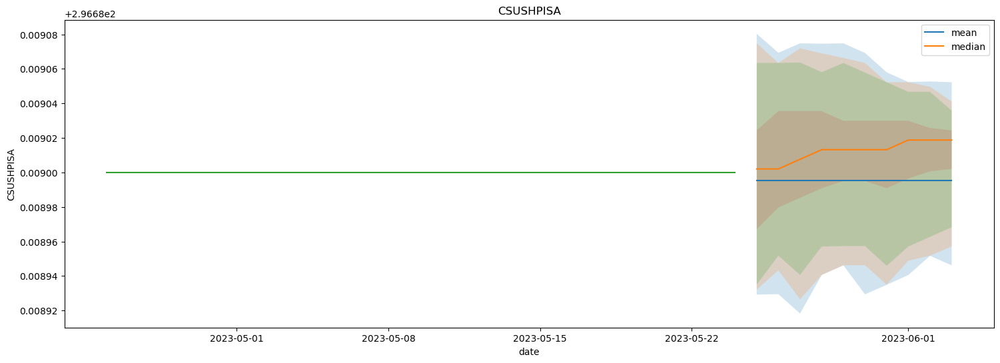

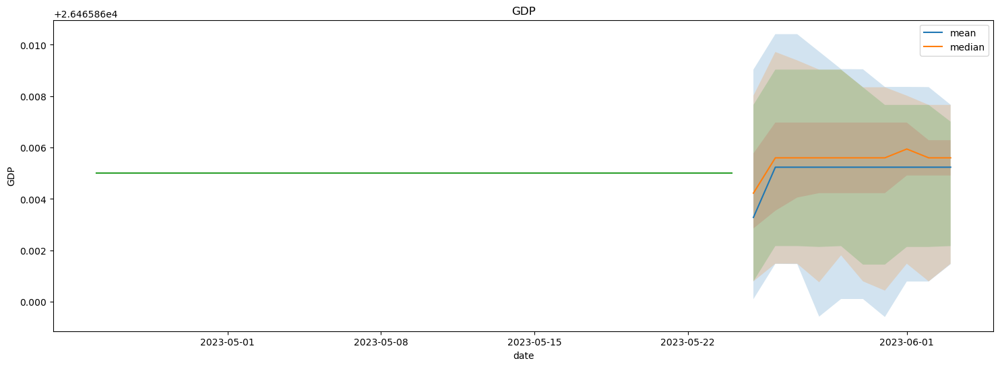

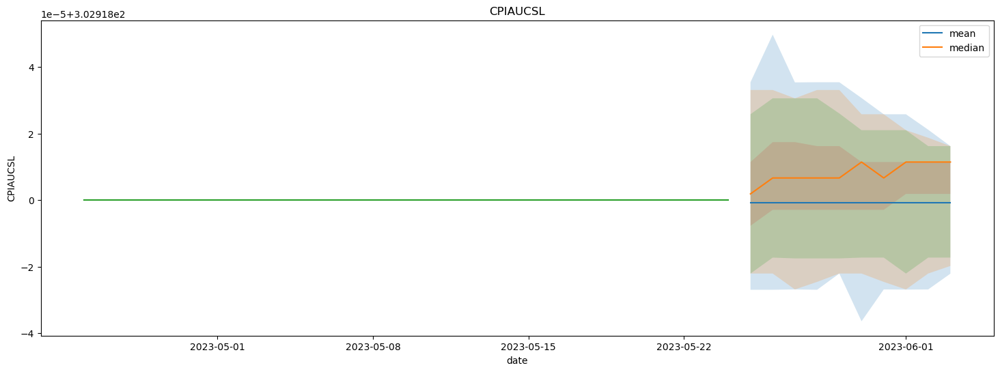

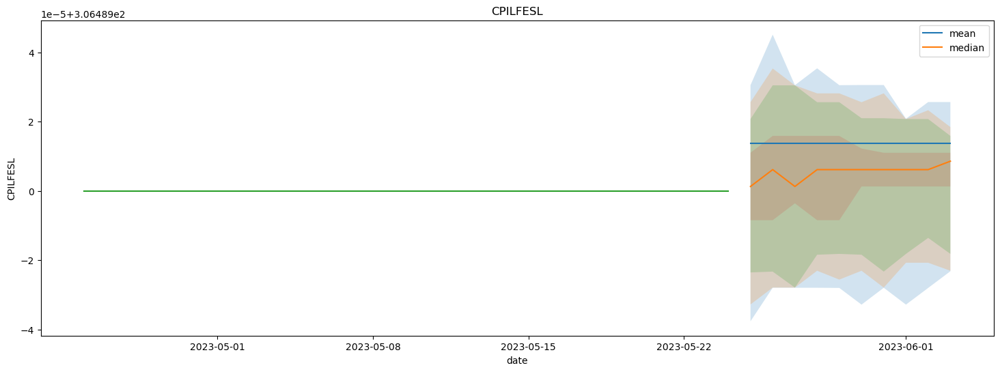

In [24]:

prediction = best_model.predict(
    val_dataloader, mode="raw", return_index=True, trainer_kwargs=dict(accelerator="cpu")
)

ts_columns = list(train_series['series'].unique())

df_test_pred = pd.DataFrame()
df_test_lower = pd.DataFrame()
df_test_upper = pd.DataFrame()

df_test_q1 = pd.DataFrame()
df_test_q99 = pd.DataFrame()

df_test_q2_5 = pd.DataFrame()
df_test_q97_5 = pd.DataFrame()

df_test_q5 = pd.DataFrame()
df_test_q95 = pd.DataFrame()

df_test_q25 = pd.DataFrame()
df_test_q75 = pd.DataFrame()
df_test_q50 = pd.DataFrame()


for index, row in prediction.index.iterrows():
    ts_predict = np.array(prediction.output.prediction[index, :])
    df_test_pred[str(row['series'])] = ts_predict.mean(axis=1)
    df_test_lower[str(row['series'])] = ts_predict.min(axis=1)
    df_test_upper[str(row['series'])] = ts_predict.max(axis=1)
    
    
    #98% prediction interval
    df_test_q1[str(row['series'])] = np.quantile(ts_predict, q=0.01, axis = 1)
    df_test_q99[str(row['series'])] = np.quantile(ts_predict, q=0.99, axis = 1)
    
    #95% prediction interval
    df_test_q2_5[str(row['series'])] = np.quantile(ts_predict, q=0.025, axis = 1)
    df_test_q97_5[str(row['series'])] = np.quantile(ts_predict, q=0.975, axis = 1)
    
    #90% prediction interval
    df_test_q5[str(row['series'])] = np.quantile(ts_predict, q=0.05, axis = 1)
    df_test_q95[str(row['series'])] = np.quantile(ts_predict, q=0.95, axis = 1)

    #50% prediction interval
    df_test_q25[str(row['series'])] = np.quantile(ts_predict, q=0.25, axis = 1)
    df_test_q75[str(row['series'])] = np.quantile(ts_predict, q=0.75, axis = 1)
    
    # median
    df_test_q50[str(row['series'])] = np.quantile(ts_predict, q=0.5, axis = 1)


    
df_test_pred[ts_columns] = ts_scaler.inverse_transform(df_test_pred[ts_columns].values)
df_test_lower[ts_columns] = ts_scaler.inverse_transform(df_test_lower[ts_columns].values)
df_test_upper[ts_columns] = ts_scaler.inverse_transform(df_test_upper[ts_columns].values)

df_test_q1[ts_columns] = ts_scaler.inverse_transform(df_test_q1[ts_columns].values)
df_test_q2_5[ts_columns] = ts_scaler.inverse_transform(df_test_q2_5[ts_columns].values)
df_test_q5[ts_columns] = ts_scaler.inverse_transform(df_test_q5[ts_columns].values)
df_test_q97_5[ts_columns] = ts_scaler.inverse_transform(df_test_q97_5[ts_columns].values)
df_test_q99[ts_columns] = ts_scaler.inverse_transform(df_test_q99[ts_columns].values)
df_test_q95[ts_columns] = ts_scaler.inverse_transform(df_test_q95[ts_columns].values)
df_test_q25[ts_columns] = ts_scaler.inverse_transform(df_test_q25[ts_columns].values)
df_test_q75[ts_columns] = ts_scaler.inverse_transform(df_test_q75[ts_columns].values)
df_test_q50[ts_columns] = ts_scaler.inverse_transform(df_test_q50[ts_columns].values)


df_test_pred['date'] = date_range.values
df_test_lower['date'] = date_range.values
df_test_upper['date'] = date_range.values

df_test_q1['date'] = date_range.values
df_test_q2_5['date'] = date_range.values
df_test_q5['date'] = date_range.values
df_test_q97_5['date'] = date_range.values
df_test_q99['date'] = date_range.values
df_test_q95['date'] = date_range.values
df_test_q25['date'] = date_range.values
df_test_q75['date'] = date_range.values
df_test_q50['date'] = date_range.values


# plot
for col in ts_columns:
    fig, ax = plt.subplots(1, 1, figsize=(18, 6))
    sns.lineplot(data=df_test_pred, x='date', y=col, ax=ax, label='mean')
    sns.lineplot(data=df_test_q50, x='date', y=col, ax=ax, label='median')

    sns.lineplot(data=df_train_t.iloc[-30:], x='date', y=col, ax=ax)
    ax.fill_between(df_test_q50['date'], df_test_q1[col], df_test_q99[col], alpha=0.2)
    ax.fill_between(df_test_q50['date'], df_test_q2_5[col], df_test_q97_5[col], alpha=0.2)
    ax.fill_between(df_test_q50['date'], df_test_q5[col], df_test_q95[col], alpha=0.2)
    ax.fill_between(df_test_q50['date'], df_test_q25[col], df_test_q75[col], alpha=0.15)

    _ = ax.set_title(col)

In [74]:

# Hyperparameter tunning

import optuna
import lightning.pytorch as pl
from lightning.pytorch.callbacks import EarlyStopping
from pytorch_forecasting import Baseline, DeepAR, TimeSeriesDataSet


def objective(trial):
    # Suggest hyperparameters
    learning_rate = trial.suggest_loguniform("learning_rate", 0.001, 0.1)
    hidden_size = trial.suggest_int("hidden_size", 4, 128)
    rank = trial.suggest_int("rank", 4, 30)
    rnn_layers = trial.suggest_int("rnn_layers", 1, 3)

    # Create the model
    model =  DeepAR.from_dataset(
        training,
        learning_rate=learning_rate,
        hidden_size=hidden_size,
        rnn_layers=rnn_layers,
        optimizer="Adam",
        loss=MultivariateNormalDistributionLoss(rank=rank),
    )
    
    
    # Create the PyTorch Lightning Trainer
    
    trainer = pl.Trainer(
        max_epochs=30,
        accelerator="gpu",
        gradient_clip_val=0.1,
        limit_train_batches=50,
        callbacks=[pl.callbacks.EarlyStopping(monitor="val_loss", min_delta=1e-4, patience=10)],
    )
    

    # Train the model
    trainer.fit(model, train_dataloaders=train_dataloader, val_dataloaders=val_dataloader)
    
    # Return the validation loss
    print(trainer.logged_metrics["val_loss"].item())
    return trainer.logged_metrics["val_loss"].item()



study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=50)

[I 2023-05-07 09:33:01,095] A new study created in memory with name: no-name-771af1fd-e566-40e5-b0b9-58b4ae629750
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 3060') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name                   | Type                               | Params
------------------------------------------------------------------------------
0 | loss                   | MultivariateNormalDistributionLoss | 0     
1 | logging_metrics        | ModuleList                         | 0     
2 | embeddings             | 

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.
[I 2023-05-07 09:33:35,629] Trial 0 finished with value: -44.560142517089844 and parameters: {'learning_rate': 0.012777131784298373, 'hidden_size': 16, 'rnn_layers': 3}. Best is trial 0 with value: -44.560142517089844.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 3060') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name                   | Type                               | Params
------------------------------------------------------------------------------
0 | loss              

-44.560142517089844


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

[I 2023-05-07 09:34:07,772] Trial 1 finished with value: -43.5327033996582 and parameters: {'learning_rate': 0.034917550667576264, 'hidden_size': 17, 'rnn_layers': 3}. Best is trial 0 with value: -44.560142517089844.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 3060') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name                   | Type                               | Params
------------------------------------------------------------------------------
0 | loss                   | MultivariateNormalDistributionLoss | 0     

-43.5327033996582


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

[I 2023-05-07 09:34:28,428] Trial 2 finished with value: -47.28982162475586 and parameters: {'learning_rate': 0.031088917415858053, 'hidden_size': 58, 'rnn_layers': 1}. Best is trial 2 with value: -47.28982162475586.


-47.28982162475586


In [86]:
print("Best trial:")
trial = study.best_trial

print("  Value: {}".format(trial.value))
print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

Best trial:
  Value: -47.28982162475586
  Params: 
    learning_rate: 0.031088917415858053
    hidden_size: 58
    rnn_layers: 1


In [82]:
# cov_matrix = best_model.loss.map_x_to_distribution(
#     best_model.predict(
#         val_dataloader, mode=("raw", "prediction"), n_samples=None, trainer_kwargs=dict(accelerator="cpu")
#     )
# ).base_dist.covariance_matrix.mean(0)

# # normalize the covariance matrix diagnoal to 1.0
# correlation_matrix = cov_matrix / torch.sqrt(torch.diag(cov_matrix)[None] * torch.diag(cov_matrix)[None].T)

# fig, ax = plt.subplots(1, 1, figsize=(10, 10))
# ax.imshow(correlation_matrix, cmap="bwr")

In [83]:
# # distribution of off-diagonal correlations
# plt.hist(correlation_matrix[correlation_matrix < 1].numpy())

### Temporal Fusion Transformer (TFT )

In [566]:
import copy
from pathlib import Path
import warnings

import lightning.pytorch as pl
from lightning.pytorch.callbacks import EarlyStopping, LearningRateMonitor
from lightning.pytorch.loggers import TensorBoardLogger
import numpy as np
import pandas as pd
import torch

from pytorch_forecasting import Baseline, TemporalFusionTransformer, TimeSeriesDataSet
from pytorch_forecasting.data import GroupNormalizer
from pytorch_forecasting.metrics import MAE, SMAPE, PoissonLoss, QuantileLoss
from pytorch_forecasting.models.temporal_fusion_transformer.tuning import optimize_hyperparameters

In [567]:
max_encoder_length = 30
max_prediction_length = 10


training_cutoff = train_series["time_idx"].max() - max_prediction_length


training = TimeSeriesDataSet(
    train_series[lambda x: x.time_idx <= training_cutoff],
    time_idx="time_idx",
    target="value",
    group_ids=["series"],
    min_encoder_length=max_encoder_length // 2,  # keep encoder length long (as it is in the validation set)
    max_encoder_length=max_encoder_length,
    min_prediction_length=1,
    max_prediction_length=max_prediction_length,
    static_categoricals=["series"],
#     static_reals=[],
#     time_varying_known_categoricals=[],
#     variable_groups={},  # group of categorical variables can be treated as one variable
    time_varying_known_reals=["time_idx"],
#     time_varying_unknown_categoricals=[],
    time_varying_unknown_reals=[
        "value"
    ],
#     target_normalizer=GroupNormalizer(
#         groups=["series"], transformation="softplus"
#     ),  # use softplus and normalize by group
    add_relative_time_idx=True,
    add_target_scales=True,
    add_encoder_length=True,
)

# create validation set (predict=True) which means to predict the last max_prediction_length points in time
# for each series
validation = TimeSeriesDataSet.from_dataset(training, train_series, predict=True, stop_randomization=True)

# create dataloaders for model
batch_size = 128  # set this between 32 to 128
train_dataloader = training.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader = validation.to_dataloader(train=False, batch_size=batch_size * 10, num_workers=0)

In [568]:
# calculate baseline mean absolute error, i.e. predict next value as the last available value from the history
baseline_predictions = Baseline().predict(val_dataloader, return_y=True)
MAE()(baseline_predictions.output, baseline_predictions.y)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


tensor(0.0565, device='cuda:0')

In [507]:
# configure network and trainer

trainer = pl.Trainer(
    accelerator="cpu",
    # clipping gradients is a hyperparameter and important to prevent divergance
    # of the gradient for recurrent neural networks
    gradient_clip_val=0.1,
)


tft = TemporalFusionTransformer.from_dataset(
    training,
    # not meaningful for finding the learning rate but otherwise very important
    learning_rate=0.03,
    hidden_size=8,  # most important hyperparameter apart from learning rate
    # number of attention heads. Set to up to 4 for large datasets
    attention_head_size=1,
    dropout=0.1,  # between 0.1 and 0.3 are good values
    hidden_continuous_size=8,  # set to <= hidden_size
    loss=QuantileLoss(),
    optimizer="Ranger"
    # reduce learning rate if no improvement in validation loss after x epochs
    # reduce_on_plateau_patience=1000,
)
print(f"Number of parameters in network: {tft.size()/1e3:.1f}k")

Number of parameters in network: 7.0k


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=100` reached.
Learning rate set to 0.10964781961431845
Restoring states from the checkpoint path at /home/freddy/MIAD_project/MIAD_P/MIAD_proyecto_grado/.lr_find_5a8a62a3-8856-4f22-aa15-ed5554fcb10a.ckpt
Restored all states from the checkpoint at /home/freddy/MIAD_project/MIAD_P/MIAD_proyecto_grado/.lr_find_5a8a62a3-8856-4f22-aa15-ed5554fcb10a.ckpt


suggested learning rate: 0.10964781961431845


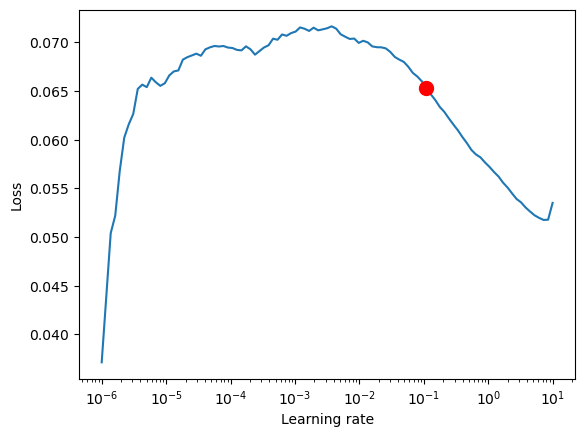

In [408]:
# find optimal learning rate
from lightning.pytorch.tuner import Tuner

res = Tuner(trainer).lr_find(
    tft,
    train_dataloaders=train_dataloader,
    val_dataloaders=val_dataloader,
    max_lr=10.0,
    min_lr=1e-6,
)

print(f"suggested learning rate: {res.suggestion()}")
fig = res.plot(show=True, suggest=True)
fig.show()

In [569]:
# configure network and trainer
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1e-4, patience=10, verbose=False, mode="min")
lr_logger = LearningRateMonitor()  # log the learning rate
logger = TensorBoardLogger("lightning_logs")  # logging results to a tensorboard

trainer = pl.Trainer(
    max_epochs=50,
    accelerator="gpu",
    enable_model_summary=True,
    gradient_clip_val=0.4355074605906737,
    limit_train_batches=50,  # coment in for training, running valiation every 30 batches
    # fast_dev_run=True,  # comment in to check that networkor dataset has no serious bugs
    callbacks=[lr_logger, early_stop_callback],
    logger=logger,
)

tft = TemporalFusionTransformer.from_dataset(
    training,
    learning_rate=0.0108304938177929,
    hidden_size=12,
    attention_head_size=1,
    dropout=0.24585449112341284,
    hidden_continuous_size=9,
    loss=QuantileLoss(),
    log_interval=10,  # uncomment for learning rate finder and otherwise, e.g. to 10 for logging every 10 batches
    optimizer="Ranger",
    reduce_on_plateau_patience=4,
)
print(f"Number of parameters in network: {tft.size()/1e3:.1f}k")

Number of parameters in network: 12.8k


In [570]:
# fit network
trainer.fit(
    tft,
    train_dataloaders=train_dataloader,
    val_dataloaders=val_dataloader,
)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

   | Name                               | Type                            | Params
----------------------------------------------------------------------------------------
0  | loss                               | QuantileLoss                    | 0     
1  | logging_metrics                    | ModuleList                      | 0     
2  | input_embeddings                   | MultiEmbedding                  | 136   
3  | prescalers                         | ModuleDict                      | 108   
4  | static_variable_selection          | VariableSelectionNetwork        | 1.8 K 
5  | encoder_variable_selection         | VariableSelectionNetwork        | 1.7 K 
6  | decoder_variable_selection         | VariableSelectionNetwork        | 1.1 K 
7  | static_context_variable_selection  | GatedResidualNetwork            | 648   
8  | static_context_initial_hidden_lstm | GatedResidualNetwork            | 648   
9  | static_context_initial_cell_lstm 

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [572]:

best_model_path = trainer.checkpoint_callback.best_model_path
best_tft = TemporalFusionTransformer.load_from_checkpoint(best_model_path)

predictions = best_tft.predict(val_dataloader, return_y=True, trainer_kwargs=dict(accelerator="cpu"))
MAE()(predictions.output, predictions.y)

tensor(0.0591)

In [413]:
# Hyperparameter tuning
import pickle

from pytorch_forecasting.models.temporal_fusion_transformer.tuning import optimize_hyperparameters

# create study
study = optimize_hyperparameters(
    train_dataloader,
    val_dataloader,
    model_path="optuna_test",
    n_trials=10,
    max_epochs=50,
    gradient_clip_val_range=(0.01, 1.0),
    hidden_size_range=(8, 128),
    hidden_continuous_size_range=(8, 128),
    attention_head_size_range=(1, 4),
    learning_rate_range=(0.001, 0.1),
    dropout_range=(0.1, 0.3),
    trainer_kwargs=dict(limit_train_batches=30),
    reduce_on_plateau_patience=4,
    use_learning_rate_finder=False,  # use Optuna to find ideal learning rate or use in-built learning rate finder
)

# save study results - also we can resume tuning at a later point in time
with open("test_study.pkl", "wb") as fout:
    pickle.dump(study, fout)

# show best hyperparameters
print(study.best_trial.params)

[I 2023-05-07 12:56:25,498] A new study created in memory with name: no-name-427ca8ce-ec89-470e-86aa-316be46cde9c
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 3060') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
[I 2023-05-07 12:59:10,309] Trial 0 finished with value: 0.030320430174469948 and parameters: {'gradient_clip_val': 0.10502110677290472, 'hidden_size': 108, 'dropout': 0.14563844777838927, 'hidden_continuous_size': 8, 'attention_head_size': 4, 'learning_rate': 0.003728810465884394}. Best is trial 0 with value: 0.03032043017446

KeyError: 'val_loss'

In [579]:
prediction.output.prediction[0]

tensor([[1.9823, 2.0403, 2.0659, 2.0807, 2.0977, 2.1256, 2.1805],
        [1.9733, 2.0354, 2.0645, 2.0841, 2.1045, 2.1361, 2.1959],
        [1.9606, 2.0288, 2.0623, 2.0869, 2.1114, 2.1479, 2.2141],
        [1.9458, 2.0212, 2.0595, 2.0893, 2.1184, 2.1604, 2.2333],
        [1.9302, 2.0133, 2.0564, 2.0915, 2.1252, 2.1729, 2.2523],
        [1.9149, 2.0056, 2.0531, 2.0936, 2.1318, 2.1849, 2.2702],
        [1.9008, 1.9986, 2.0499, 2.0956, 2.1381, 2.1961, 2.2867],
        [1.8884, 1.9925, 2.0470, 2.0975, 2.1440, 2.2063, 2.3014],
        [1.8782, 1.9874, 2.0446, 2.0993, 2.1493, 2.2154, 2.3143],
        [1.8700, 1.9834, 2.0428, 2.1012, 2.1542, 2.2236, 2.3257]])

y :
MAPE: 0.9440960415285795
SMAPE: 0.9364912326500918
MAE: 38.6833251953125
MSE: 2558.4155563414097
RMSE: 50.580782480517335


AAPL :
MAPE: 1.1640381317208375
SMAPE: 1.1576040196860902
MAE: 1.925213623046875
MSE: 4.761496449122205
RMSE: 2.1820853441426635


AMZN :
MAPE: 2.9529600259796935
SMAPE: 3.011523462024283
MAE: 3.156304931640625
MSE: 13.269656960654538
RMSE: 3.642754035157265


GOOG :
MAPE: 1.0682436625011387
SMAPE: 1.0747604712492944
MAE: 1.1410202026367187
MSE: 1.8701409875415265
RMSE: 1.3675309822967545


GOOGL :
MAPE: 1.104486676422537
SMAPE: 1.1099200277165882
MAE: 1.1697830200195312
MSE: 1.7466024043736978
RMSE: 1.3215908611872653


META :
MAPE: 4.234338333626441
SMAPE: 4.266341243477122
MAE: 9.428204345703126
MSE: 124.41128395986743
RMSE: 11.153980632934031


MSFT :
MAPE: 2.4811147010264962
SMAPE: 2.492488022362107
MAE: 7.2591064453125
MSE: 85.0040986502543
RMSE: 9.219766735132419


NVDA :
MAPE: 2.3059731971454096
SMAPE: 2.2728427607826607
MAE: 6.210360717773438
MSE: 50.

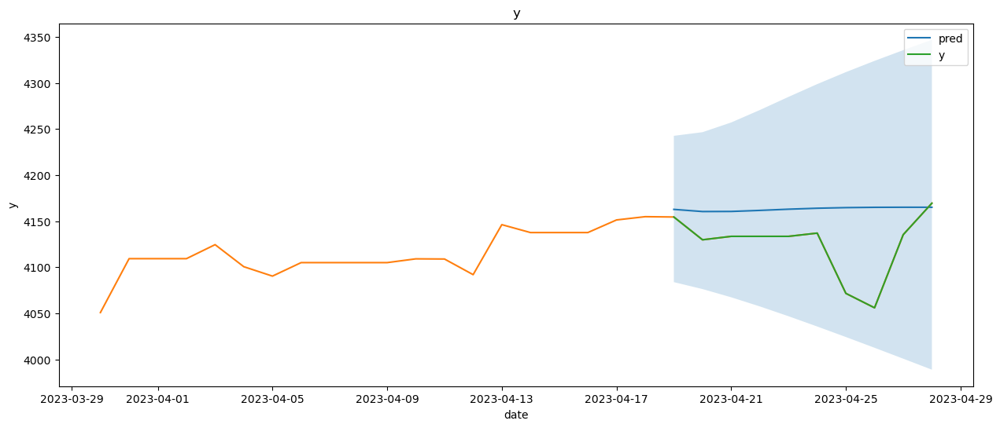

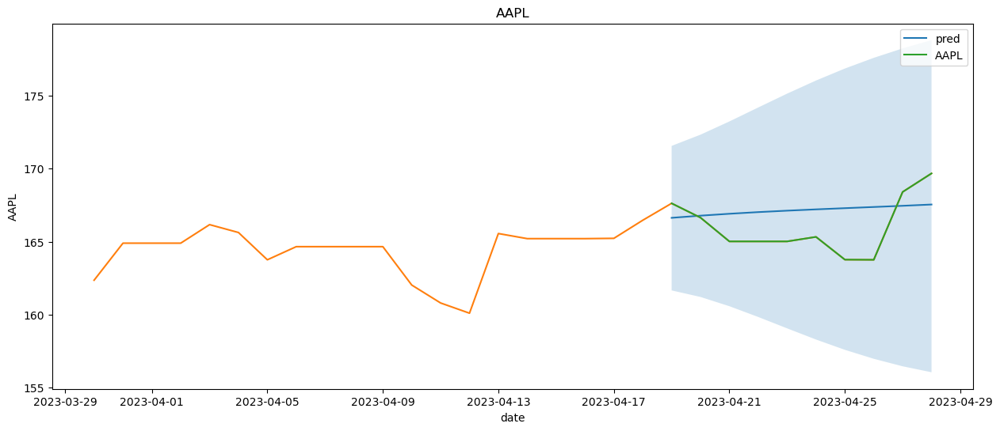

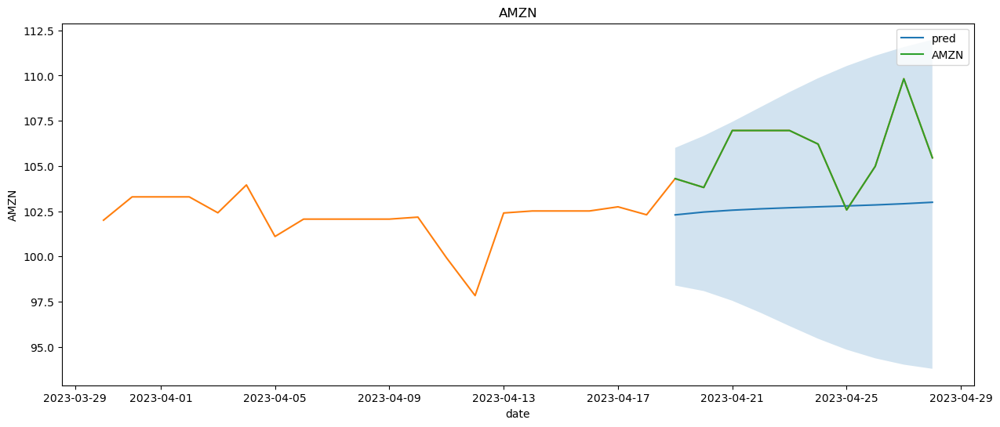

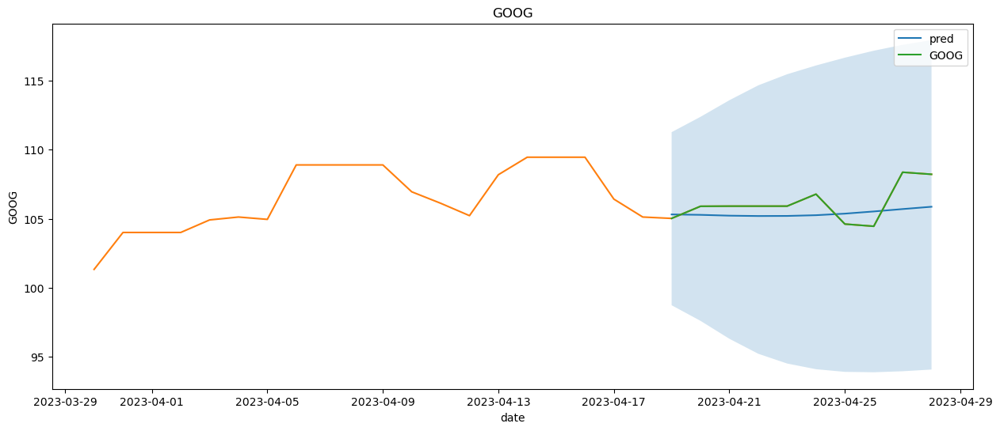

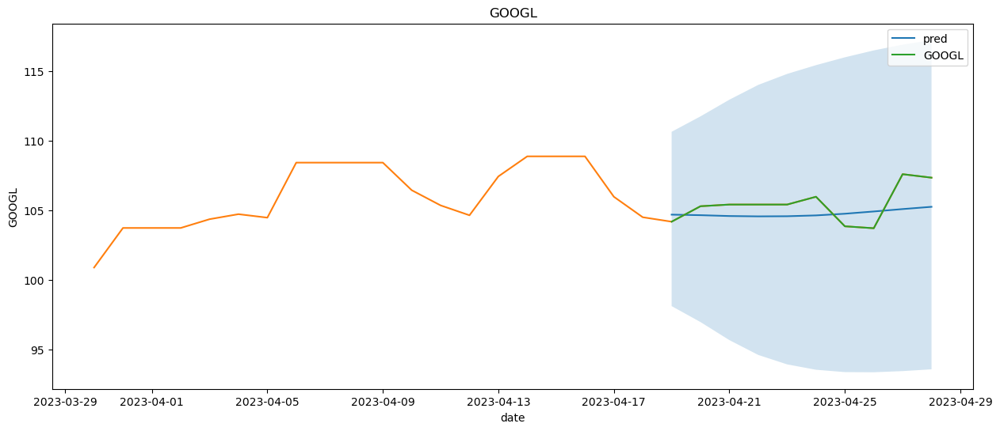

...

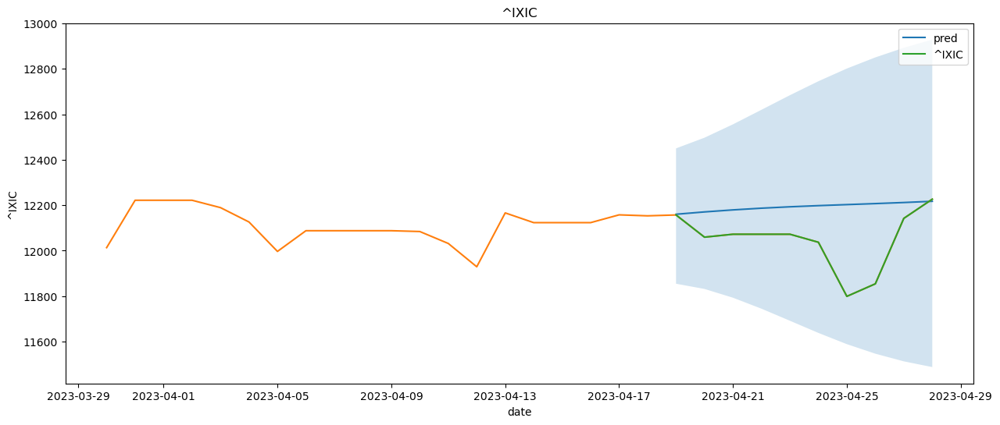

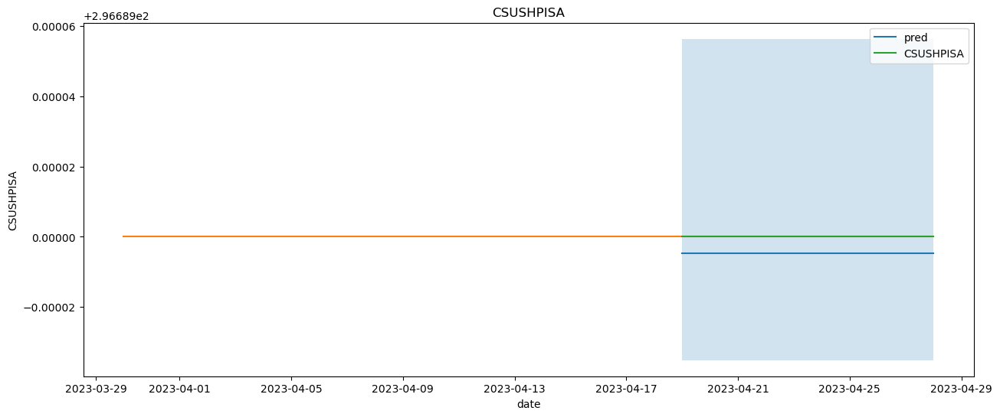

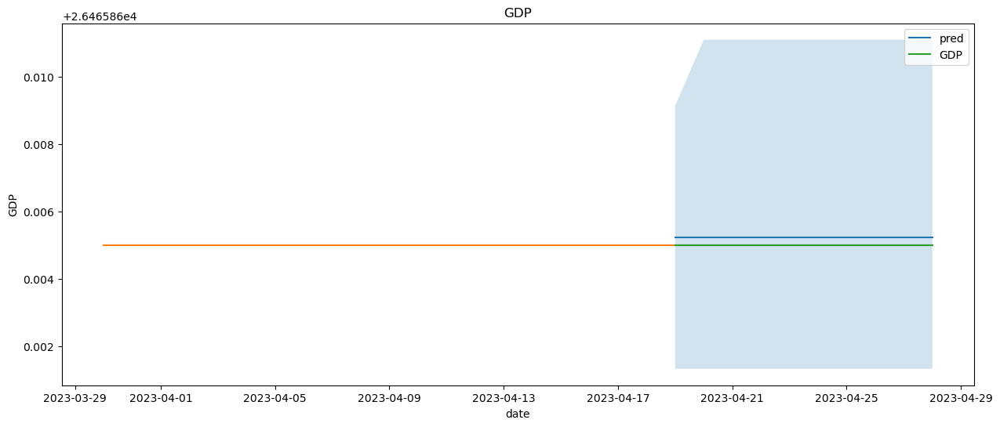

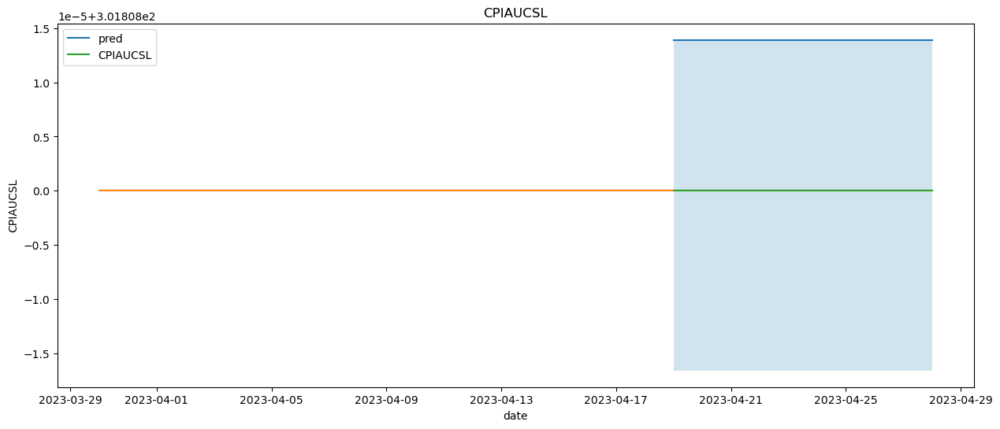

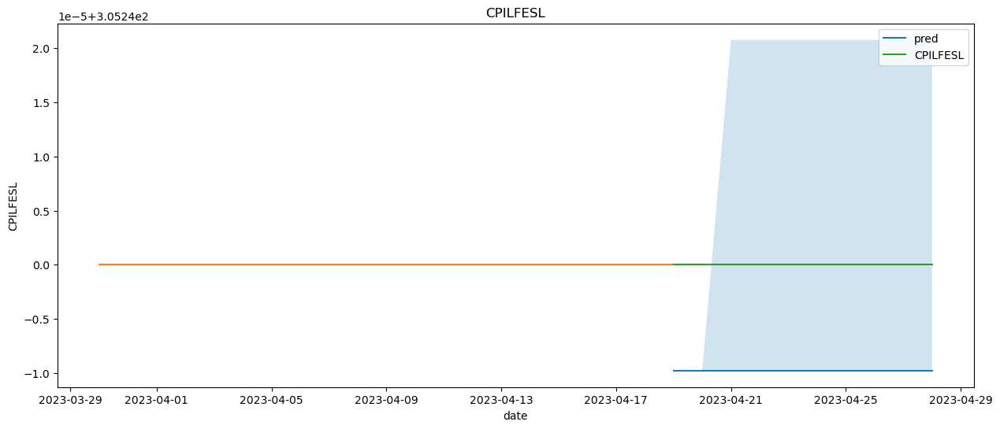

In [578]:
# load the best model according to the validation loss
# (given that we use early stopping, this is not necessarily the last epoch)


df_test = df_train_t[df_train_t['date'] > (df_train_t['date'].iloc[-1] - datetime.timedelta(days=10))]

prediction = best_tft.predict(
    val_dataloader, mode="raw", return_index=True, trainer_kwargs=dict(accelerator="cpu")
)

df_test_pred = pd.DataFrame()
df_test_lower = pd.DataFrame()
df_test_upper = pd.DataFrame()

for index, row in prediction.index.iterrows():
    ts_predict = np.array(prediction.output.prediction[index, :])
    df_test_pred[str(row['series'])] = ts_predict.mean(axis=1)
    df_test_lower[str(row['series'])] = ts_predict.min(axis=1)
    df_test_upper[str(row['series'])] = ts_predict.max(axis=1)
    
df_test_pred[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_pred[df_test.drop(columns=['date']).columns].values)
df_test_lower[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_lower[df_test.drop(columns=['date']).columns].values)
df_test_upper[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_upper[df_test.drop(columns=['date']).columns].values)
df_test_pred['date'] = df_test['date'].values
df_test_lower['date'] = df_test['date'].values
df_test_upper['date'] = df_test['date'].values



## metrics

for col in df_test.drop(columns=['date']).columns:
    print(col, ":")
    
    mae = mean_absolute_error(df_test[col], df_test_pred[col])
    mse = mean_squared_error(df_test[col], df_test_pred[col])
    rmse = mean_squared_error(df_test[col], df_test_pred[col], squared=False)

    mape = mape_metric(df_test[col].values, df_test_pred[col].values)
    smape = smape_metric(df_test[col].values, df_test_pred[col].values)

    print("MAPE:", mape)
    print("SMAPE:", smape)
    print(f"MAE: {mae}")
    print(f"MSE: {mse}")
    print(f"RMSE: {rmse}")
    print("\n")


# Total
print('Total')

y_true = df_test.drop(columns=['date']).values
y_pred = df_test_pred.drop(columns=['date']).values

mae = mean_absolute_error(y_true, y_pred)
mse = mean_squared_error(y_true, y_pred)
rmse = mean_squared_error(y_true, y_pred, squared=False)

mape = mape_metric(y_true, y_pred)
smape = smape_metric(y_true, y_pred)

print("MAPE:", mape)
print("SMAPE:", smape)
print(f"MAE: {mae}")
print(f"MSE: {mse}")
print(f"RMSE: {rmse}")
print("\n")



# plot
for col in df_test.drop(columns=['date']).columns:
    fig, ax = plt.subplots(1, 1, figsize=(15, 6))
    sns.lineplot(data=df_test_pred, x='date', y=col, ax=ax, label='pred')
    sns.lineplot(data=df_train_t.iloc[-30:], x='date', y=col, ax=ax)
    sns.lineplot(data=df_test,x='date', y=col, ax=ax, label=col)

    ax.fill_between(df_test['date'], df_test_lower[col], df_test_upper[col], alpha=0.2)
    _ = ax.set_title(col)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


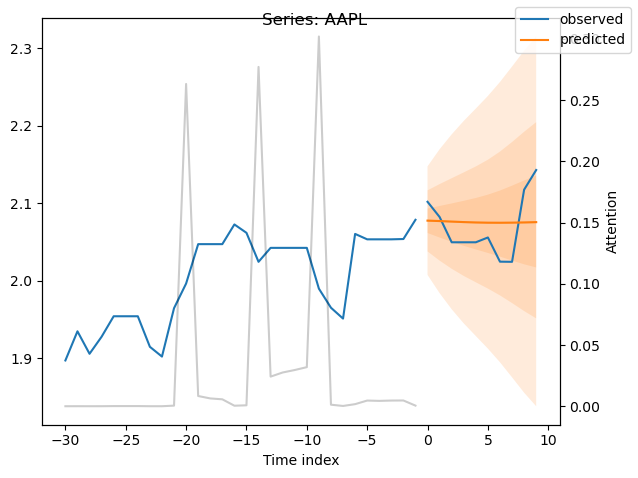

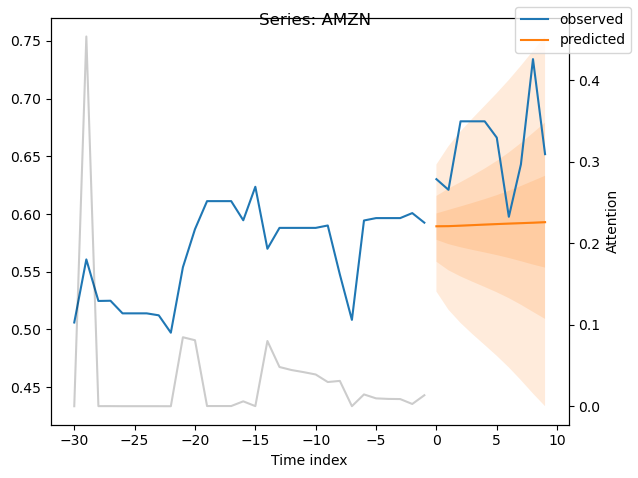

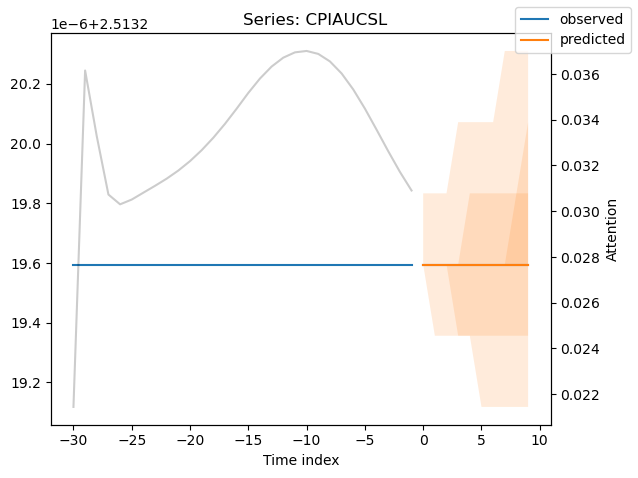

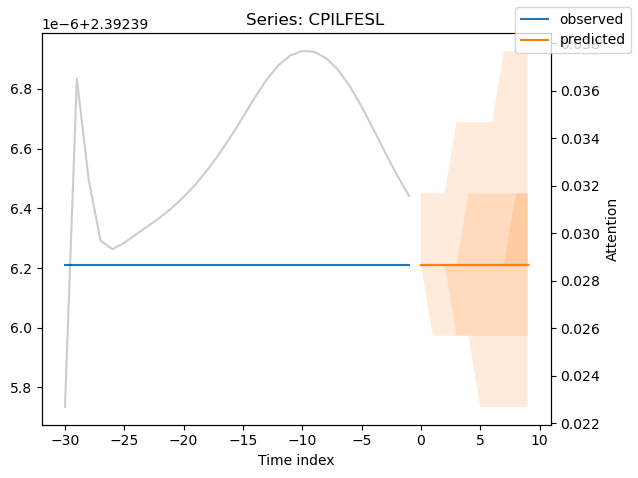

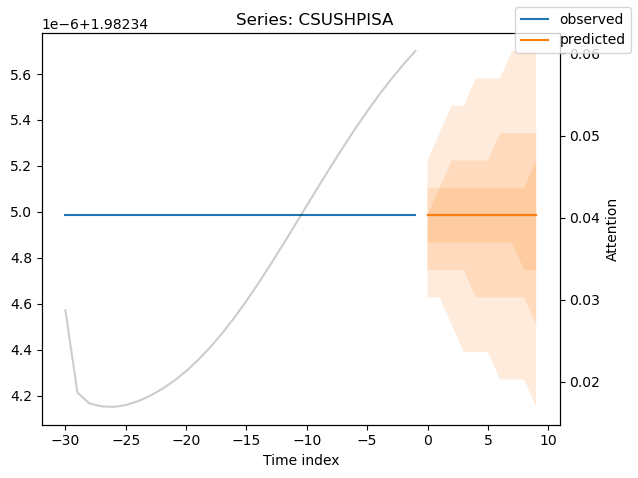

...

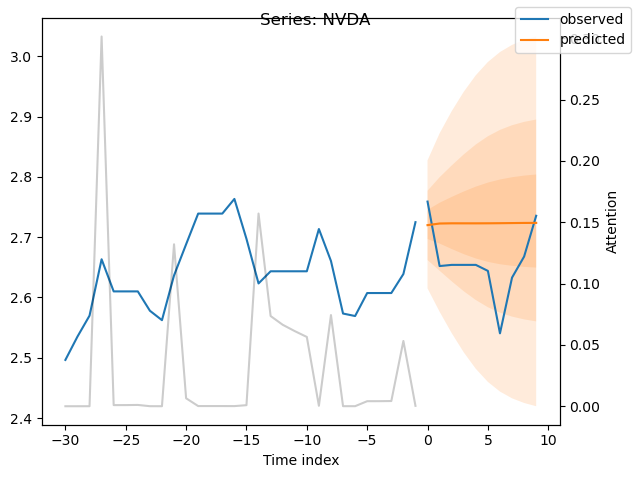

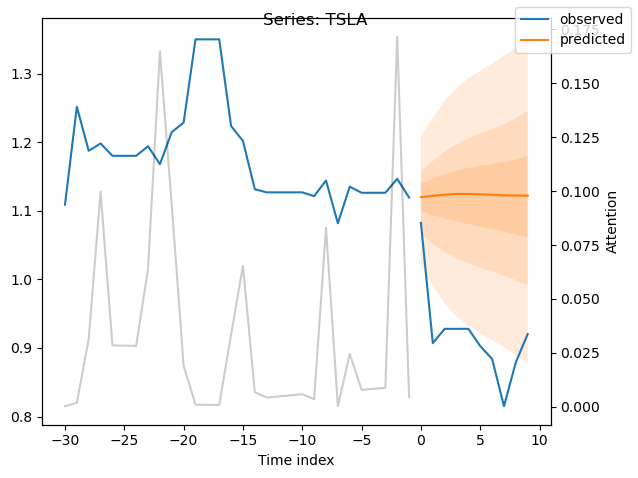

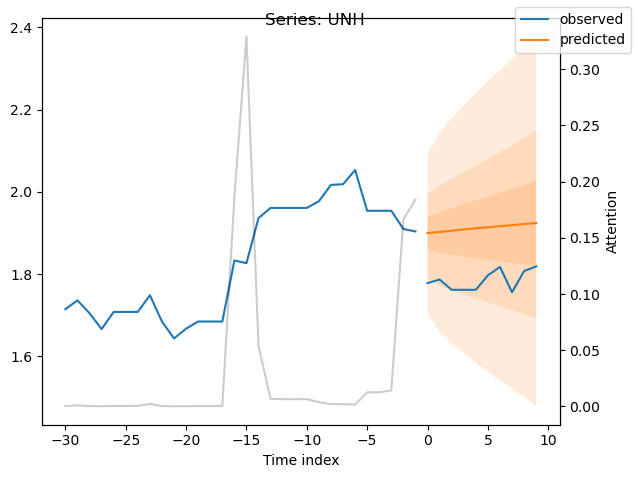

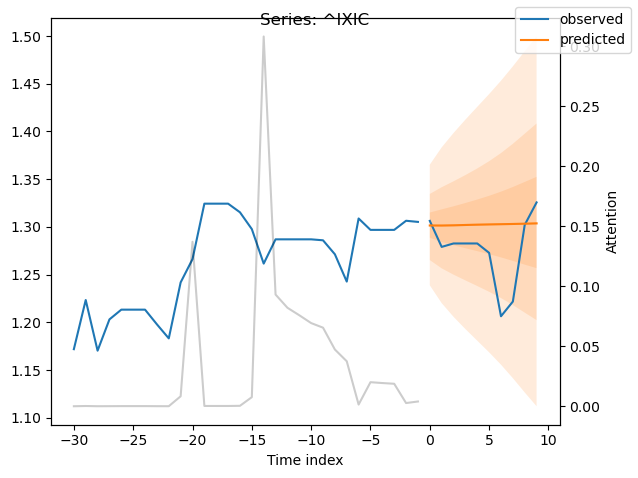

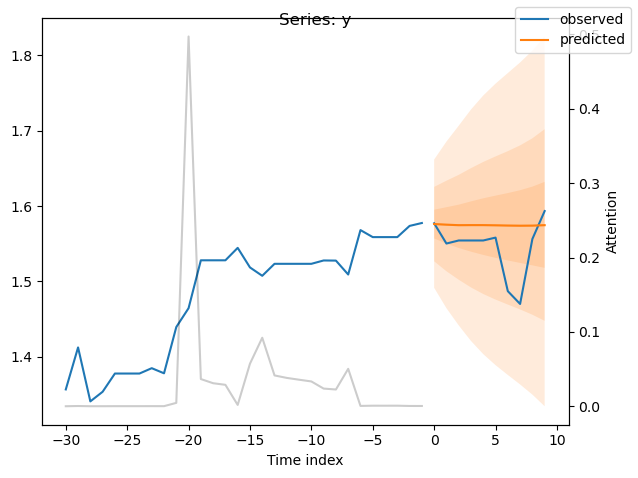

In [512]:
# raw predictions are a dictionary from which all kind of information including quantiles can be extracted
raw_predictions = best_tft.predict(val_dataloader, mode="raw", return_x=True)

series = validation.x_to_index(raw_predictions.x)["series"]

for idx in range(17):
    best_tft.plot_prediction(raw_predictions.x, raw_predictions.output, idx=idx, add_loss_to_title=False)
    plt.suptitle(f"Series: {series.iloc[idx]}")
    

## N-Beats

In [513]:
import os
import warnings

warnings.filterwarnings("ignore")

import lightning.pytorch as pl
from lightning.pytorch.callbacks import EarlyStopping
import pandas as pd
import torch

from pytorch_forecasting import Baseline, NBeats, TimeSeriesDataSet
from pytorch_forecasting.data import NaNLabelEncoder
from pytorch_forecasting.data.examples import generate_ar_data
from pytorch_forecasting.metrics import SMAPE

In [514]:
# create dataset and dataloaders
max_encoder_length = 30
max_prediction_length = 10

training_cutoff = train_series["time_idx"].max() - max_prediction_length

context_length = max_encoder_length
prediction_length = max_prediction_length

training = TimeSeriesDataSet(
    train_series[lambda x: x.time_idx <= training_cutoff],
    time_idx="time_idx",
    target="value",
    categorical_encoders={"series": NaNLabelEncoder().fit(train_series.series)},
    group_ids=["series"],
    # only unknown variable is "value" - and N-Beats can also not take any additional variables
    time_varying_unknown_reals=["value"],
    max_encoder_length=context_length,
    max_prediction_length=prediction_length,
)

validation = TimeSeriesDataSet.from_dataset(training, train_series, min_prediction_idx=training_cutoff + 1)
batch_size = 128
train_dataloader = training.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader = validation.to_dataloader(train=False, batch_size=batch_size, num_workers=0)

In [515]:
# calculate baseline absolute error
baseline_predictions = Baseline().predict(val_dataloader, return_y=True)
SMAPE()(baseline_predictions.output, baseline_predictions.y)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


tensor(0.0476, device='cuda:0')

In [516]:
trainer = pl.Trainer(accelerator="auto", gradient_clip_val=0.01)
net = NBeats.from_dataset(training, learning_rate=3e-2, weight_decay=1e-2, widths=[32, 512], backcast_loss_ratio=0.1)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]

Learning rate set to 0.004466835921509632


suggested learning rate: 0.004466835921509632


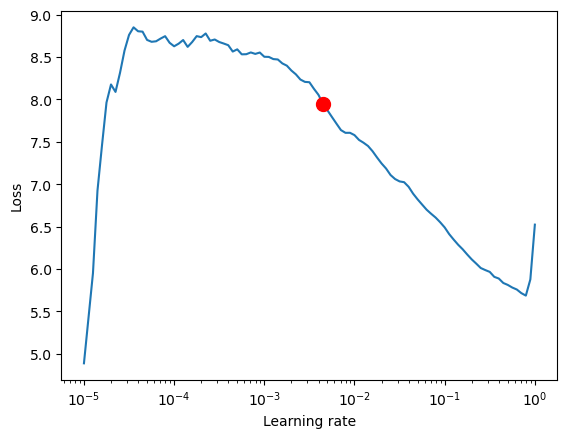

In [517]:
# find optimal learning rate
from lightning.pytorch.tuner import Tuner

res = Tuner(trainer).lr_find(net, train_dataloaders=train_dataloader, val_dataloaders=val_dataloader, min_lr=1e-5)
print(f"suggested learning rate: {res.suggestion()}")
fig = res.plot(show=True, suggest=True)
fig.show()
net.hparams.learning_rate = res.suggestion()

In [519]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1e-4, patience=10, verbose=False, mode="min")
trainer = pl.Trainer(
    max_epochs=20,
    accelerator="gpu",
    enable_model_summary=True,
    gradient_clip_val=0.01,
    callbacks=[early_stop_callback],
    limit_train_batches=150,
)


net = NBeats.from_dataset(
    training,
    learning_rate=1e-3,
    log_interval=10,
    log_val_interval=1,
    weight_decay=1e-2,
    widths=[32, 512],
    backcast_loss_ratio=1.0,
)

trainer.fit(
    net,
    train_dataloaders=train_dataloader,
    val_dataloaders=val_dataloader,
)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name            | Type       | Params
-----------------------------------------------
0 | loss            | MASE       | 0     
1 | logging_metrics | ModuleList | 0     
2 | net_blocks      | ModuleList | 1.6 M 
-----------------------------------------------
1.6 M     Trainable params
0         Non-trainable params
1.6 M     Total params
6.594     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [522]:

best_model_path = trainer.checkpoint_callback.best_model_path
best_model = NBeats.load_from_checkpoint(best_model_path)

predictions = best_model.predict(val_dataloader, trainer_kwargs=dict(accelerator="cpu"), return_y=True)
SMAPE()(predictions.output, predictions.y)

tensor(0.0453)

y :
MAPE: 0.7604519187171017
SMAPE: 0.7546968789667295
MAE: 31.1224853515625
MSE: 1928.935616093874
RMSE: 43.91964954429707


AAPL :
MAPE: 0.951922048180605
SMAPE: 0.9506263827350262
MAE: 1.5802688598632812
MSE: 2.883097120351158
RMSE: 1.6979685274913543


AMZN :
MAPE: 3.029246587496085
SMAPE: 3.0906822557684217
MAE: 3.237151336669922
MSE: 13.892506915208651
RMSE: 3.7272653400594717


GOOG :
MAPE: 0.8336028238614744
SMAPE: 0.8401576674472753
MAE: 0.8936302185058593
MSE: 1.6957750128756743
RMSE: 1.3022192645156476


GOOGL :
MAPE: 0.8417099710787163
SMAPE: 0.8465661981280548
MAE: 0.893585205078125
MSE: 1.4180480524199084
RMSE: 1.1908182281187623


META :
MAPE: 4.048258996901626
SMAPE: 4.074634663840436
MAE: 9.00768585205078
MSE: 112.37136584531981
RMSE: 10.600536111221913


MSFT :
MAPE: 2.450325007997697
SMAPE: 2.467177307233944
MAE: 7.186135864257812
MSE: 82.83675377080218
RMSE: 9.101469868697153


NVDA :
MAPE: 2.725954806845945
SMAPE: 2.681990565215132
MAE: 7.349850463867187
MSE: 65.24

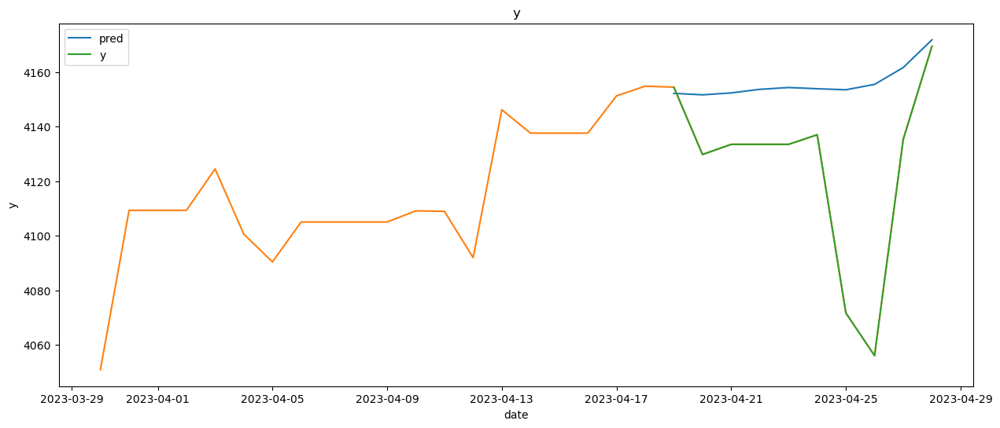

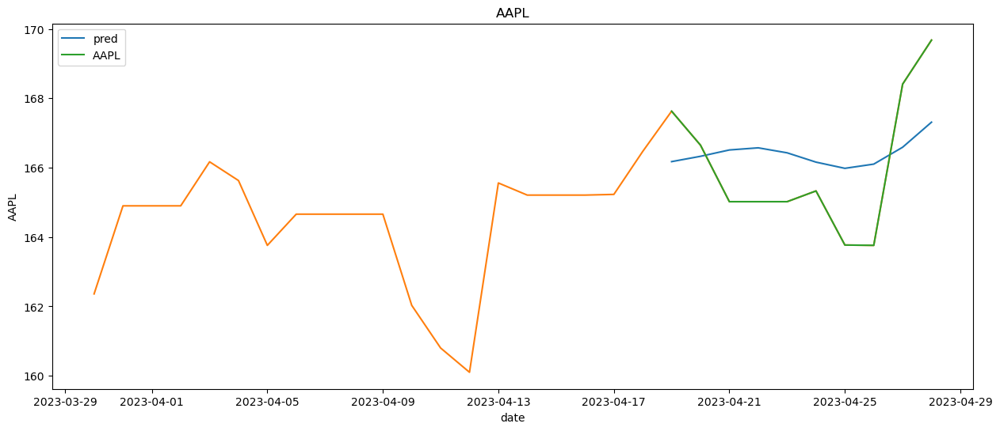

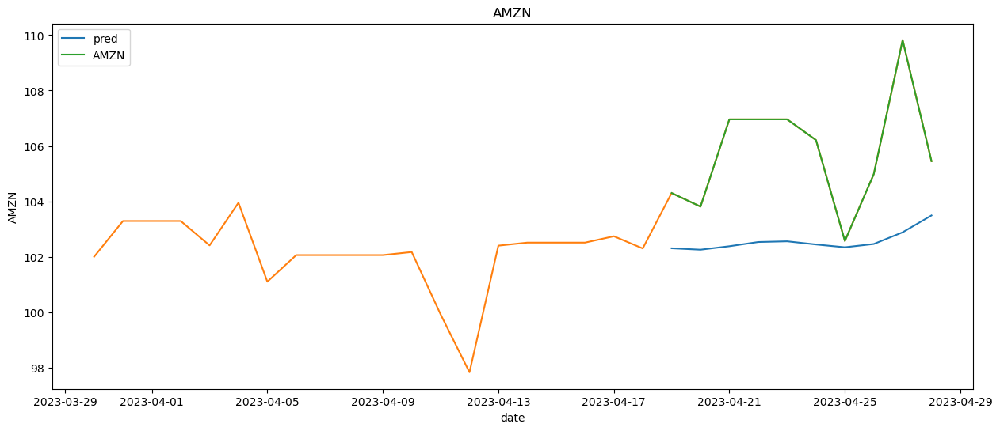

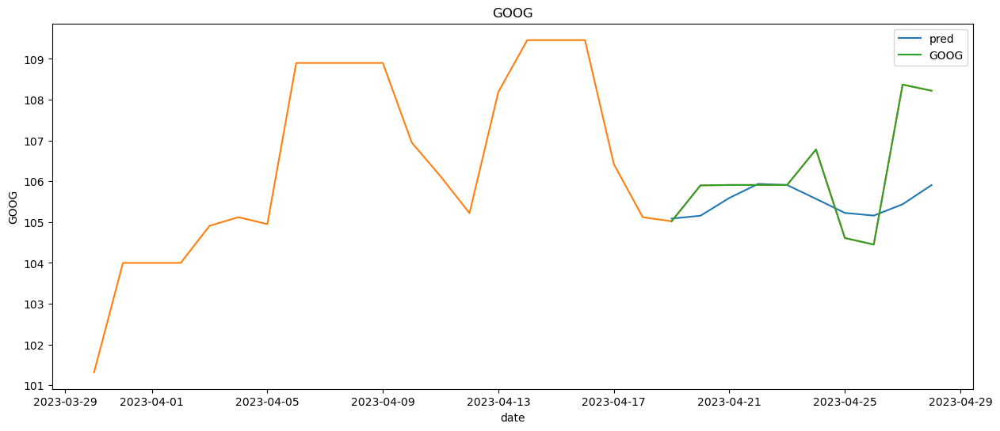

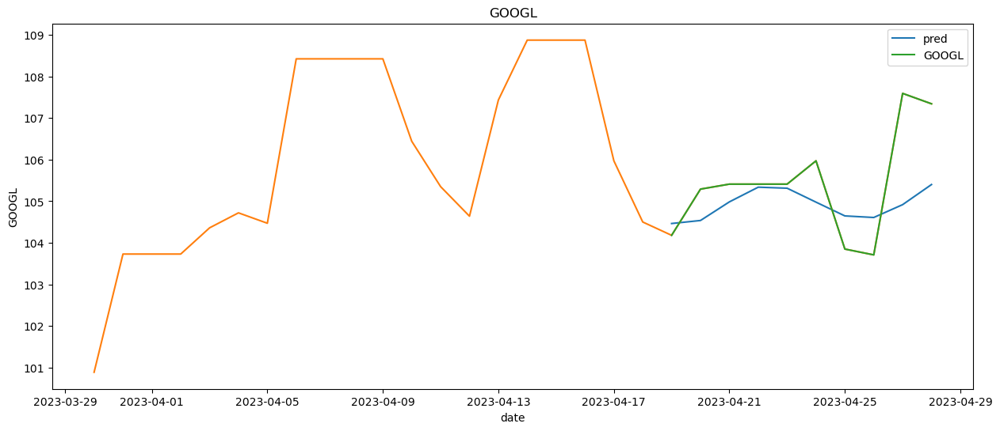

...

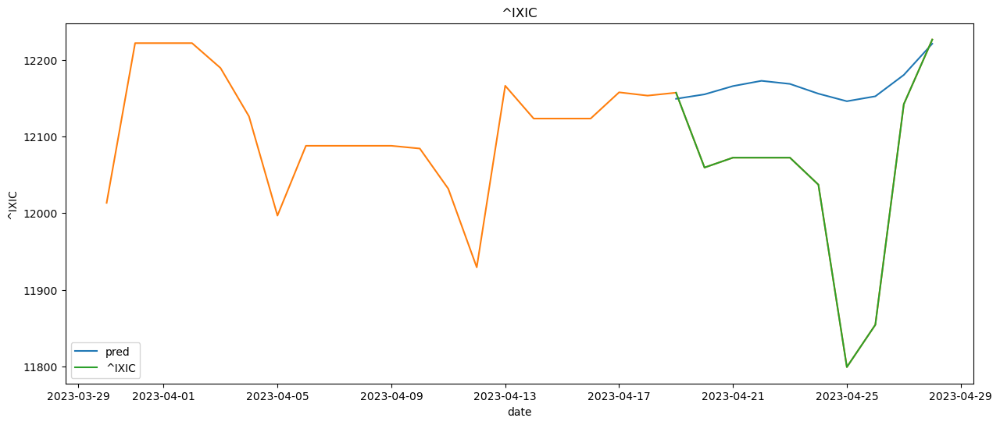

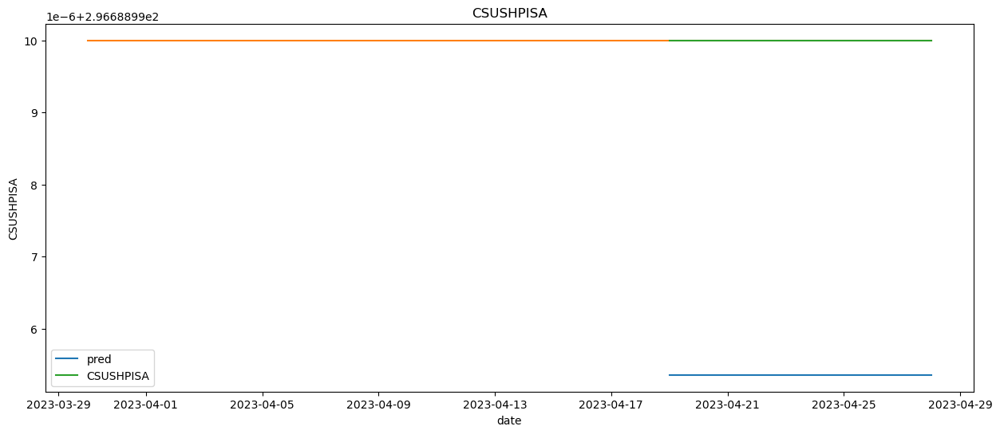

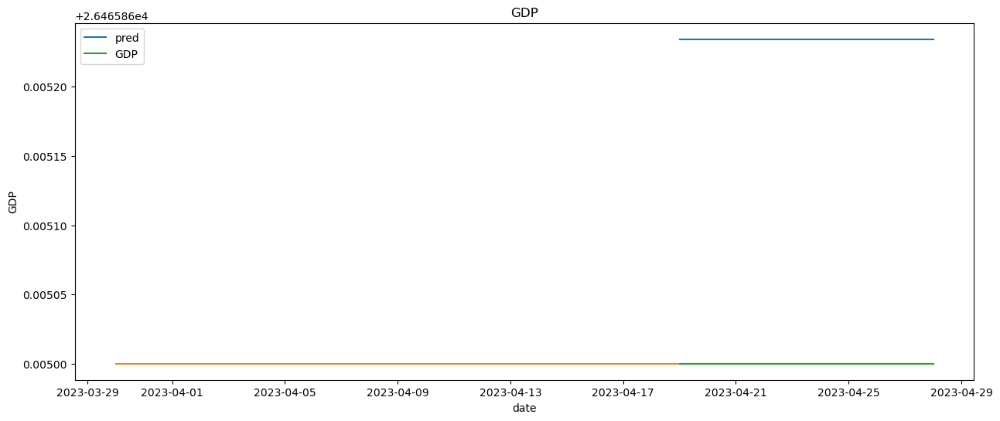

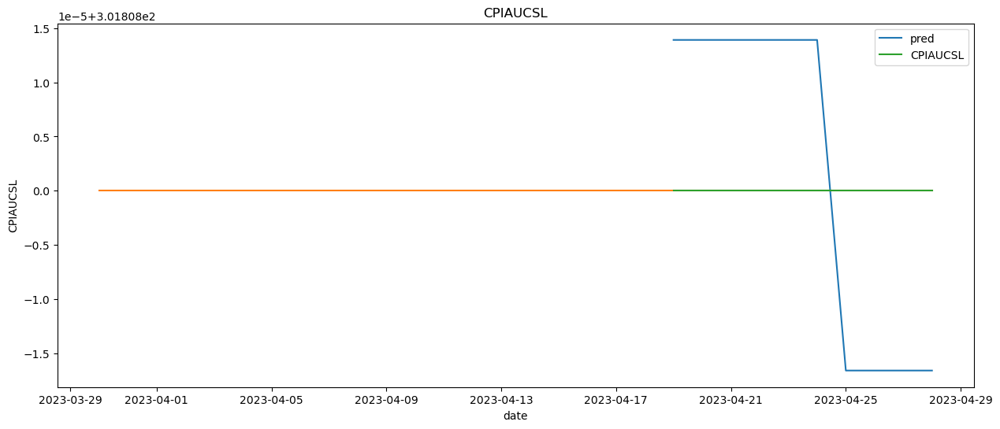

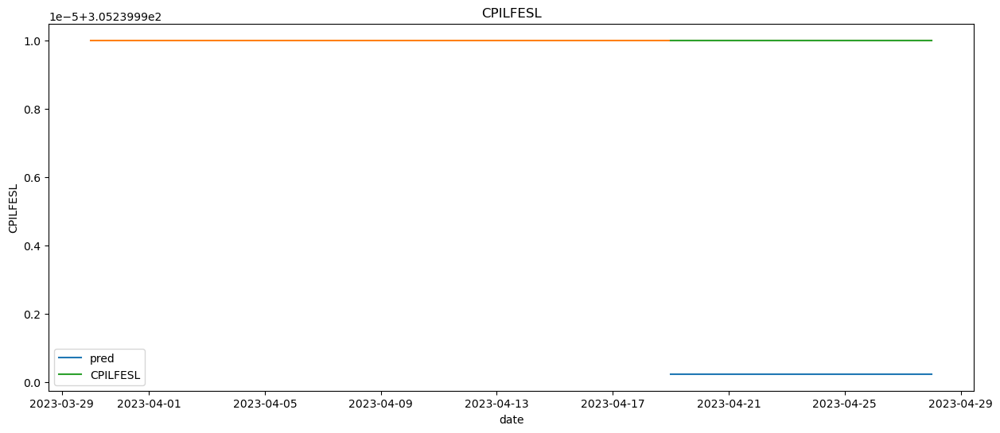

In [523]:
df_test = df_train_t[df_train_t['date'] > (df_train_t['date'].iloc[-1] - datetime.timedelta(days=10))]

prediction = best_model.predict(
    val_dataloader, mode="raw", return_index=True, trainer_kwargs=dict(accelerator="cpu")
)

df_test_pred = pd.DataFrame()
df_test_lower = pd.DataFrame()
df_test_upper = pd.DataFrame()

for index, row in prediction.index.iterrows():
    ts_predict = np.array(prediction.output.prediction[index, :])
    df_test_pred[str(row['series'])] = ts_predict
#     df_test_lower[str(row['series'])] = ts_predict.min(axis=1)
#     df_test_upper[str(row['series'])] = ts_predict.max(axis=1)
    
df_test_pred[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_pred[df_test.drop(columns=['date']).columns].values)
# df_test_lower[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_lower[df_test.drop(columns=['date']).columns].values)
# df_test_upper[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_upper[df_test.drop(columns=['date']).columns].values)
df_test_pred['date'] = df_test['date'].values
# df_test_lower['date'] = df_test['date'].values
# df_test_upper['date'] = df_test['date'].values



## metrics

for col in df_test.drop(columns=['date']).columns:
    print(col, ":")
    
    mae = mean_absolute_error(df_test[col], df_test_pred[col])
    mse = mean_squared_error(df_test[col], df_test_pred[col])
    rmse = mean_squared_error(df_test[col], df_test_pred[col], squared=False)

    mape = mape_metric(df_test[col].values, df_test_pred[col].values)
    smape = smape_metric(df_test[col].values, df_test_pred[col].values)

    print("MAPE:", mape)
    print("SMAPE:", smape)
    print(f"MAE: {mae}")
    print(f"MSE: {mse}")
    print(f"RMSE: {rmse}")
    print("\n")


# Total
print('Total')

y_true = df_test.drop(columns=['date']).values
y_pred = df_test_pred.drop(columns=['date']).values

mae = mean_absolute_error(y_true, y_pred)
mse = mean_squared_error(y_true, y_pred)
rmse = mean_squared_error(y_true, y_pred, squared=False)

mape = mape_metric(y_true, y_pred)
smape = smape_metric(y_true, y_pred)

print("MAPE:", mape)
print("SMAPE:", smape)
print(f"MAE: {mae}")
print(f"MSE: {mse}")
print(f"RMSE: {rmse}")
print("\n")



# plot
for col in df_test.drop(columns=['date']).columns:
    fig, ax = plt.subplots(1, 1, figsize=(15, 6))
    sns.lineplot(data=df_test_pred, x='date', y=col, ax=ax, label='pred')
    sns.lineplot(data=df_train_t.iloc[-30:], x='date', y=col, ax=ax)
    sns.lineplot(data=df_test,x='date', y=col, ax=ax, label=col)

#     ax.fill_between(df_test['date'], df_test_lower[col], df_test_upper[col], alpha=0.2)
    _ = ax.set_title(col)

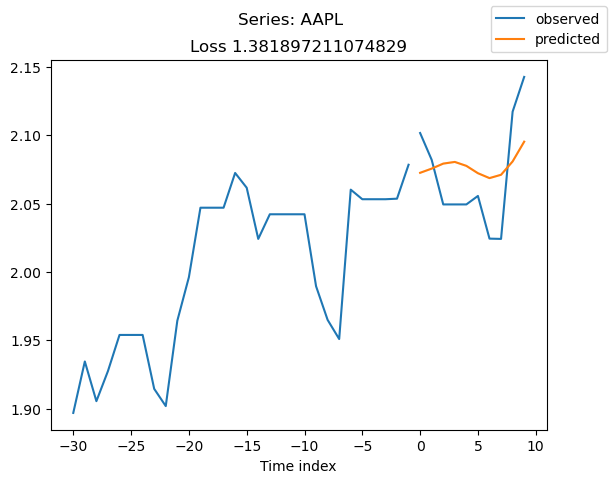

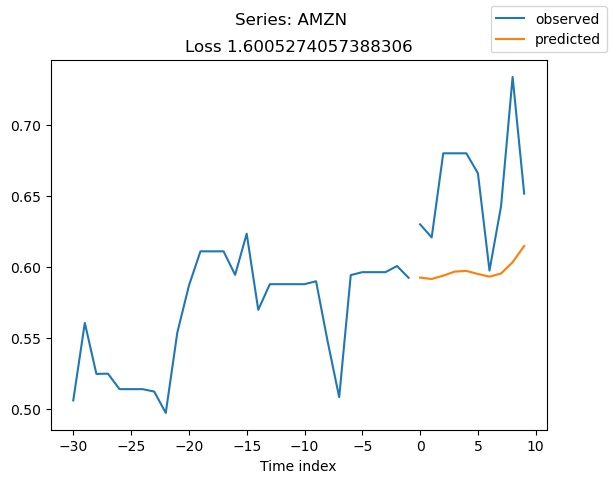

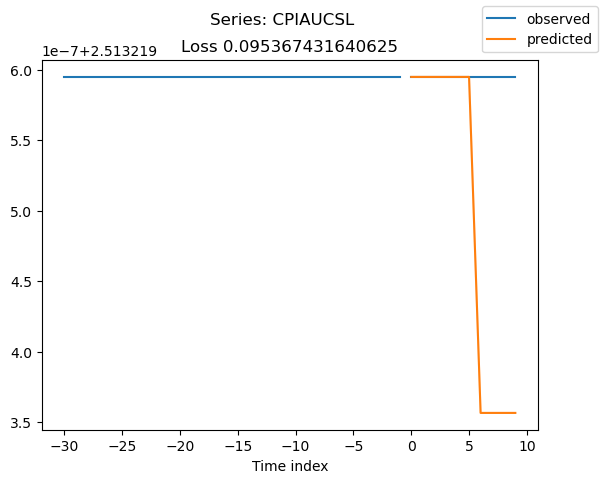

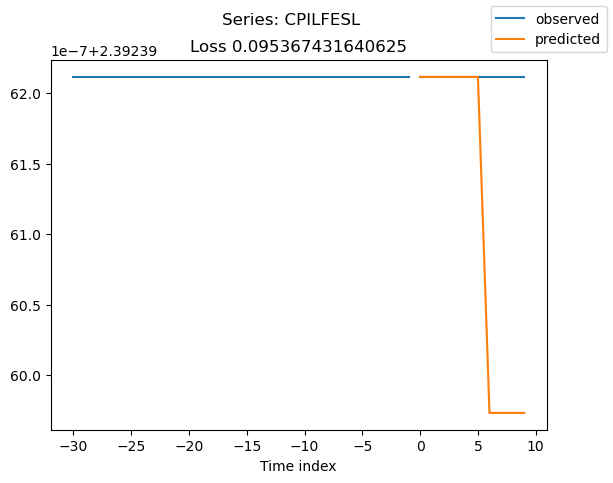

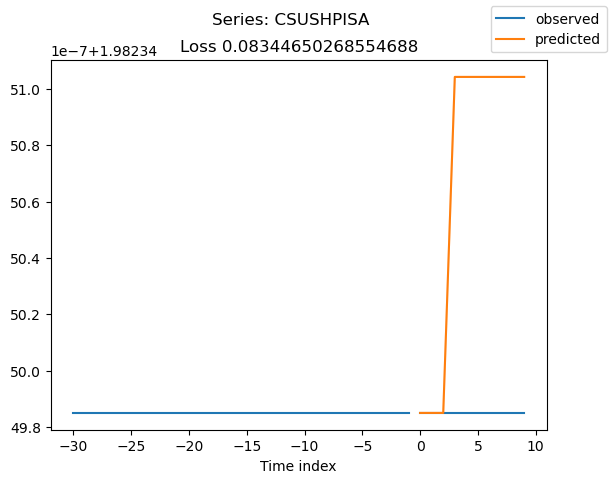

...

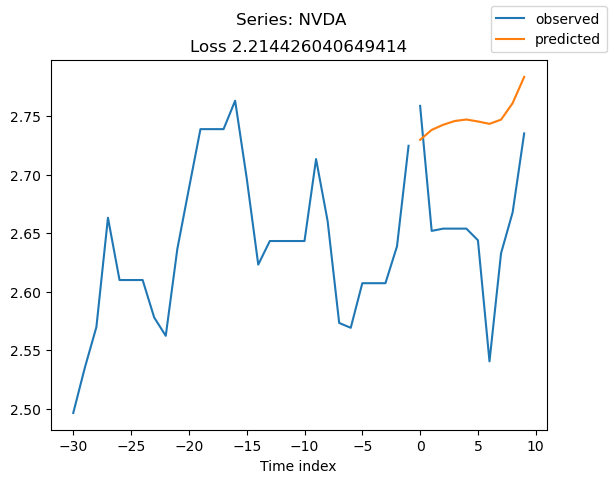

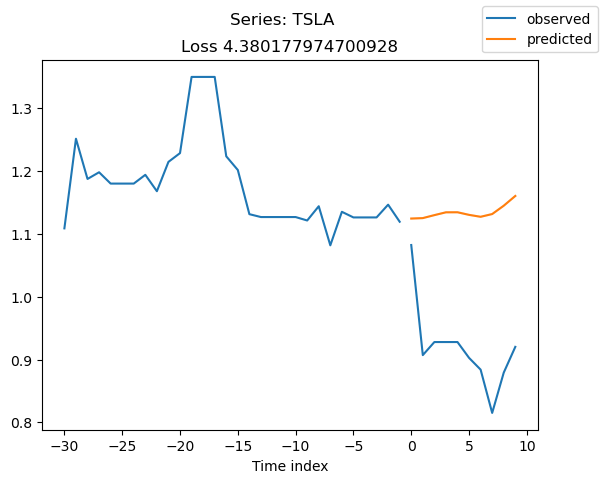

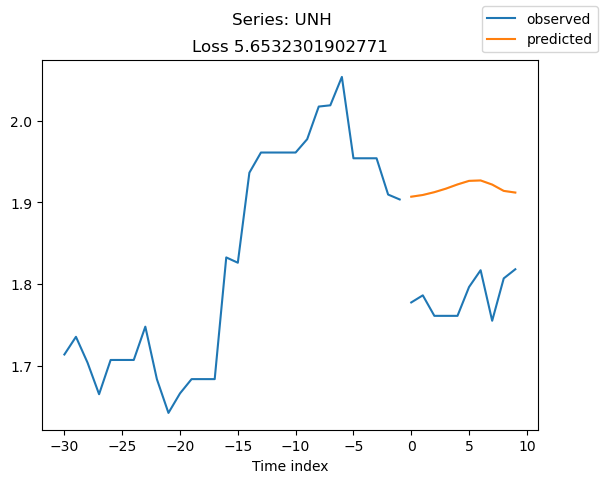

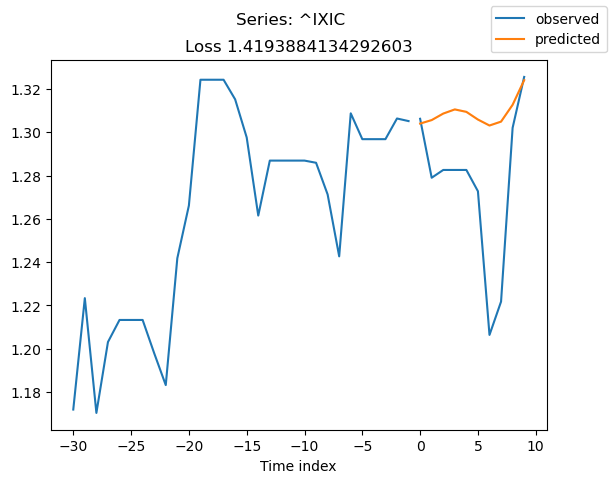

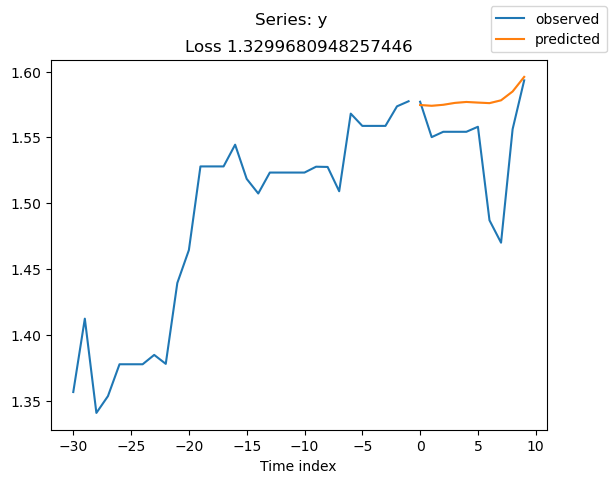

In [524]:

raw_predictions = best_model.predict(
    val_dataloader, mode="raw", return_x=True, trainer_kwargs=dict(accelerator="cpu")
)

series = validation.x_to_index(raw_predictions.x)["series"]
for idx in range(17):  # plot 10 examples
    best_model.plot_prediction(raw_predictions.x, raw_predictions.output, idx=idx, add_loss_to_title=True)
    plt.suptitle(f"Series: {series.iloc[idx]}")
    

In [459]:
# for idx in range(17):  # plot 10 examples
#     best_model.plot_interpretation(raw_predictions.x, raw_predictions.output, idx=idx)

### N-HiTS

In [525]:
import lightning.pytorch as pl
from lightning.pytorch.callbacks import EarlyStopping
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch

from pytorch_forecasting import Baseline, NHiTS, TimeSeriesDataSet
from pytorch_forecasting.data import NaNLabelEncoder
from pytorch_forecasting.data.examples import generate_ar_data
from pytorch_forecasting.metrics import MAE, SMAPE, MQF2DistributionLoss, QuantileLoss

In [526]:
# create dataset and dataloaders
max_encoder_length = 30
max_prediction_length = 10

training_cutoff = train_series["time_idx"].max() - max_prediction_length

context_length = max_encoder_length
prediction_length = max_prediction_length

training = TimeSeriesDataSet(
    train_series[lambda x: x.time_idx <= training_cutoff],
    time_idx="time_idx",
    target="value",
    categorical_encoders={"series": NaNLabelEncoder().fit(train_series.series)},
    group_ids=["series"],
    # only unknown variable is "value" - and N-HiTS can also not take any additional variables
    time_varying_unknown_reals=["value"],
    max_encoder_length=context_length,
    max_prediction_length=prediction_length,
)

validation = TimeSeriesDataSet.from_dataset(training, train_series, min_prediction_idx=training_cutoff + 1)
batch_size = 128
train_dataloader = training.to_dataloader(train=True, batch_size=batch_size, num_workers=0)
val_dataloader = validation.to_dataloader(train=False, batch_size=batch_size, num_workers=0)

In [528]:
# calculate baseline absolute error
baseline_predictions = Baseline().predict(val_dataloader, trainer_kwargs=dict(accelerator="cpu"), return_y=True)
SMAPE()(baseline_predictions.output, baseline_predictions.y)

tensor(0.0476)

In [529]:
pl.seed_everything(42)
trainer = pl.Trainer(accelerator="cpu", gradient_clip_val=0.1)
net = NHiTS.from_dataset(
    training,
    learning_rate=3e-2,
    weight_decay=1e-2,
    loss=MQF2DistributionLoss(prediction_length=max_prediction_length),
    backcast_loss_ratio=0.0,
    hidden_size=64,
    optimizer="AdamW",
)

Global seed set to 42


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]

Learning rate set to 0.0017378008287493763


suggested learning rate: 0.0017378008287493763


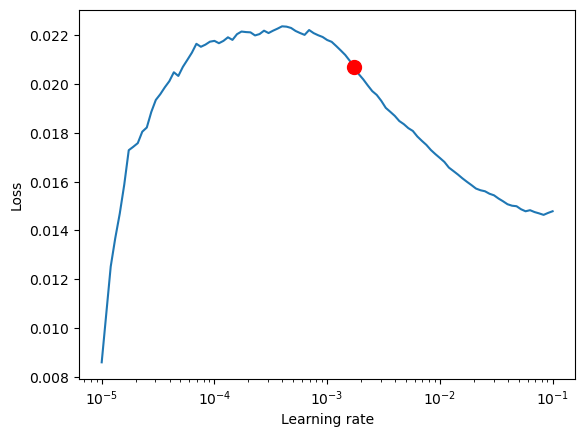

In [481]:
# find optimal learning rate
from lightning.pytorch.tuner import Tuner

res = Tuner(trainer).lr_find(
    net, train_dataloaders=train_dataloader, val_dataloaders=val_dataloader, min_lr=1e-5, max_lr=1e-1
)
print(f"suggested learning rate: {res.suggestion()}")
fig = res.plot(show=True, suggest=True)
fig.show()
net.hparams.learning_rate = res.suggestion()

In [534]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1e-4, patience=10, verbose=False, mode="min")
trainer = pl.Trainer(
    max_epochs=5,
    accelerator="gpu",
    enable_model_summary=True,
    gradient_clip_val=1.0,
    callbacks=[early_stop_callback],
    limit_train_batches=30,
    enable_checkpointing=True,
)


net = NHiTS.from_dataset(
    training,
    learning_rate=5e-3,
    log_interval=10,
    log_val_interval=1,
    weight_decay=1e-2,
    backcast_loss_ratio=0.0,
    hidden_size=64,
    optimizer="AdamW",
    loss=MQF2DistributionLoss(prediction_length=max_prediction_length),
)

trainer.fit(
    net,
    train_dataloaders=train_dataloader,
    val_dataloaders=val_dataloader,
)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name            | Type                 | Params
---------------------------------------------------------
0 | loss            | MQF2DistributionLoss | 3.5 K 
1 | logging_metrics | ModuleList           | 0     
2 | embeddings      | MultiEmbedding       | 0     
3 | model           | NHiTS                | 26.1 K
---------------------------------------------------------
29.6 K    Trainable params
0         Non-trainable params
29.6 K    Total params
0.118     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [542]:
best_model_path = trainer.checkpoint_callback.best_model_path
best_model = NHiTS.load_from_checkpoint(best_model_path)

predictions = best_model.predict(val_dataloader, trainer_kwargs=dict(accelerator="cpu"), return_y=True)
MAE()(predictions.output, predictions.y)

tensor(0.0617)

In [565]:
prediction.output.prediction[0,:]

tensor([ 0.6687,  2.2965,  1.5303,  0.7432,  0.8269,  2.7925,  1.9154,  1.2467,
        -0.0661,  3.0369,  1.5338,  1.6081,  0.4624,  2.7192,  1.6062,  1.5446,
         0.6050,  2.2525,  1.4691,  1.4987,  1.0043,  2.3516,  0.9775,  1.4218,
         0.5921,  2.6676,  0.9046,  0.9039,  0.3481,  2.8725,  0.6837,  1.4864,
         0.4537,  2.1580,  0.4722,  0.7086,  1.0353,  1.9117,  0.0570,  0.8395,
         2.0010,  0.0593])

In [561]:
prediction.

,time_idx,series
0,3988,AAPL
1,3988,AMZN
2,3988,CPIAUCSL
3,3988,CPILFESL
4,3988,CSUSHPISA
5,3988,EURUSD=X
6,3988,GC=F
7,3988,GDP
8,3988,GOOG
9,3988,GOOGL


In [559]:
# load the best model according to the validation loss
# (given that we use early stopping, this is not necessarily the last epoch)


df_test = df_train_t[df_train_t['date'] > (df_train_t['date'].iloc[-1] - datetime.timedelta(days=10))]

prediction = best_model.predict(
    val_dataloader, mode="raw", return_index=True, trainer_kwargs=dict(accelerator="cpu")
)

df_test_pred = pd.DataFrame()
df_test_lower = pd.DataFrame()
df_test_upper = pd.DataFrame()

for index, row in prediction.index.iterrows():
    ts_predict = np.array(prediction.output.prediction[index, :])
    df_test_pred[str(row['series'])] = ts_predict.mean(axis=1)
    df_test_lower[str(row['series'])] = ts_predict.min(axis=1)
    df_test_upper[str(row['series'])] = ts_predict.max(axis=1)
    
df_test_pred[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_pred[df_test.drop(columns=['date']).columns].values)
df_test_lower[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_lower[df_test.drop(columns=['date']).columns].values)
df_test_upper[df_test.drop(columns=['date']).columns] = ts_scaler.inverse_transform(df_test_upper[df_test.drop(columns=['date']).columns].values)
df_test_pred['date'] = df_test['date'].values
df_test_lower['date'] = df_test['date'].values
df_test_upper['date'] = df_test['date'].values



## metrics

for col in df_test.drop(columns=['date']).columns:
    print(col, ":")
    
    mae = mean_absolute_error(df_test[col], df_test_pred[col])
    mse = mean_squared_error(df_test[col], df_test_pred[col])
    rmse = mean_squared_error(df_test[col], df_test_pred[col], squared=False)

    mape = mape_metric(df_test[col].values, df_test_pred[col].values)
    smape = smape_metric(df_test[col].values, df_test_pred[col].values)

    print("MAPE:", mape)
    print("SMAPE:", smape)
    print(f"MAE: {mae}")
    print(f"MSE: {mse}")
    print(f"RMSE: {rmse}")
    print("\n")


# Total
print('Total')

y_true = df_test.drop(columns=['date']).values
y_pred = df_test_pred.drop(columns=['date']).values

mae = mean_absolute_error(y_true, y_pred)
mse = mean_squared_error(y_true, y_pred)
rmse = mean_squared_error(y_true, y_pred, squared=False)

mape = mape_metric(y_true, y_pred)
smape = smape_metric(y_true, y_pred)

print("MAPE:", mape)
print("SMAPE:", smape)
print(f"MAE: {mae}")
print(f"MSE: {mse}")
print(f"RMSE: {rmse}")
print("\n")



# plot
for col in df_test.drop(columns=['date']).columns:
    fig, ax = plt.subplots(1, 1, figsize=(15, 6))
    sns.lineplot(data=df_test_pred, x='date', y=col, ax=ax, label='pred')
    sns.lineplot(data=df_train_t.iloc[-30:], x='date', y=col, ax=ax)
    sns.lineplot(data=df_test,x='date', y=col, ax=ax, label=col)

    ax.fill_between(df_test['date'], df_test_lower[col], df_test_upper[col], alpha=0.2)
    _ = ax.set_title(col)

AxisError: axis 1 is out of bounds for array of dimension 1

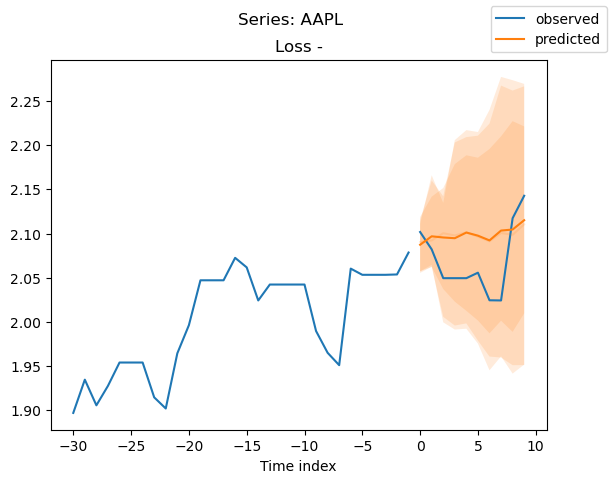

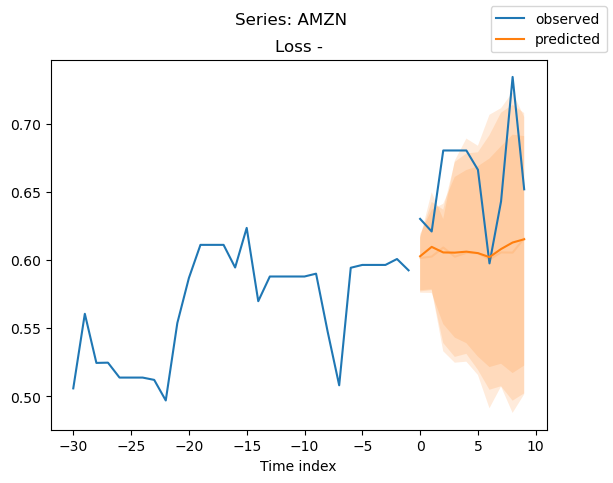

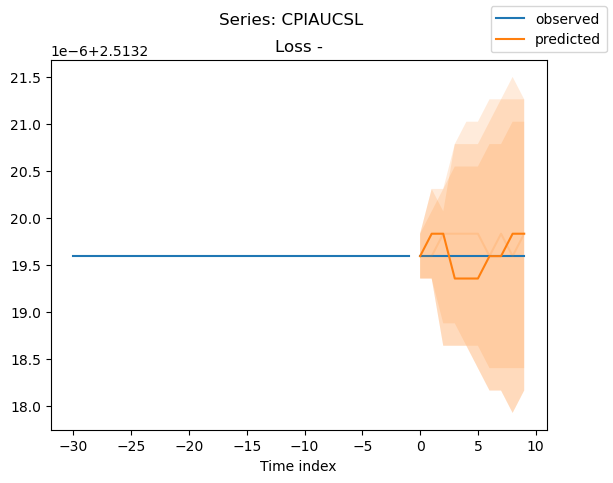

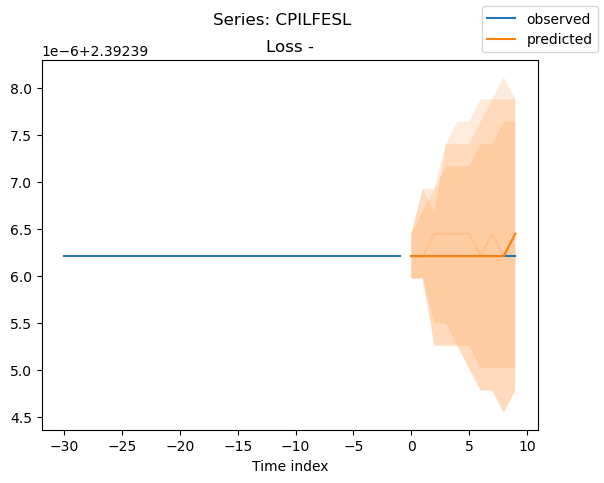

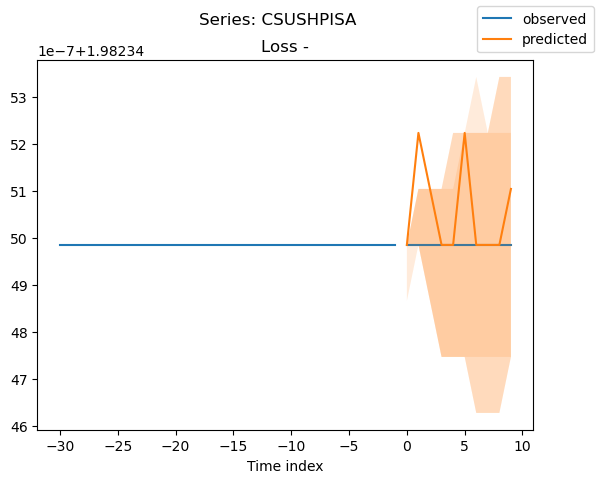

...

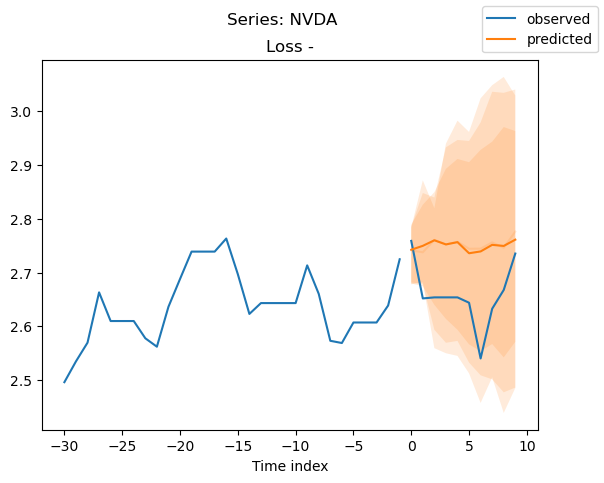

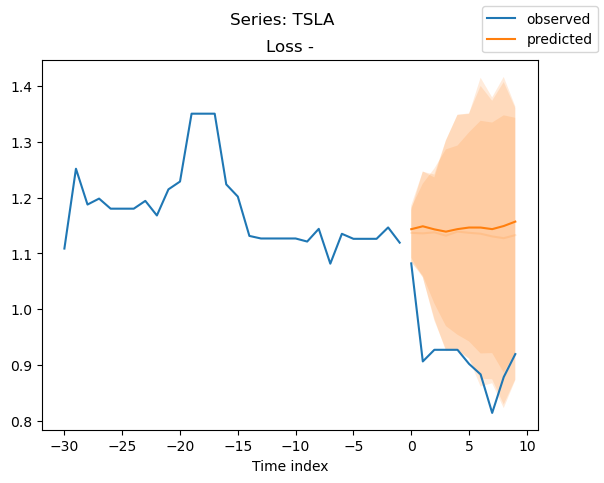

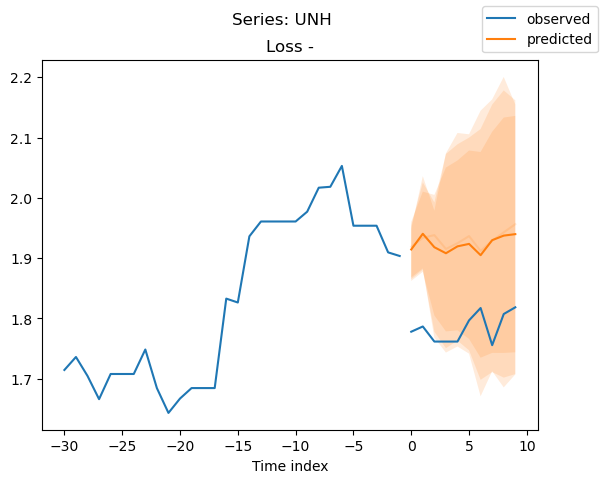

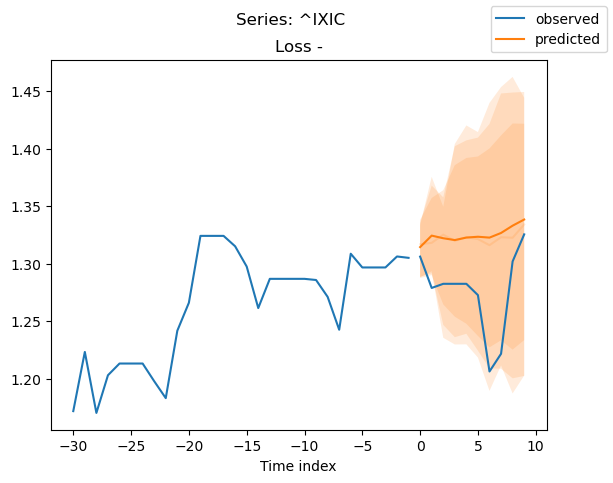

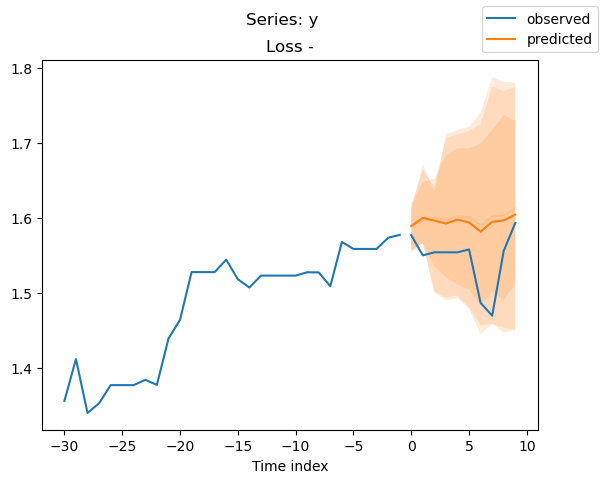

In [549]:

raw_predictions = best_model.predict(val_dataloader, mode="raw", return_x=True, trainer_kwargs=dict(accelerator="cpu"))

series = validation.x_to_index(raw_predictions.x)["series"]

for idx in range(17):  # plot 10 examples
    best_model.plot_prediction(raw_predictions.x, raw_predictions.output, idx=idx, add_loss_to_title=True)
    plt.suptitle(f"Series: {series.iloc[idx]}")

In [487]:
# for idx in range(2):  # plot 10 examples
#     best_model.plot_interpretation(raw_predictions.x, raw_predictions.output, idx=idx)

In [488]:
# sample 500 paths
# samples = best_model.loss.sample(raw_predictions.output["prediction"][[0]], n_samples=500)[0]

# # plot prediction
# fig = best_model.plot_prediction(raw_predictions.x, raw_predictions.output, idx=0, add_loss_to_title=True)
# ax = fig.get_axes()[0]
# # plot first two sampled paths
# ax.plot(samples[:, 0], color="g", label="Sample 1")
# ax.plot(samples[:, 1], color="r", label="Sample 2")
# fig.legend()

In [489]:
# print(f"Var(all samples) = {samples.var():.4f}")
# print(f"Mean(Var(sample)) = {samples.var(0).mean():.4f}")

In [490]:
# plt.hist(samples.sum(0).numpy(), bins=30)
# plt.xlabel("Sum of predictions")
# plt.ylabel("Frequency")

 ## GluonTS
 
 

In [164]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

from gluonts.dataset.common import ListDataset
from gluonts.dataset.util import to_pandas

ts_scaler = StandardScaler()

time_series_labels = ["^GSPC",'AAPL', 'AMZN',  'GOOG',
       'GOOGL', 'META', 'MSFT', 'NVDA', 'TSLA', 'UNH','GC=F', 'EURUSD=X','^IXIC', 'CSUSHPISA', 'GDP', 'CPIAUCSL', 'CPILFESL']

prediction_length = 10

df_train = data_df[time_series_labels].reset_index().rename(columns={'Date': 'date'}).copy()

# scaler
ts_scaler.fit(df_train[time_series_labels])
df_train_s = df_train.copy()
df_train_s[time_series_labels] = ts_scaler.transform(df_train[time_series_labels])

df_test_s = df_train_s.copy()
df_train_s = df_train_s.iloc[:-prediction_length,:]


df_train_s = df_train_s.melt(id_vars=['date'], var_name='series', value_name='value')
df_test_s = df_test_s.melt(id_vars=['date'], var_name='series', value_name='value')

n_series =  len(df_train_s['series'].unique())
freq = 'D'

print(df_train_s.shape)
display(df_train_s.head())

print(df_test_s.shape)
display(df_test_s.head())

(68034, 3)


,date,series,value
0,2012-05-18,^GSPC,-1.531714
1,2012-05-19,^GSPC,-1.531714
2,2012-05-20,^GSPC,-1.531714
3,2012-05-21,^GSPC,-1.509199
4,2012-05-22,^GSPC,-1.508505


(68204, 3)


,date,series,value
0,2012-05-18,^GSPC,-1.531714
1,2012-05-19,^GSPC,-1.531714
2,2012-05-20,^GSPC,-1.531714
3,2012-05-21,^GSPC,-1.509199
4,2012-05-22,^GSPC,-1.508505


In [166]:
from gluonts.dataset.pandas import PandasDataset
from gluonts.dataset.multivariate_grouper import MultivariateGrouper


train_ds = PandasDataset.from_long_dataframe(df_train_s, timestamp='date', target="value", item_id="series")
test_ds = PandasDataset.from_long_dataframe(df_test_s, timestamp='date', target="value", item_id="series")

grouper_train = MultivariateGrouper(max_target_dim=n_series)
train_ds = grouper_train(train_ds)

grouper_test = MultivariateGrouper(max_target_dim=n_series)
test_ds = grouper_test(test_ds)


In [ ]:
net = DeepAR.from_dataset(
    training,
    learning_rate=0.006431956578942552,
    log_interval=10,
    log_val_interval=1,
    hidden_size=38,
    rnn_layers=1,
    optimizer="Adam",
    loss=MultivariateNormalDistributionLoss(rank=14),
)

In [173]:
from gluonts.mx import DeepVAREstimator
from gluonts.mx.trainer import Trainer
from gluonts.dataset.repository.datasets import get_dataset
from gluonts.dataset.util import to_pandas
import mxnet as mx

# Define the DeepVAR estimator
estimator = DeepVAREstimator(
    freq=freq,
    prediction_length=prediction_length,
    context_length=30,     # Length of the training context
    target_dim=n_series,
    num_layers=1,          # Number of layers in the RNN
    num_cells=40,          # Number of cells in each layer of the RNN
    cell_type="lstm",      # Type of RNN cell (e.g., 'lstm' or 'gru')
    scaling=False,
    batch_size=128,
    trainer=Trainer(ctx=mx.gpu(0),
        clip_gradient=0.1,
        epochs=10,          # Number of training epochs
        learning_rate=0.01, # Learning rate for optimization
    ),
)


predictor = estimator.train(train_ds)


  0%|                                                                        | 0/50 [00:00<?, ?it/s][11:17:35] ../src/imperative/./cached_op.h:254: Disabling fusion due to altered topological order of inputs.

100%|██████████████████████████████| 50/50 [00:15<00:00,  3.28it/s, epoch=1/10, avg_epoch_loss=1.17]

100%|█████████████████████████████| 50/50 [00:14<00:00,  3.34it/s, epoch=2/10, avg_epoch_loss=-10.6]

100%|█████████████████████████████| 50/50 [00:15<00:00,  3.29it/s, epoch=3/10, avg_epoch_loss=-13.6]

100%|█████████████████████████████| 50/50 [00:14<00:00,  3.40it/s, epoch=4/10, avg_epoch_loss=-15.4]

100%|███████████████████████████████| 50/50 [00:14<00:00,  3.41it/s, epoch=5/10, avg_epoch_loss=-17]

100%|█████████████████████████████| 50/50 [00:14<00:00,  3.36it/s, epoch=6/10, avg_epoch_loss=-16.9]

100%|███████████████████████████████| 50/50 [00:15<00:00,  3.28it/s, epoch=7/10, avg_epoch_loss=-18]

100%|█████████████████████████████| 50/50 [00:15<00:00,  3.31it/s, epoch=8/


Running evaluation: 1it [00:00, 321.82it/s]

Running evaluation: 1it [00:00, 382.52it/s]

Running evaluation: 1it [00:00, 399.57it/s]

Running evaluation: 1it [00:00, 413.35it/s]

Running evaluation: 1it [00:00, 402.72it/s]

Running evaluation: 1it [00:00, 422.73it/s]

Running evaluation: 1it [00:00, 424.40it/s]

Running evaluation: 1it [00:00, 425.60it/s]

Running evaluation: 1it [00:00, 425.99it/s]

Running evaluation: 1it [00:00, 420.31it/s]

Running evaluation: 1it [00:00, 414.17it/s]

Running evaluation: 1it [00:00, 417.22it/s]

Running evaluation: 1it [00:00, 419.14it/s]

Running evaluation: 1it [00:00, 430.05it/s]

Running evaluation: 1it [00:00, 426.55it/s]

Running evaluation: 1it [00:00, 411.33it/s]

Running evaluation: 1it [00:00, 420.99it/s]


{
    "0_MSE": 0.6605602264404297,
    "0_abs_error": 7.988132476806641,
    "0_abs_target_sum": 21.681884765625,
    "0_abs_target_mean": 2.1681884765625,
    "0_seasonal_error": 0.011961358453416431,
    "0_MASE": 66.78281992732232,
    "0_MAPE": 0.3677431344985962,
    "0_sMAPE": 0.4532631874084473,
    "0_MSIS": 213.43664755786702,
    "0_QuantileLoss[0.1]": 3.2391049385070803,
    "0_Coverage[0.1]": 0.0,
    "0_QuantileLoss[0.5]": 7.988132119178772,
    "0_Coverage[0.5]": 0.0,
    "0_QuantileLoss[0.9]": 1.3609715461730958,
    "0_Coverage[0.9]": 0.6,
    "0_RMSE": 0.812748562865804,
    "0_NRMSE": 0.3748514354962147,
    "0_ND": 0.36842426584017385,
    "0_wQuantileLoss[0.1]": 0.14939222182577216,
    "0_wQuantileLoss[0.5]": 0.3684242493458574,
    "0_wQuantileLoss[0.9]": 0.06276998337021023,
    "0_mean_absolute_QuantileLoss": 4.196069534619649,
    "0_mean_wQuantileLoss": 0.19352881818061327,
    "0_MAE_Coverage": 0.3,
    "0_OWA": NaN,
    "1_MSE": 0.08972572684288024,
    "1_a

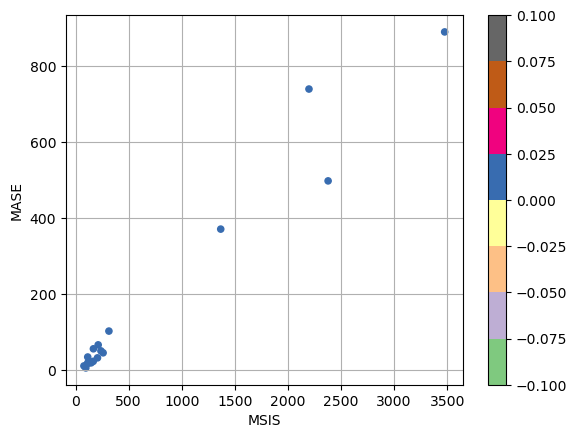

In [208]:
from gluonts.evaluation import Evaluator
from gluonts.evaluation.backtest import make_evaluation_predictions
import json
from gluonts.evaluation import MultivariateEvaluator


# Make predictions
forecast_it, ts_it = make_evaluation_predictions(
    dataset=test_ds,
    predictor=predictor,
    num_samples=100
)

evaluator = MultivariateEvaluator(quantiles=[0.1, 0.5, 0.9])
agg_metrics, item_metrics = evaluator(ts_it, forecast_it, num_series=len(test_ds))

print(json.dumps(agg_metrics, indent=4))
print(item_metrics)

item_metrics.plot(x='MSIS', y='MASE', kind='scatter', c=item_metrics.index, cmap='Accent')
plt.grid(which="both")
plt.show()

NameError: name 'tests' is not defined

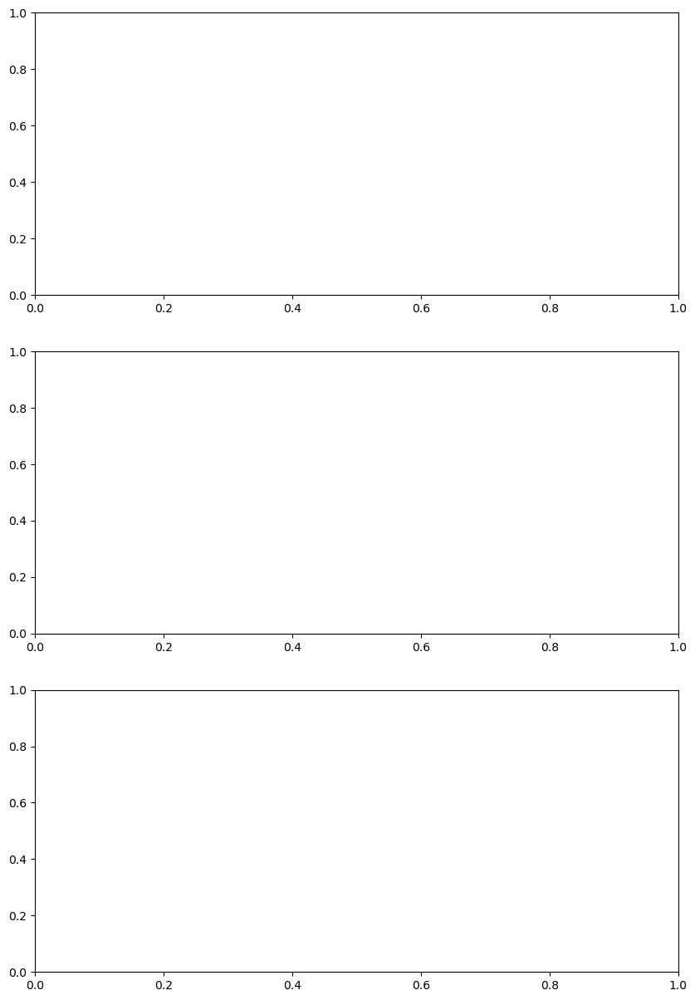

In [209]:
n_plot = 3
indices = np.random.choice(np.arange(0, N), size=n_plot, replace=False)
fig, axes = plt.subplots(n_plot, 1, figsize=(10, n_plot * 5))
for index, ax in zip(indices, axes):
    tests[index][-4 * prediction_length :].plot(ax=ax)
    plt.sca(ax)
    forecasts[index].plot(prediction_intervals=[90.0], color="g")
    plt.legend(["observed", "predicted median", "predicted 90% quantile"])

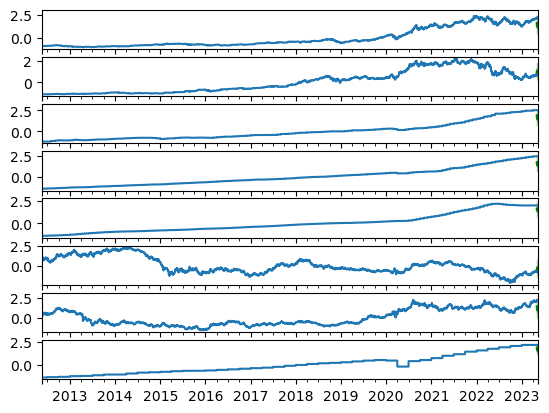

In [217]:
from gluonts.evaluation.backtest import make_evaluation_predictions

forecast_it, ts_it = make_evaluation_predictions(
    dataset=test_ds,
    predictor=predictor,
    num_samples=100
)


for x, y  in zip(ts_it, forecast_it):
    for i in range(8):
        plt.subplot(8,1,i+1)
        x[i].plot()
        y.copy_dim(i).plot(color='g', prediction_intervals=(50.0, 90.0))

plt.show()